## Setup, Loading Data and CDFs

In [4]:
DATA_NAME = 'pastis-full' 
TRANSFORM = 'gabor'
CHANNEL = 'gray'
PARAM_CSV = "gabor_new.csv"

In [5]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
gray_gabor_full_pastis.ipynb


In [6]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/michaelmurphy/Documents/GitHub/hierarchical-bayesian-model-validation/results/case-studies/pastis/full/gabor/gray'

In [7]:
print(os.getcwd())
print(CWD)

/Users/michaelmurphy/Documents/GitHub/hierarchical-bayesian-model-validation/results/case-studies/pastis/full/gabor/gray
/Users/michaelmurphy/Documents/GitHub/hierarchical-bayesian-model-validation/results/case-studies/pastis/full/gabor/gray


In [8]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [9]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [10]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 16384000,
 1: 16384000,
 2: 16384000,
 3: 16384000,
 4: 16384000,
 5: 16384000,
 6: 16384000,
 7: 16384000,
 8: 16384000,
 9: 16384000,
 10: 16384000,
 11: 16384000,
 12: 16384000,
 13: 16384000,
 14: 16384000,
 15: 16384000,
 16: 16384000,
 17: 16384000,
 18: 16384000,
 19: 16384000,
 20: 16384000,
 21: 16384000,
 22: 16384000,
 23: 16384000,
 24: 16384000,
 25: 16384000,
 26: 16384000,
 27: 16384000,
 28: 16384000,
 29: 16384000,
 30: 16384000,
 31: 16384000,
 32: 16384000,
 33: 16384000,
 34: 16384000,
 35: 16384000,
 36: 16384000,
 37: 16384000,
 38: 16384000,
 39: 16384000,
 40: 16384000,
 41: 16384000}

Running 12760 CDFs


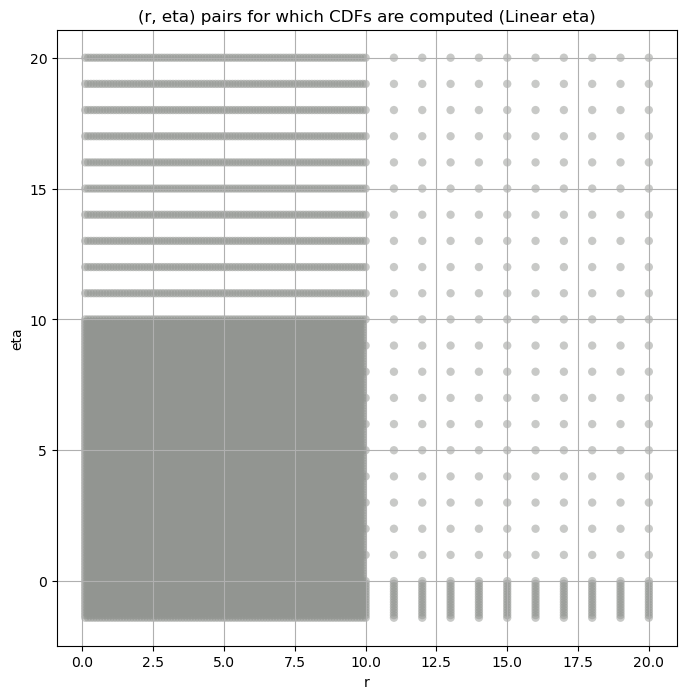

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [11]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [12]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [13]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,47.675446,38.538307,58.149254,4.035529,1.708707,11.881980,16384000.0,"(2.0, 0.5, 0.044)"
1,19.243467,15.368475,24.224464,4.591545,1.823889,14.051207,16384000.0,"(2.0, 0.5, 0.065)"
2,7.278729,5.873062,9.066898,5.347929,2.069188,19.490412,16384000.0,"(2.0, 0.5, 0.096)"
3,2.810154,2.207047,3.760558,6.991034,2.539103,32.836670,16384000.0,"(2.0, 0.5, 0.141)"
4,0.983050,0.753830,1.322739,9.225349,3.406891,56.309600,16384000.0,"(2.0, 0.5, 0.208)"
5,0.280907,0.209500,0.384200,13.071856,3.556167,79.350945,16384000.0,"(2.0, 0.5, 0.306)"
6,0.153547,0.113396,0.241269,16.764734,3.949549,131.470110,16384000.0,"(2.0, 0.5, 0.45)"
7,63.055270,52.467660,76.867676,3.971615,1.687826,11.152740,16384000.0,"(2.0, 1.0, 0.044)"
8,26.441060,21.522533,33.041473,4.424464,1.901211,13.735676,16384000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [14]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [15]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,47.675446,47.675446,45.873783,44.759796,43.033253
1,19.243467,19.243467,18.467131,17.990620,17.258463
2,7.278729,7.278729,6.958169,6.767331,6.475588
3,2.810154,2.810153,2.666100,2.585041,2.463348
4,0.983050,0.983050,0.923691,0.892156,0.845824
5,0.280907,0.280907,0.260020,0.249692,0.234920
6,0.153547,0.153547,0.140861,0.135066,0.126936
7,63.055270,63.055271,60.684605,59.210728,56.918011
8,26.441060,26.441059,25.418959,24.778076,23.777040


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.0008700491091690465 47.675446


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.0015429908808294295 45.873783


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.0023572009923053527 44.759796


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.0036232236122978913 43.033253
Number of samples: 100000, Without approximation : 16384000.0


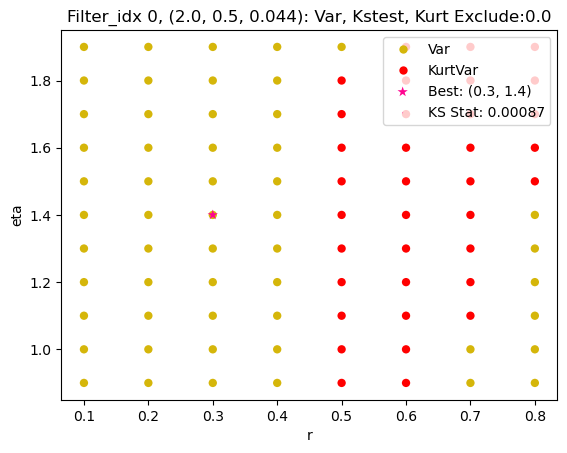

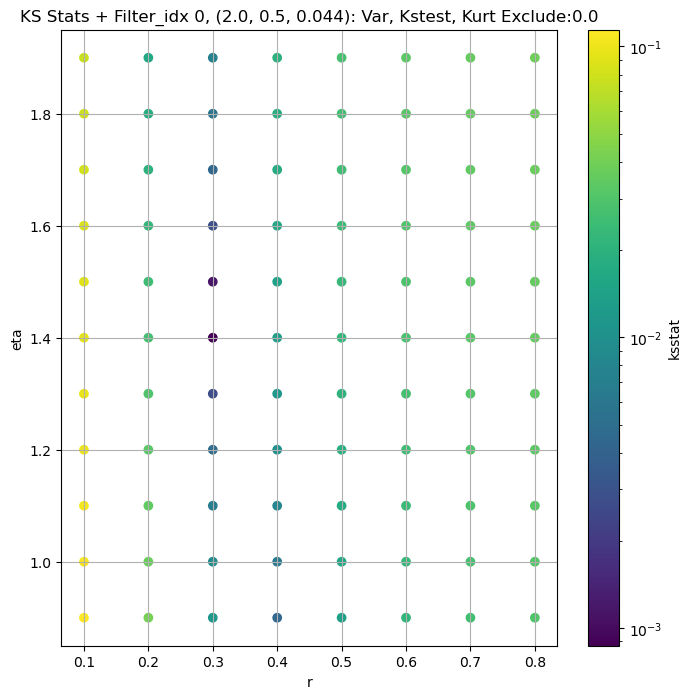

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.0010116333665693977 19.243467


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.001513772332613933 18.46713


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.0023473053638581876 17.99062


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.00363287576246913 17.258463
Number of samples: 100000, Without approximation : 16384000.0


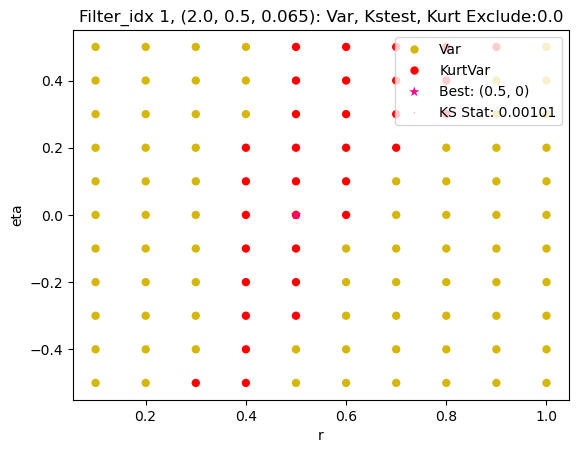

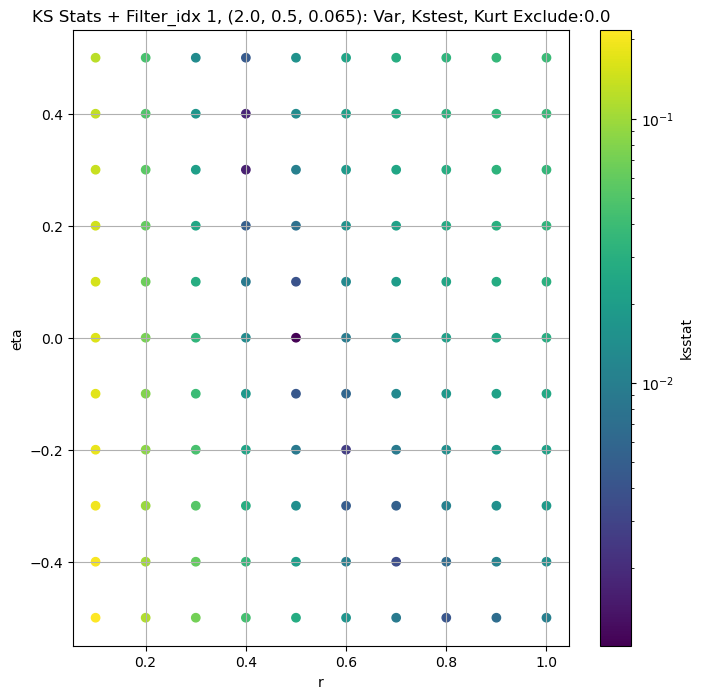

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.0011318020645267879 7.278729


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.0023257550278543704 6.958169


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.0021342404602453513 6.767331


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.00359848595132517 6.475588
Number of samples: 100000, Without approximation : 16384000.0


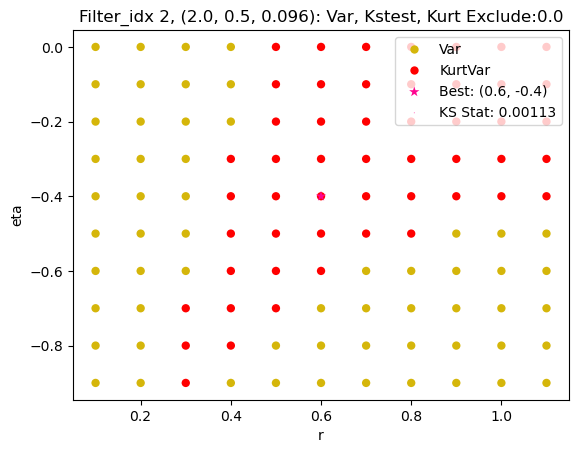

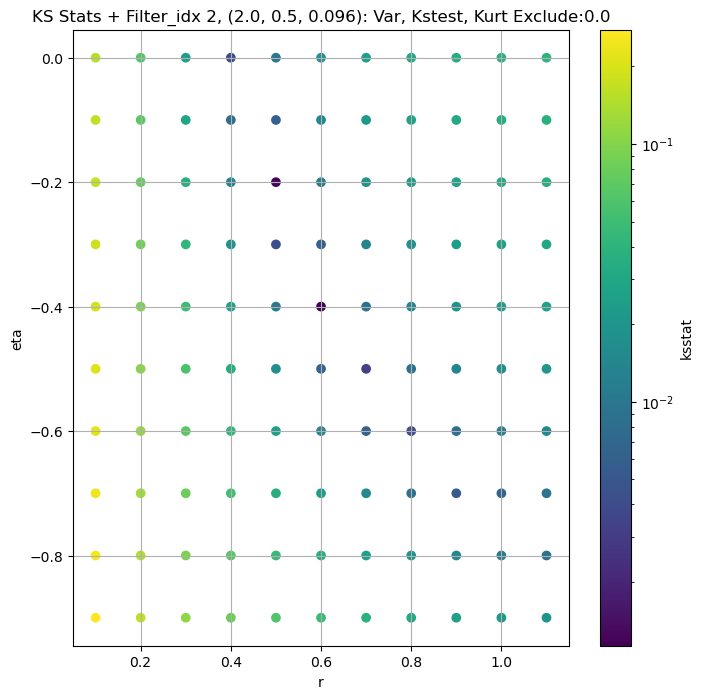

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.0020123718173457456 2.8101535


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.003290431107579317 2.6661003


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.002961682768260143 2.5850413


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.0040459098607328325 2.4633477
Number of samples: 100000, Without approximation : 16384000.0


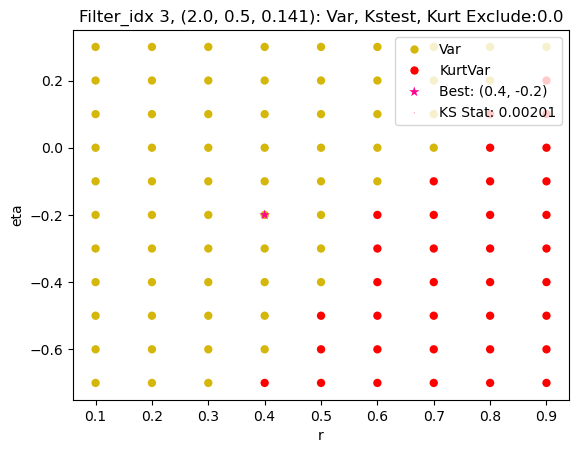

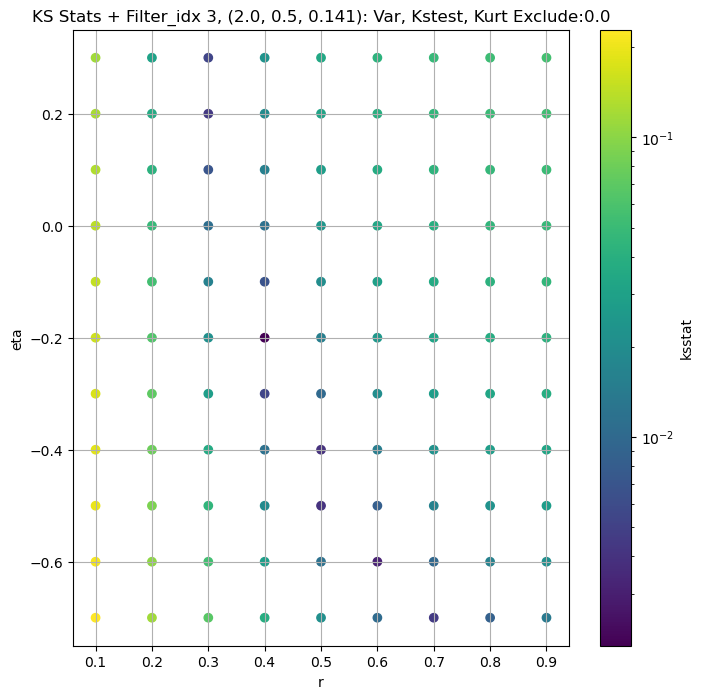

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.002815627579742852 0.9830495


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.004638218618746359 0.92369074


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.00424508342579466 0.8921564


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.004960627564193146 0.845824
Number of samples: 100000, Without approximation : 16384000.0


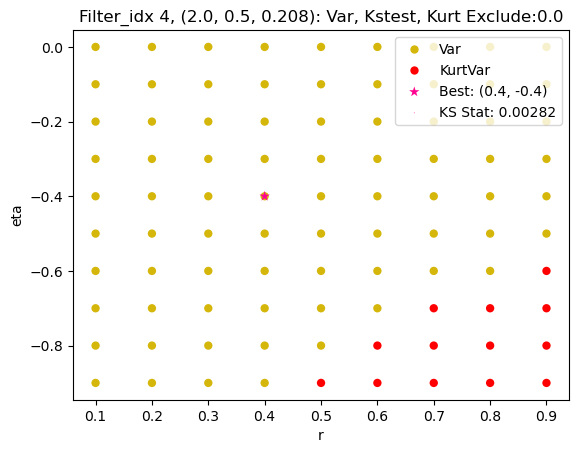

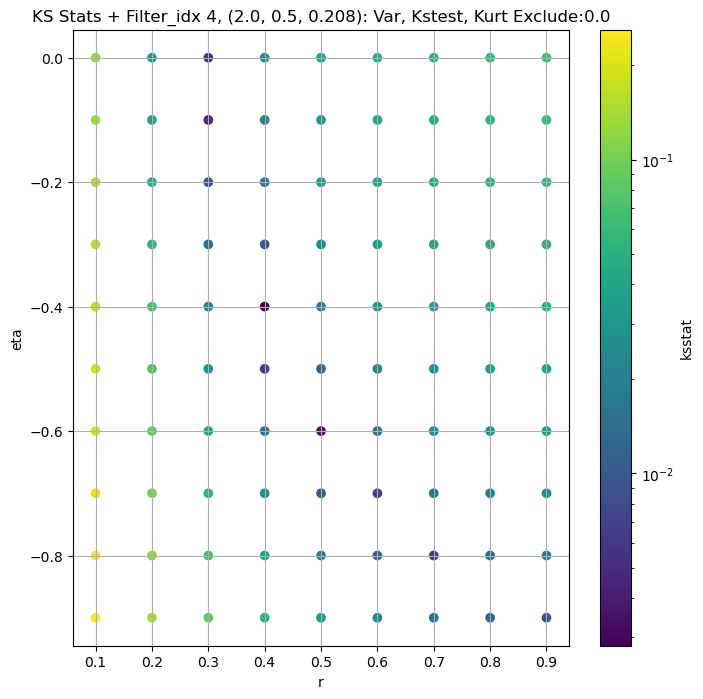

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.0037618465588736827 0.2809072


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.004298924137433158 0.26002014


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.005128496877466304 0.24969248


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.005964930249510059 0.23491958
Number of samples: 100000, Without approximation : 16384000.0


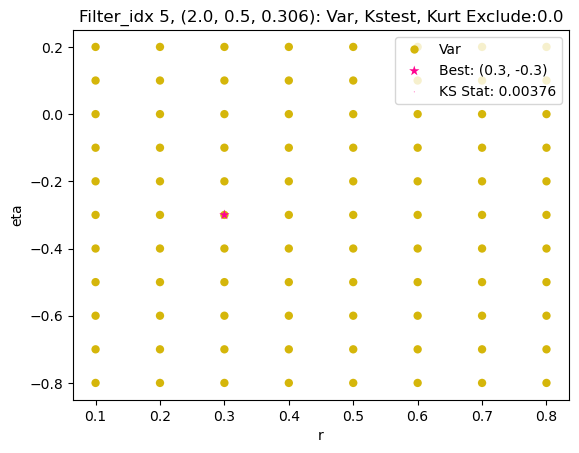

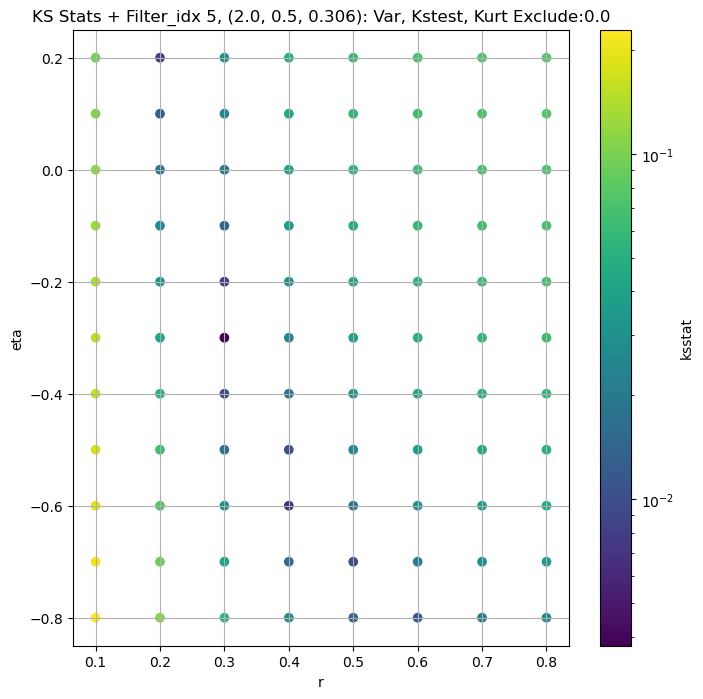

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.004233048135568462 0.15354717


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.004352150813766165 0.14086069


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.005222497379377744 0.13506578


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.006089538965377228 0.12693638
Number of samples: 100000, Without approximation : 16384000.0


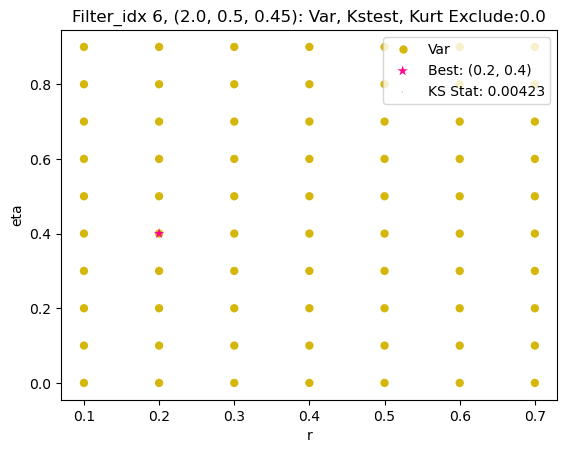

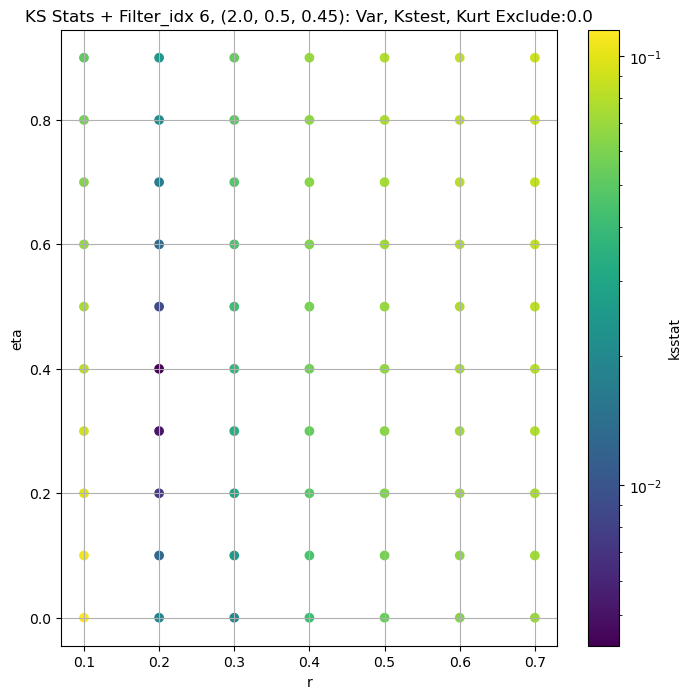

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.00044350262953701813 63.05527


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.001531954552727477 60.684605


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.002313368946651684 59.210728


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.003547564904566612 56.91801
Number of samples: 100000, Without approximation : 16384000.0


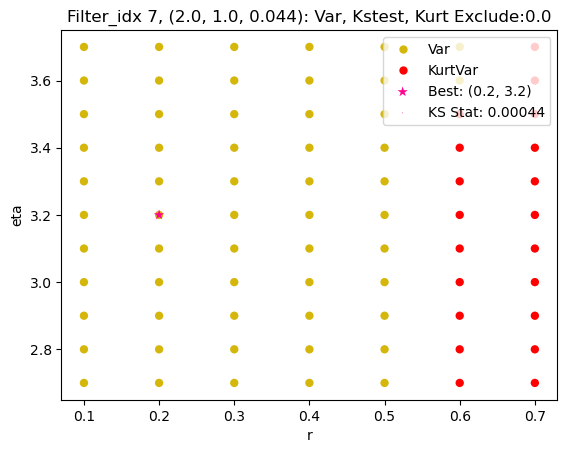

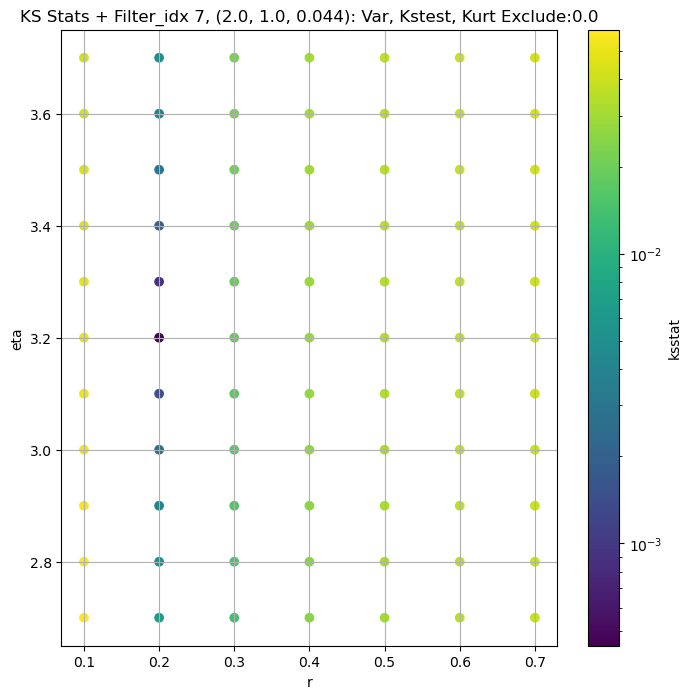

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.00047189852162910634 26.44106


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.001566864873313062 25.418959


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.0023634365408601206 24.778076


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.003778230632451418 23.77704
Number of samples: 100000, Without approximation : 16384000.0


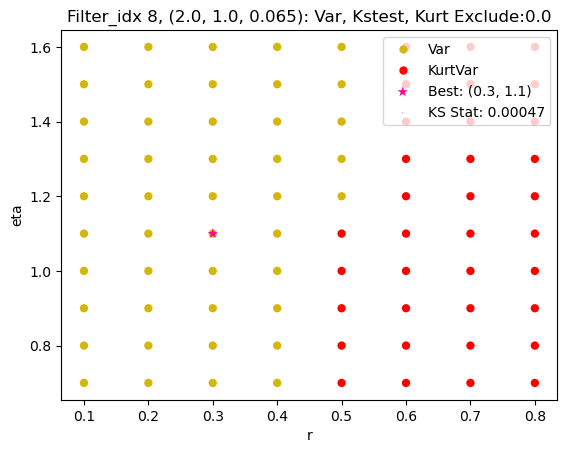

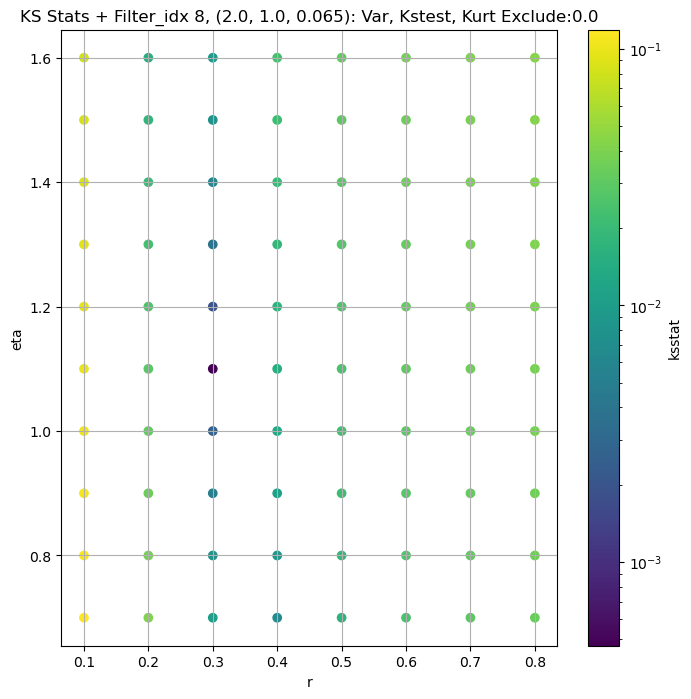

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.0009004701411412519 9.860673


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.0013320921384502166 9.389365


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.0021811918979494846 9.1226225


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.0036696679384622018 8.720791
Number of samples: 100000, Without approximation : 16384000.0


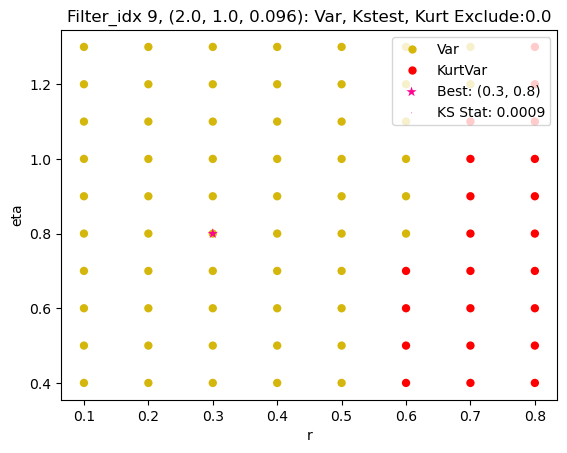

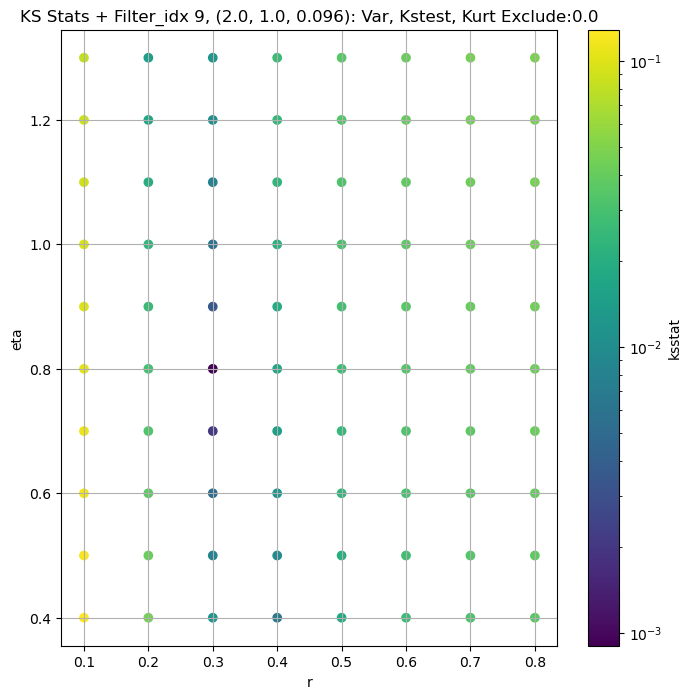

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.0006245448454655633 3.95118


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.001896308858517104 3.7520363


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.0025597173290383968 3.6397834


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.0039116773039868935 3.4702175
Number of samples: 100000, Without approximation : 16384000.0


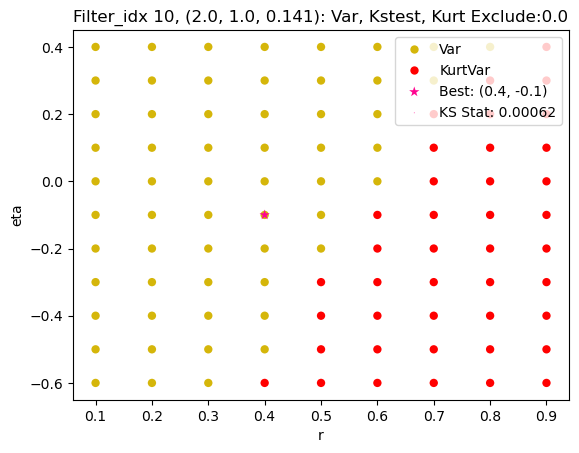

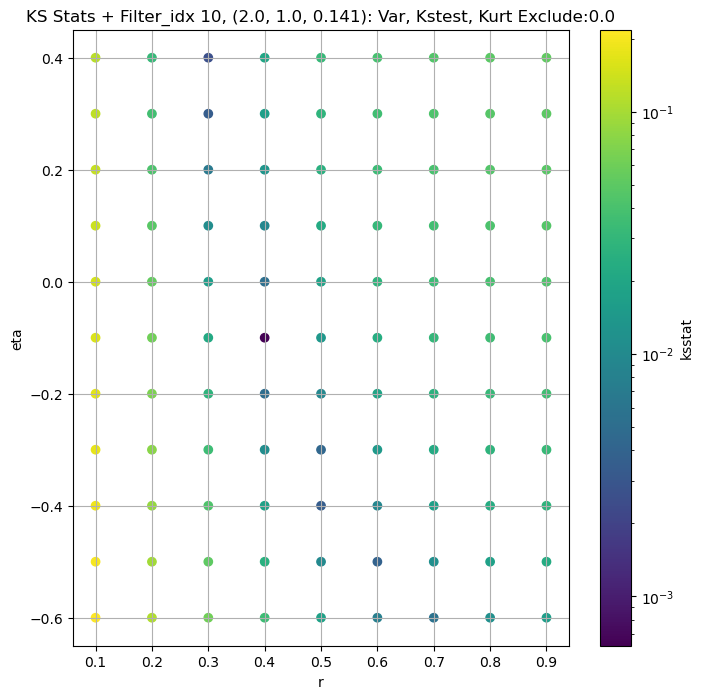

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.0021768800553433054 1.4988174


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.002774529177447471 1.4112271


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0034693368384647594 1.3626972


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.004933217686088398 1.2909623
Number of samples: 100000, Without approximation : 16384000.0


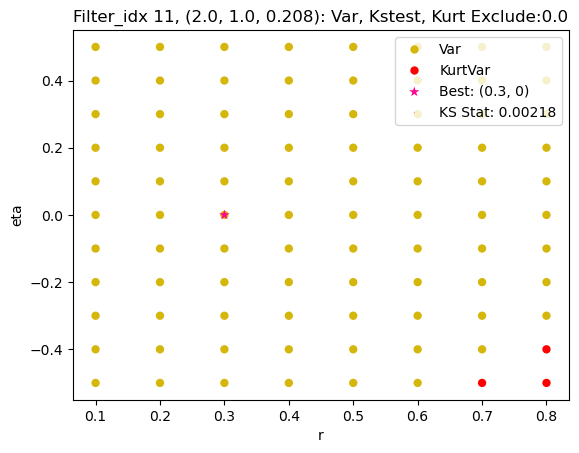

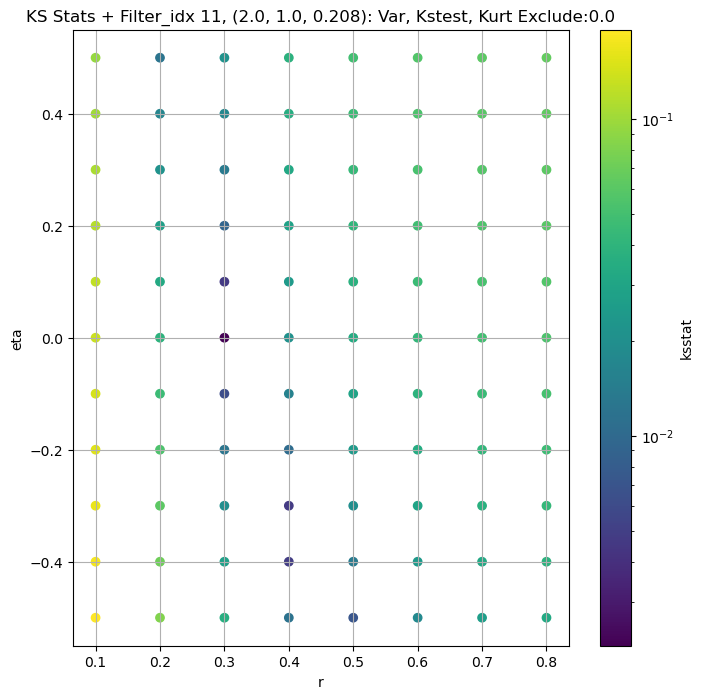

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.002479210763859263 0.4691078


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.004278353203469698 0.43592706


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.0037086424466115098 0.41917357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.005438570008641008 0.3950388
Number of samples: 100000, Without approximation : 16384000.0


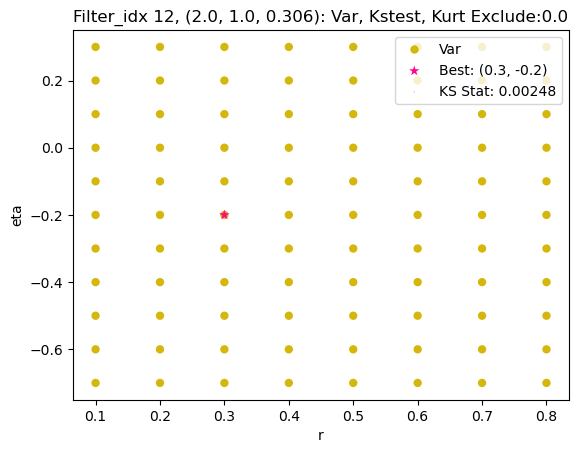

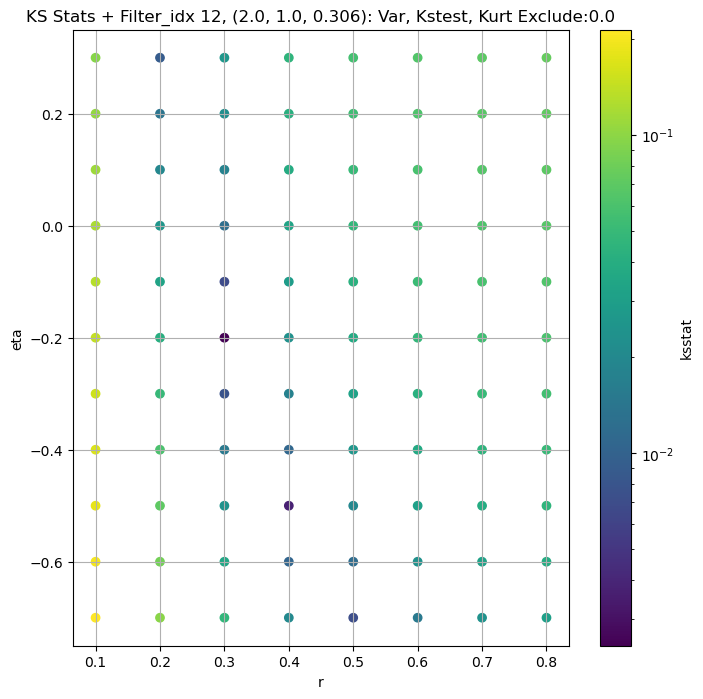

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.003287068886944411 0.16340677


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.004140872985831955 0.14862442


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.0040919405651177465 0.14186782


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.0063214107574255385 0.13247041
Number of samples: 100000, Without approximation : 16384000.0


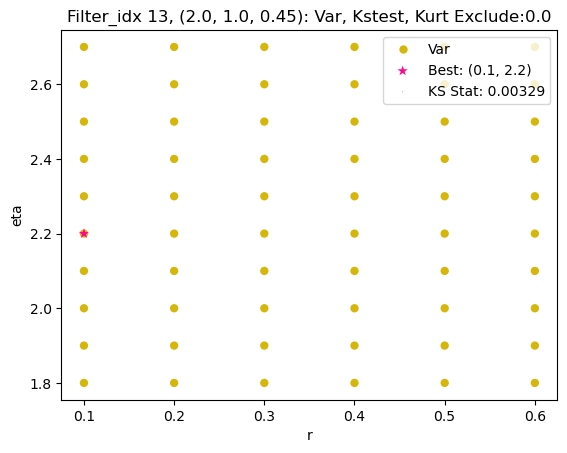

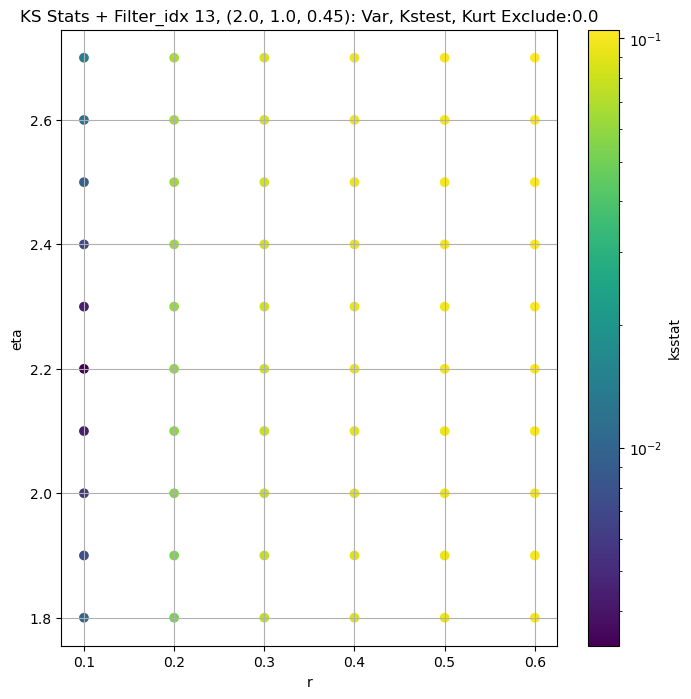

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.0007000388522523521 46.45727


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.0016175734944581556 44.73093


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.0022922323719626082 43.628826


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.0037826952419053317 41.90966
Number of samples: 100000, Without approximation : 16384000.0


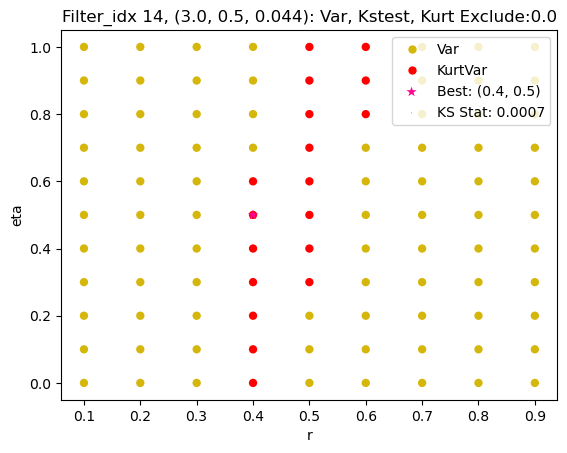

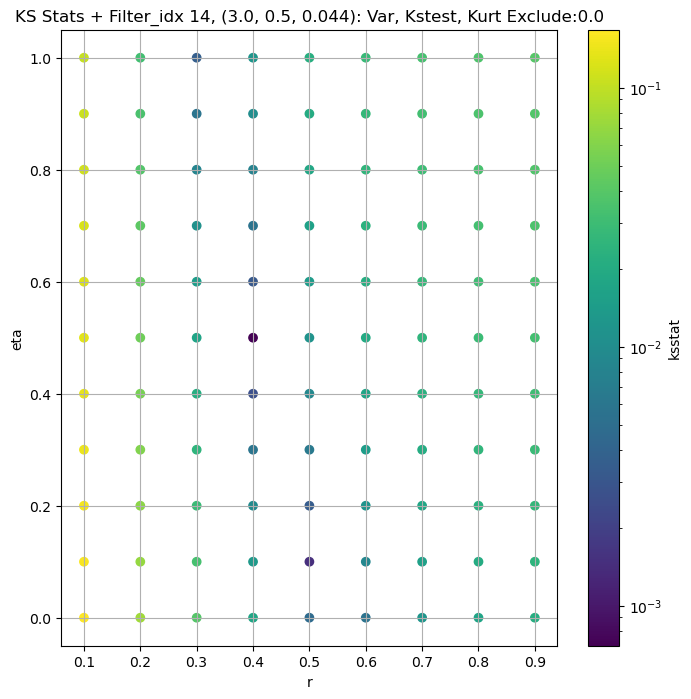

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.0020876408062665552 18.092983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.0015318849184848826 17.329641


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.0023109984824067203 16.865017


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.00382915559238195 16.14715
Number of samples: 100000, Without approximation : 16384000.0


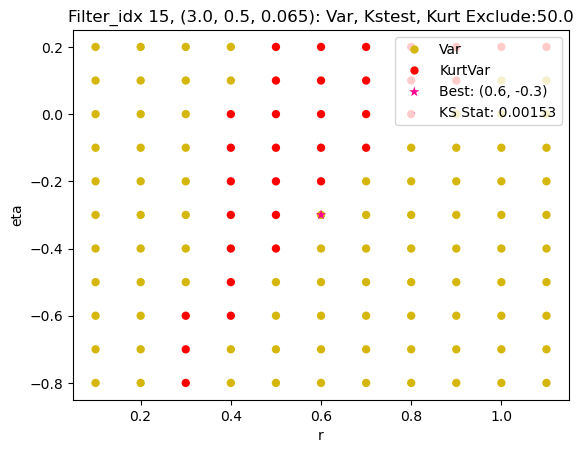

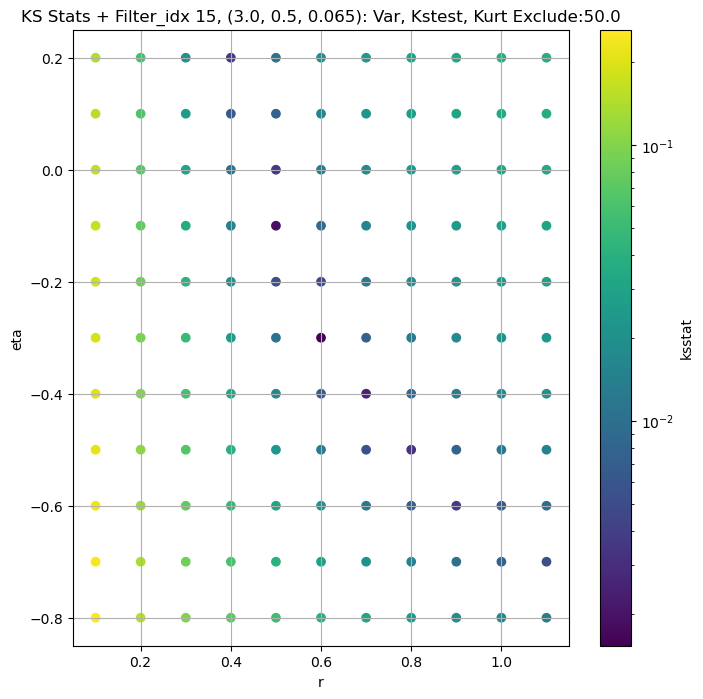

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.0021271071480563064 6.9346805


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.0029283144245433324 6.606777


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.0030493344151562712 6.418326


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.003880511915949958 6.1314955
Number of samples: 100000, Without approximation : 16384000.0


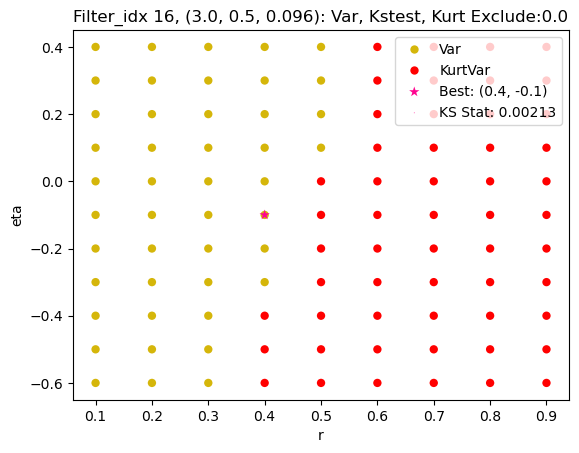

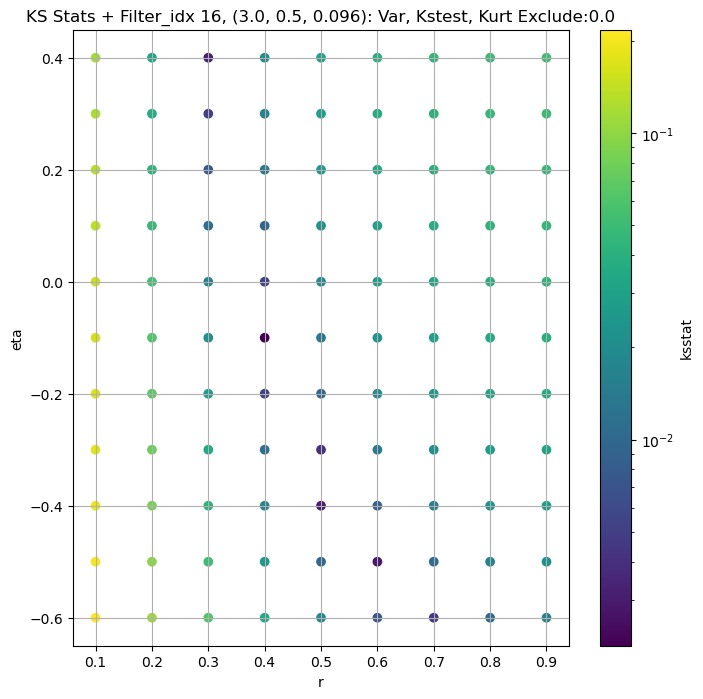

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.002772820265127679 2.649552


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.003590577762241254 2.509091


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.0043894650329781015 2.4296198


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.004718010771649517 2.3094459
Number of samples: 100000, Without approximation : 16384000.0


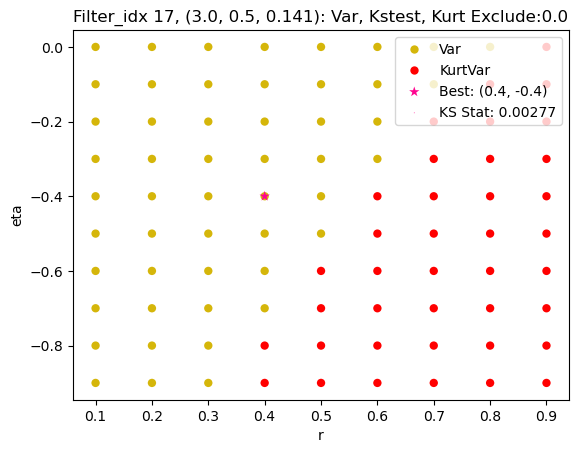

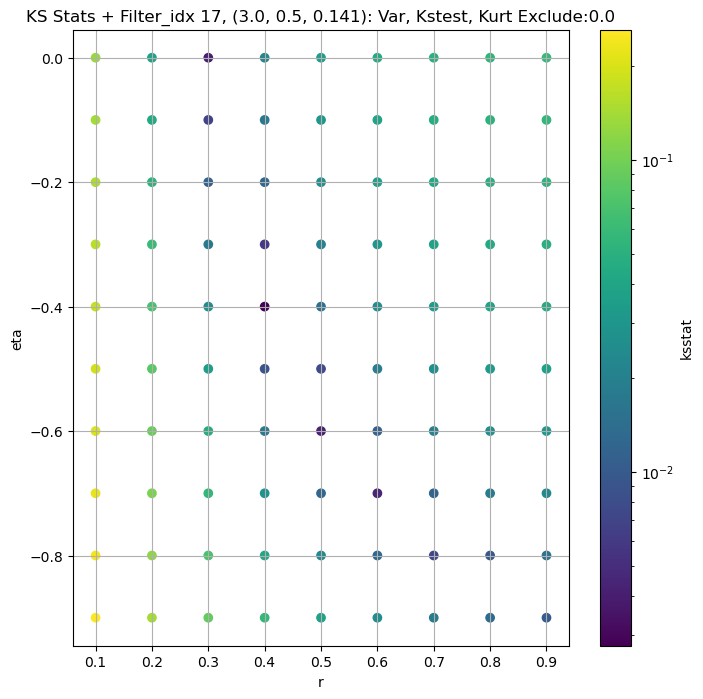

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.004340936851558008 0.9603564


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.005143062542389221 0.89904374


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.004932122664867644 0.8663468


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.007748010060250166 0.8179347
Number of samples: 100000, Without approximation : 16384000.0


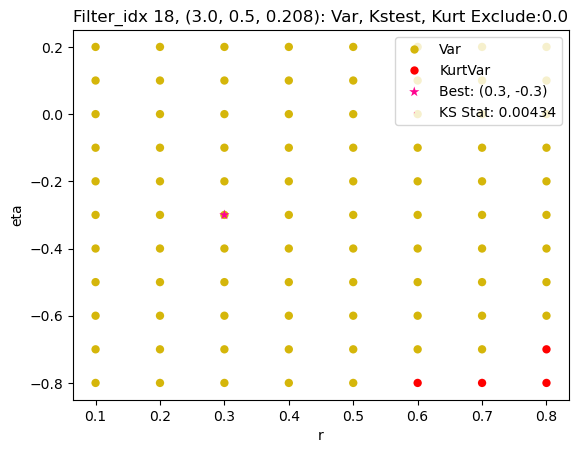

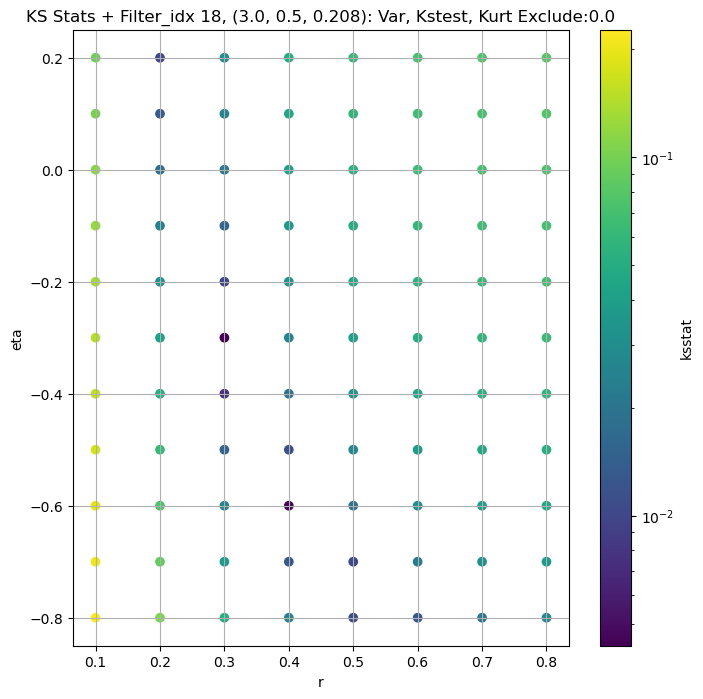

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.004485139520228887 0.27972898


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.004872419408925688 0.25863242


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.00638651244873456 0.24771175


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.007090260410042799 0.23190494
Number of samples: 100000, Without approximation : 16384000.0


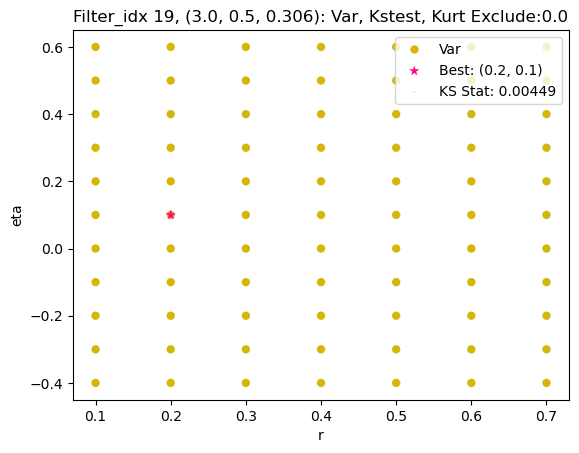

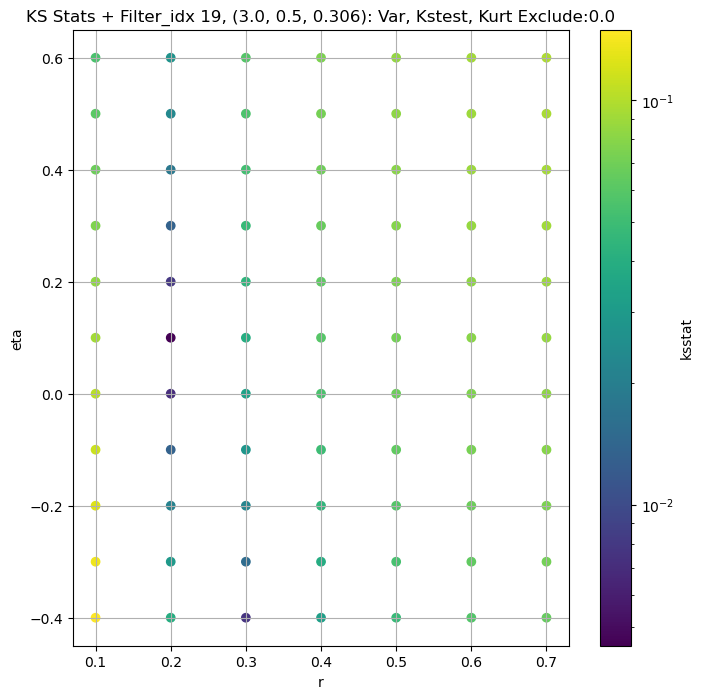

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.003618771570161994 0.08314991


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.004764469304110057 0.07494349


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.005596447627883694 0.071148634


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.006676201577000107 0.06593135
Number of samples: 100000, Without approximation : 16384000.0


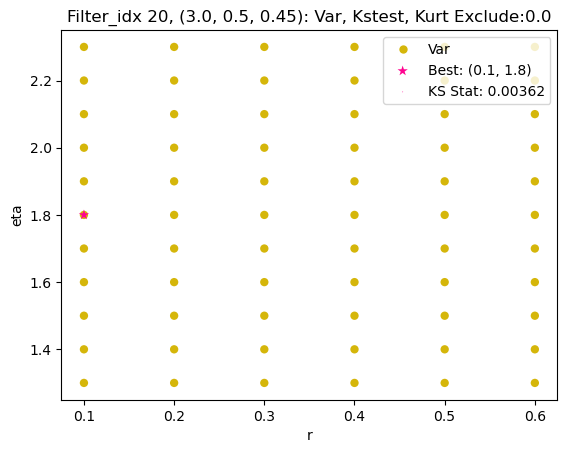

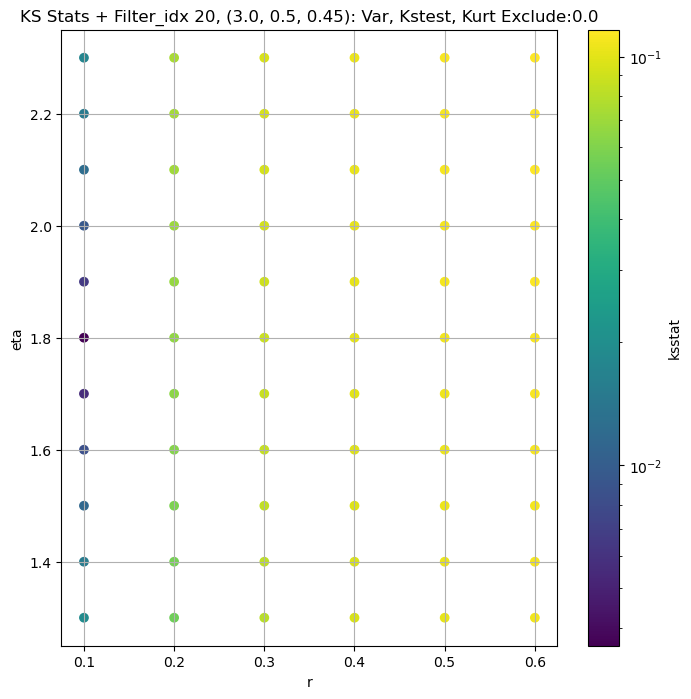

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.0008243928882043505 54.273457


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.0013975173847869359 51.96107


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.002234233732357649 50.566654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.0034645673387226905 48.434906
Number of samples: 100000, Without approximation : 16384000.0


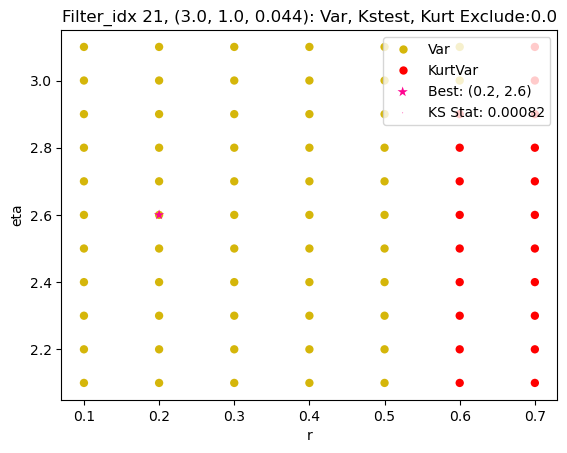

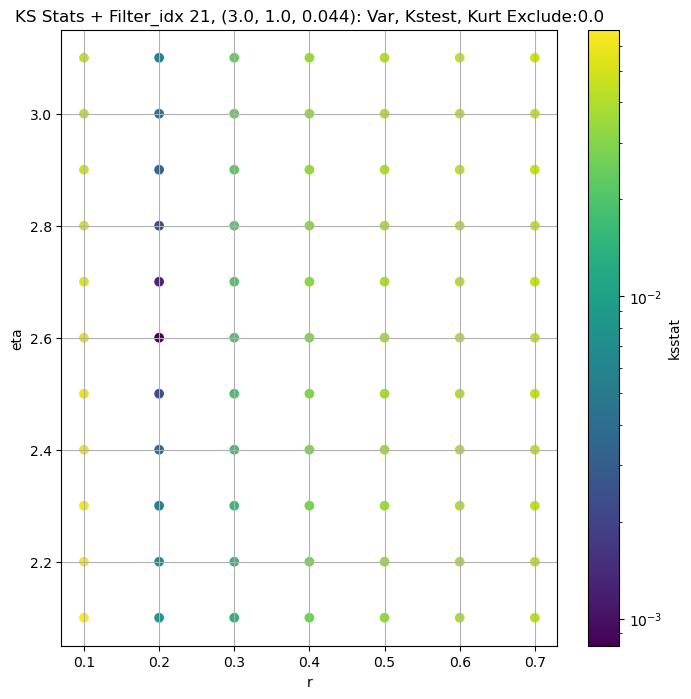

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.0006986047227137693 21.020073


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.0015371893212885457 20.07784


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.0023686725342655784 19.525772


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.0038178605079907044 18.684902
Number of samples: 100000, Without approximation : 16384000.0


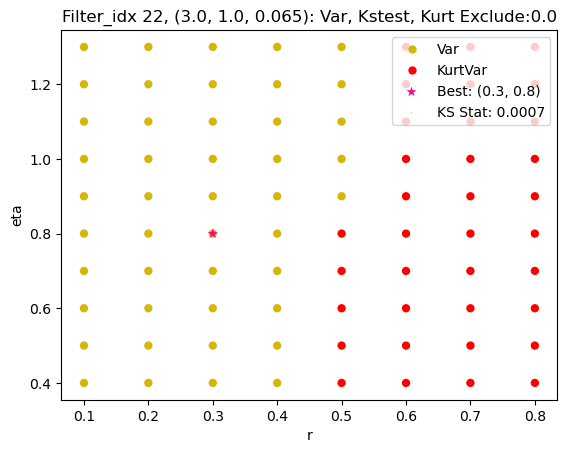

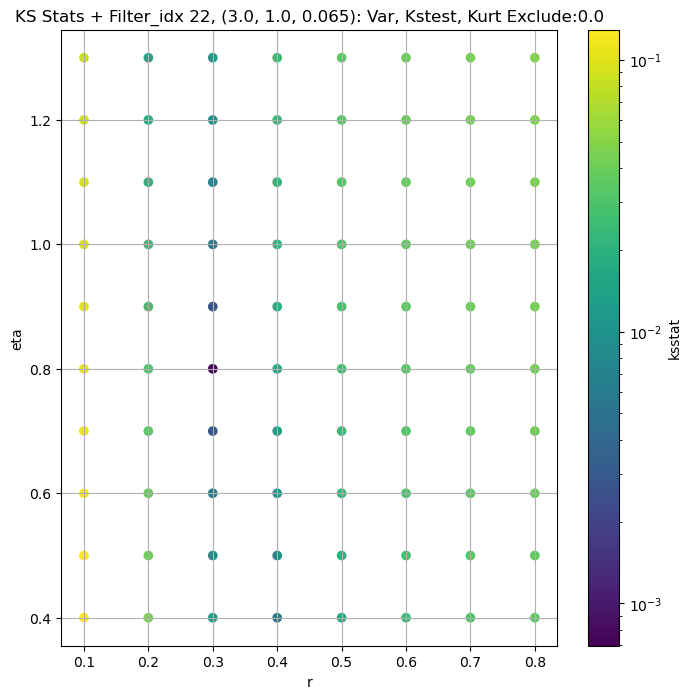

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.001761032611309804 8.227088


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.0015998065798381589 7.797941


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.0029767821115274096 7.55421


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.0037877267777882695 7.189192
Number of samples: 100000, Without approximation : 16384000.0


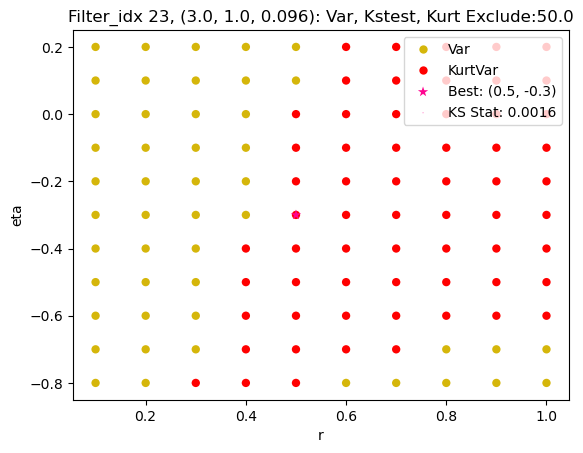

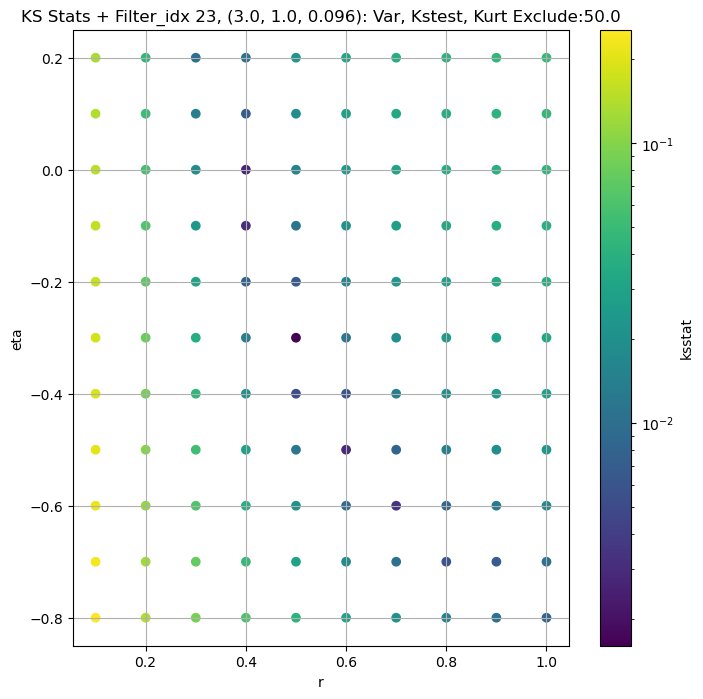

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.0022837242398489055 3.0656562


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.0029002138400803235 2.8949971


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.003415962088373664 2.7973654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.004436028957594429 2.6511147
Number of samples: 100000, Without approximation : 16384000.0


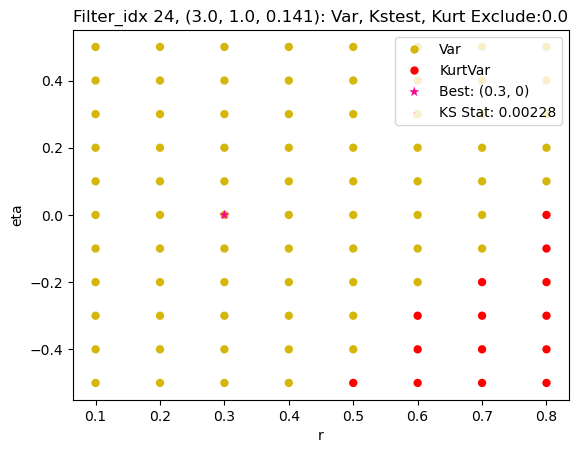

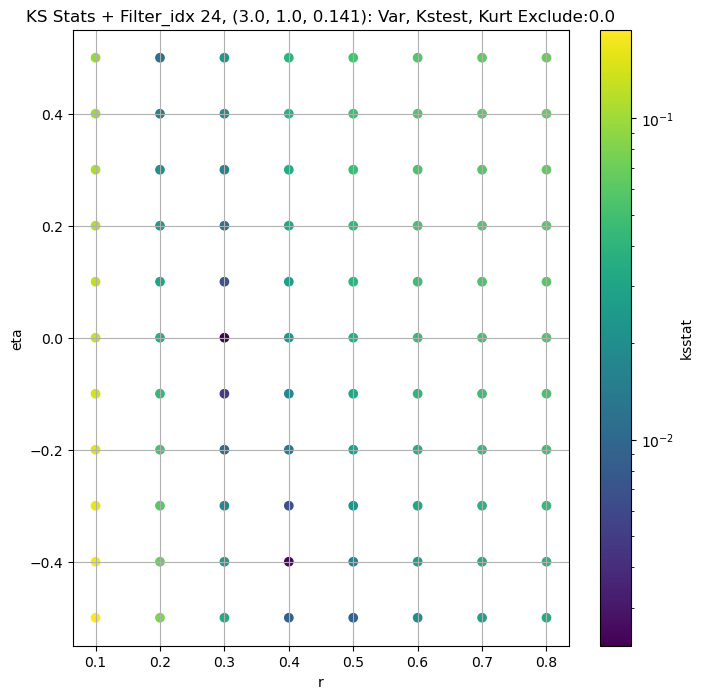

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.003937350752973745 1.1325456


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.005387515206578319 1.0517602


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.004574536591277378 1.0109245


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.006941285414078846 0.9508768
Number of samples: 100000, Without approximation : 16384000.0


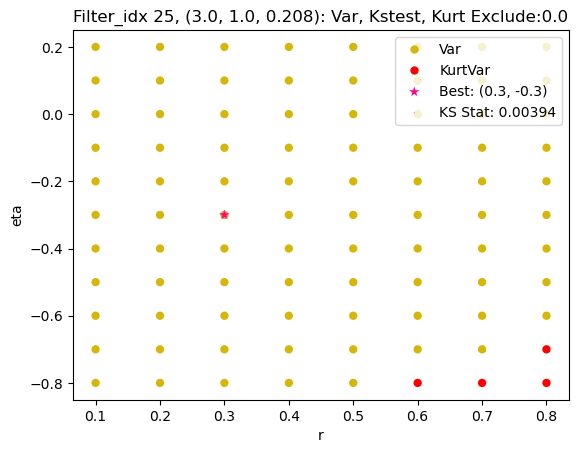

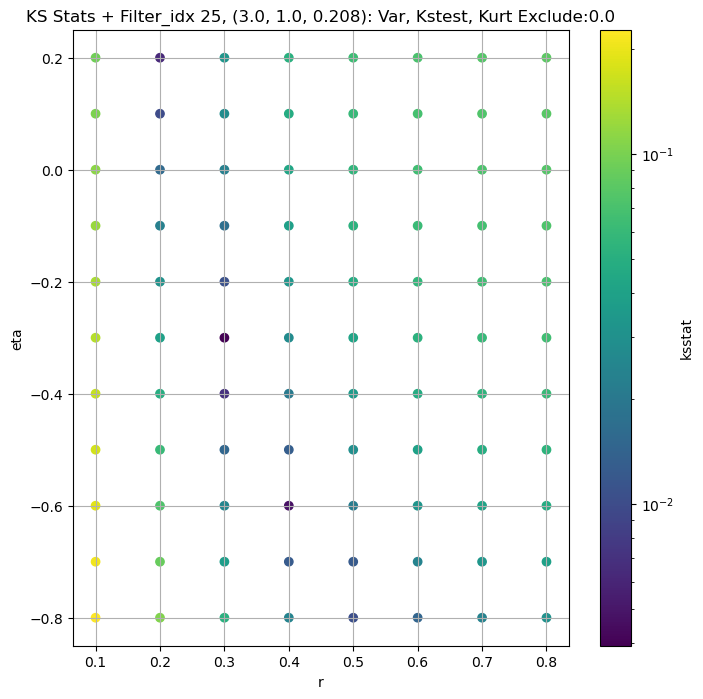

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.0044806002602301165 0.37004274


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.004729554286869442 0.3410133


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.006091041889672466 0.32604662


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.0060533747256011905 0.3044473
Number of samples: 100000, Without approximation : 16384000.0


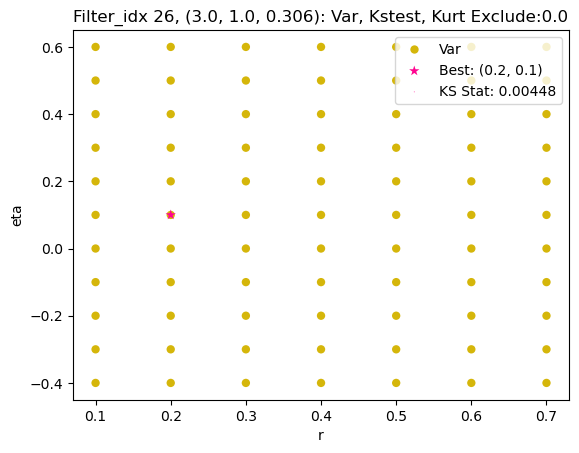

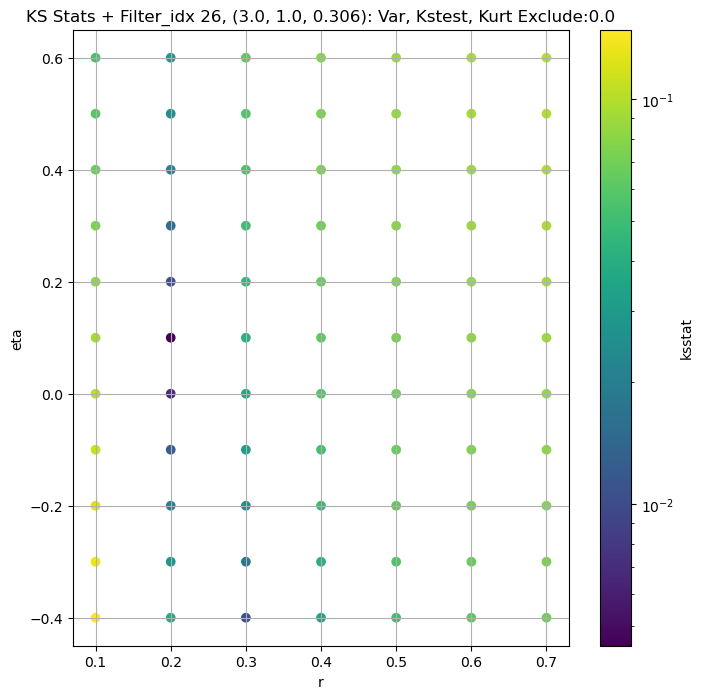

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.0059854501841460905 0.09274154


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.004713875698939107 0.08228809


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.005895725918081962 0.07787172


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.006428990038341693 0.07175822
Number of samples: 100000, Without approximation : 16384000.0


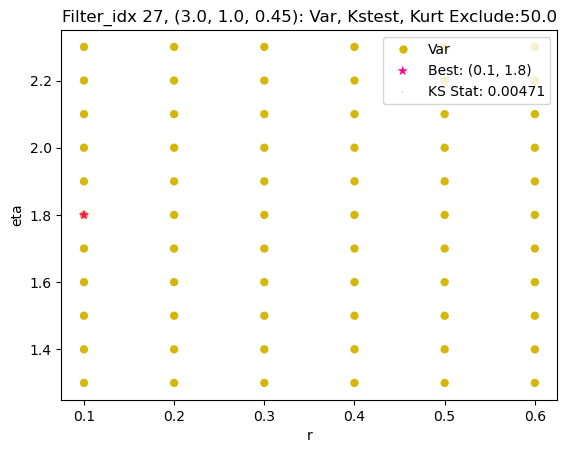

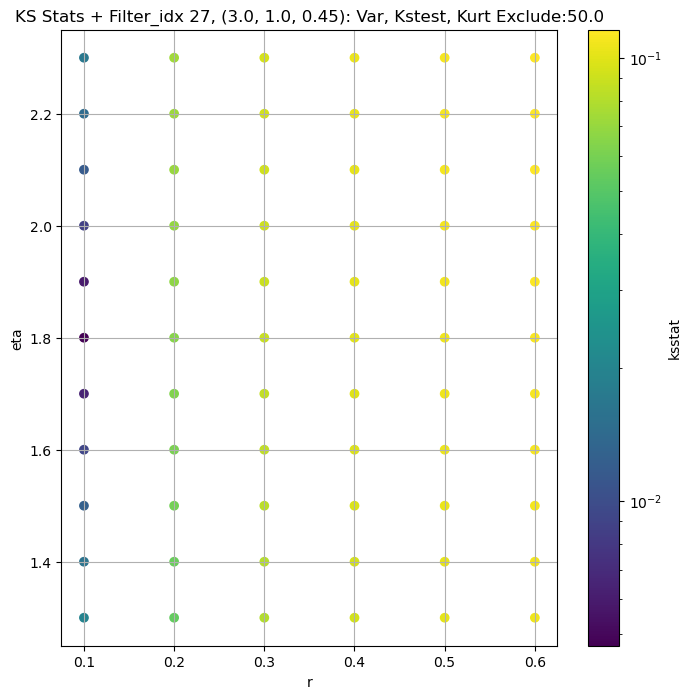

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.0006198272770029378 45.146366


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.0015339148049252627 43.381622


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.002325124473185291 42.311176


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.0035923317887662336 40.654793
Number of samples: 100000, Without approximation : 16384000.0


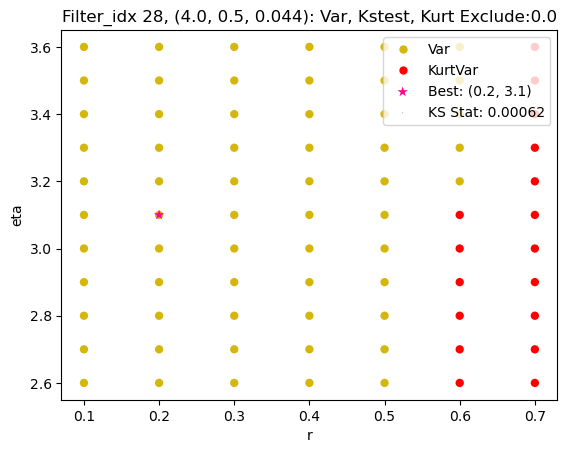

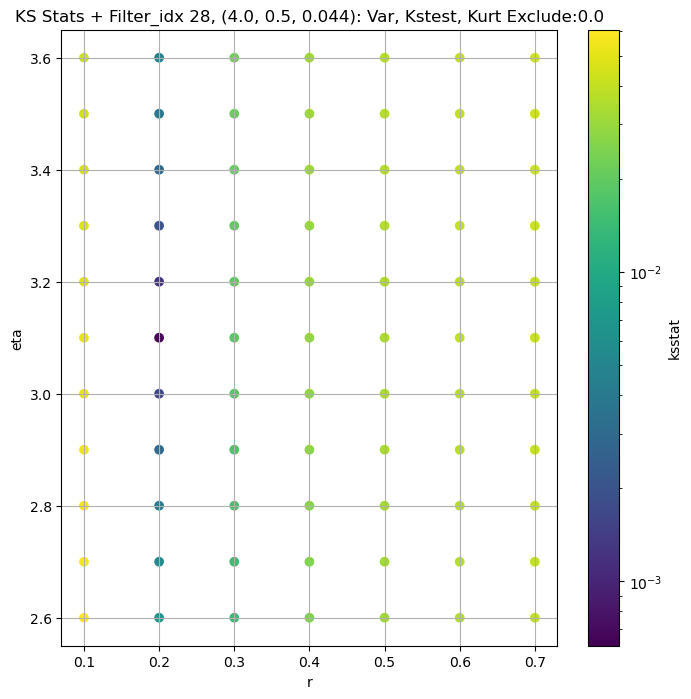

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.0007448116470998301 17.704641


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.0012719941304958262 16.993423


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.0020906867313729566 16.556002


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.0034069732260488157 15.886549
Number of samples: 100000, Without approximation : 16384000.0


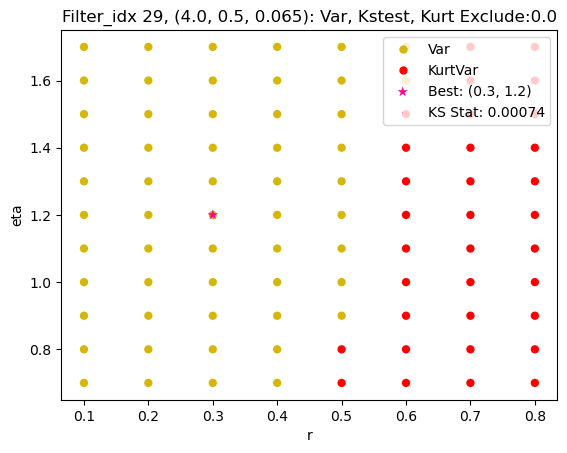

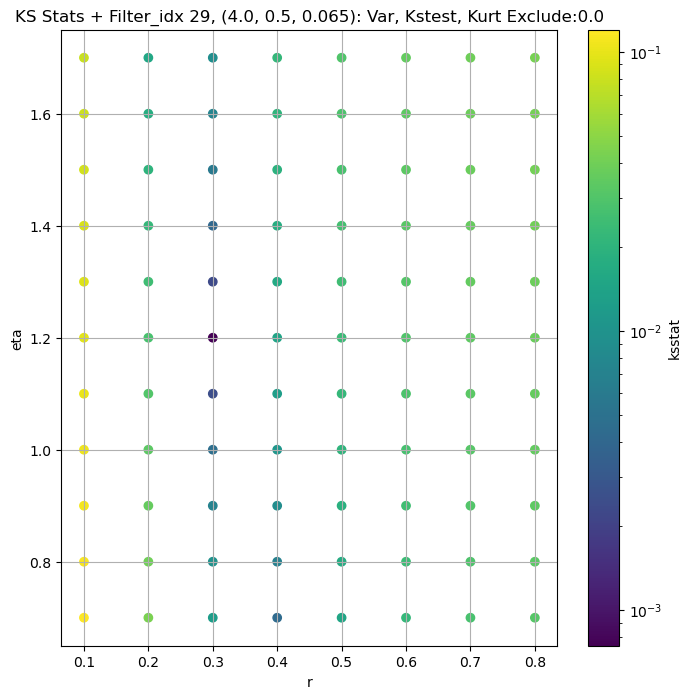

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.001679682205751265 6.537875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.0015763934804814417 6.2349024


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.0021260982781994564 6.0613394


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.0036171968438497223 5.7992587
Number of samples: 100000, Without approximation : 16384000.0


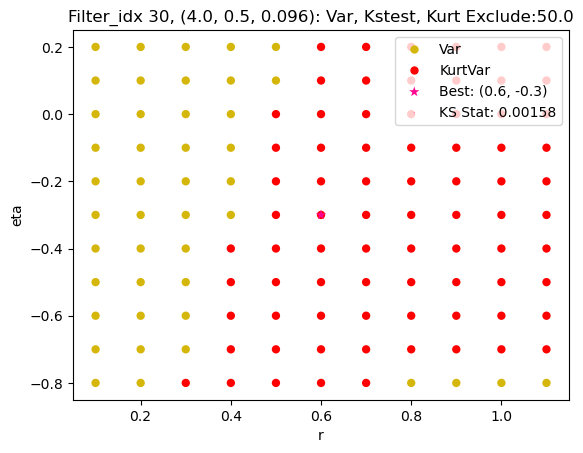

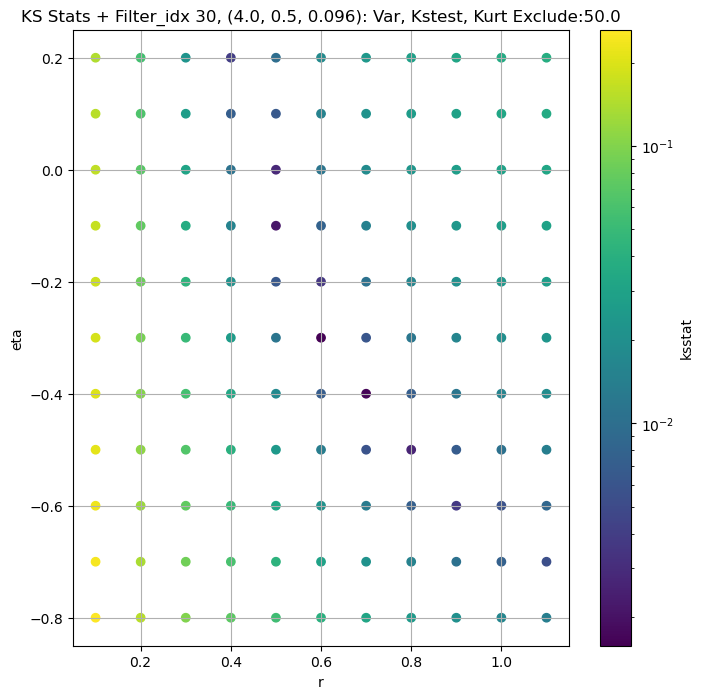

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.0027848973138634436 2.5577078


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.002103054392781911 2.421948


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.0035797995069306032 2.3467531


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.0040513052494089985 2.2331042
Number of samples: 100000, Without approximation : 16384000.0


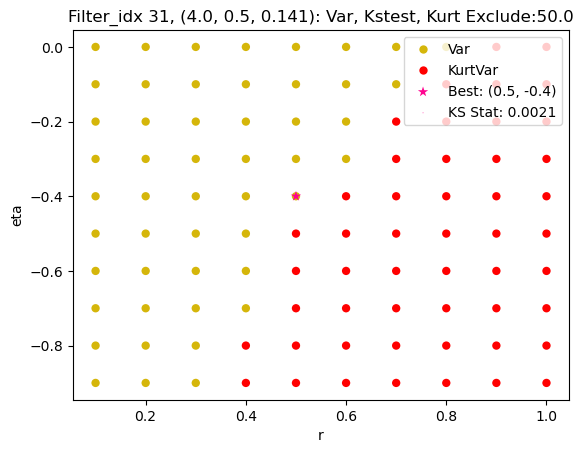

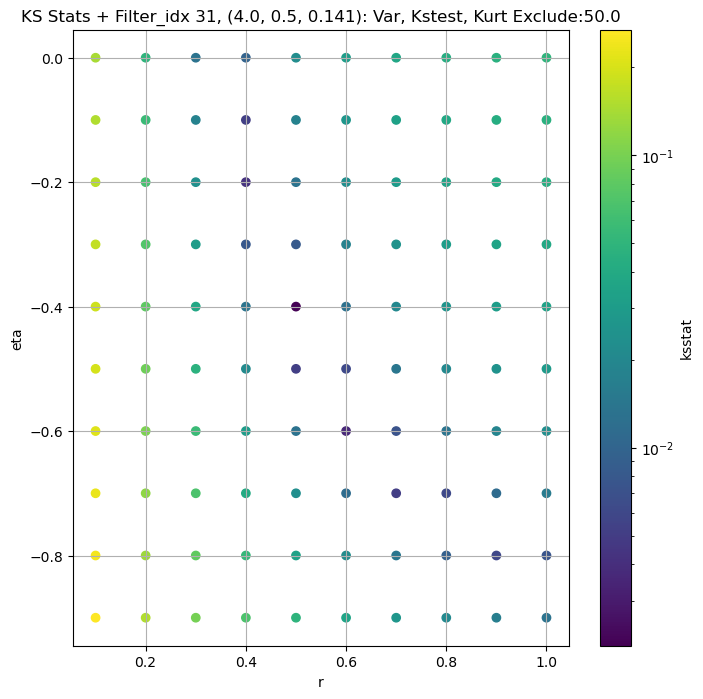

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.002572004522614857 0.9168425


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.005040704032764548 0.85761076


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.0035849797748778167 0.82666326


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.00514980996824832 0.7810692
Number of samples: 100000, Without approximation : 16384000.0


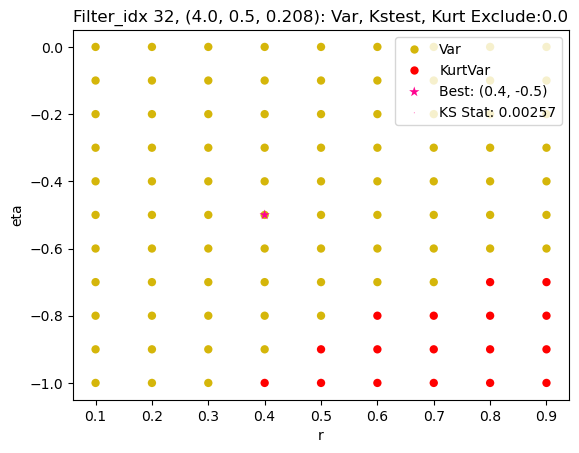

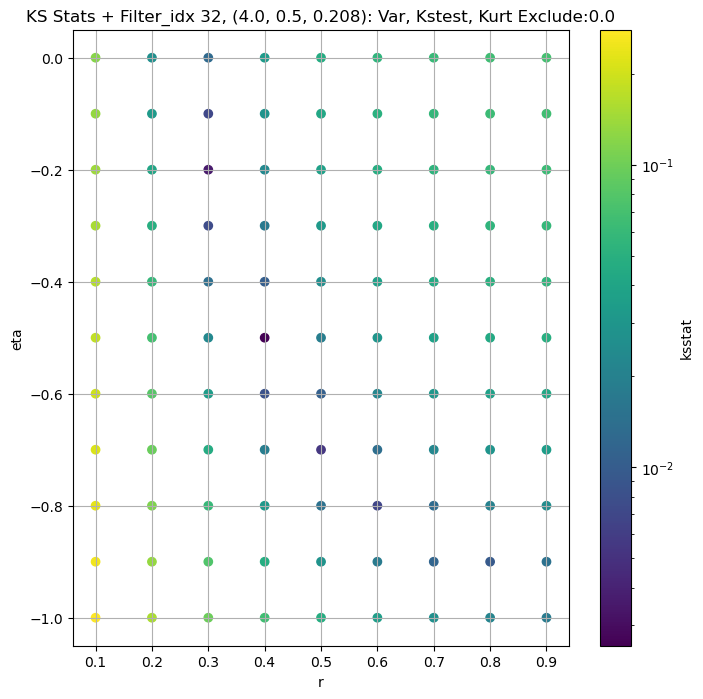

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.0035151829753287123 0.27176946


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.003709037750089461 0.25113305


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.005895857077394151 0.24045603


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.0061334413937684865 0.22504683
Number of samples: 100000, Without approximation : 16384000.0


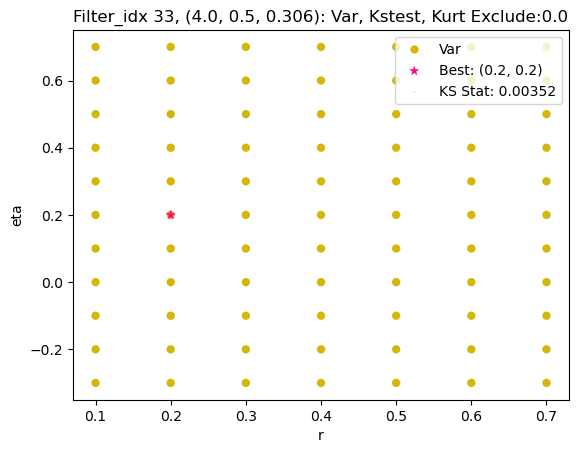

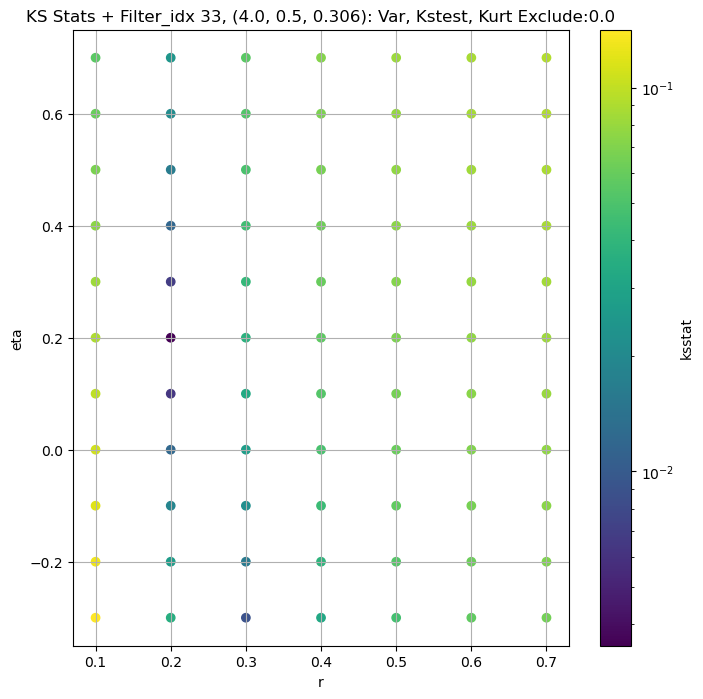

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.005353188892015193 0.06385216


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.003989393414915887 0.057398044


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.0050140918694238715 0.054498088


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.005651280845619722 0.050485197
Number of samples: 100000, Without approximation : 16384000.0


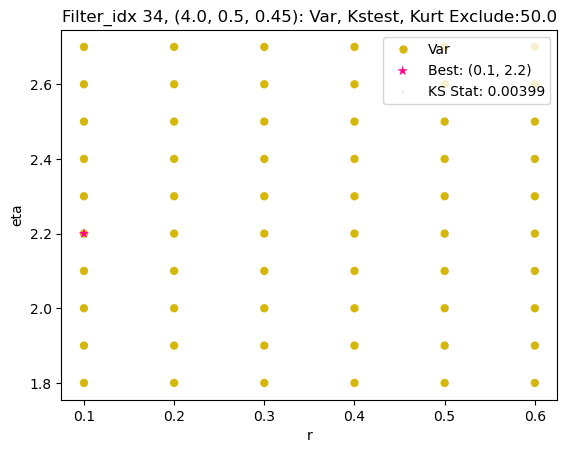

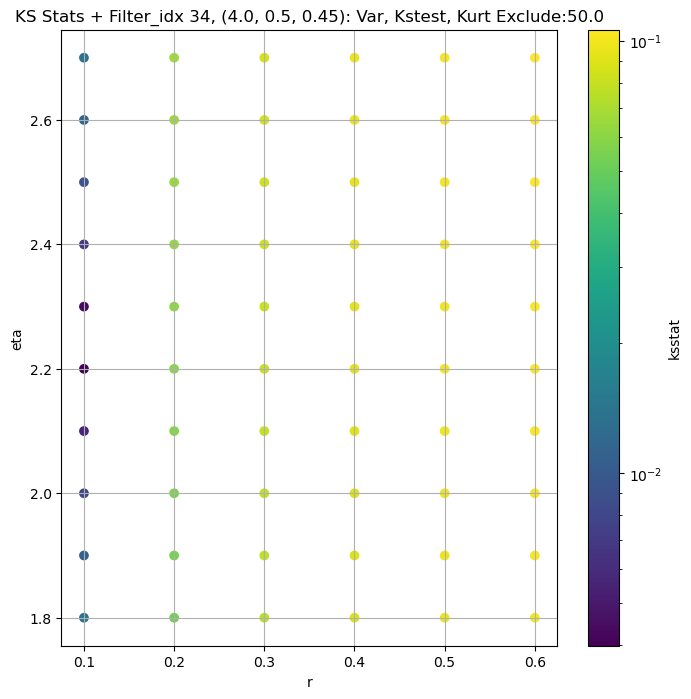

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.0005522014921355289 46.211063


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.0014301951937245594 44.631226


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.002275328104703933 43.608917


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.0036347489039941783 42.01952
Number of samples: 100000, Without approximation : 16384000.0


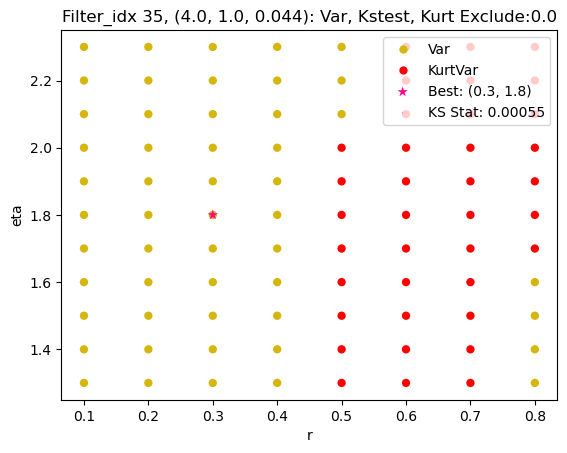

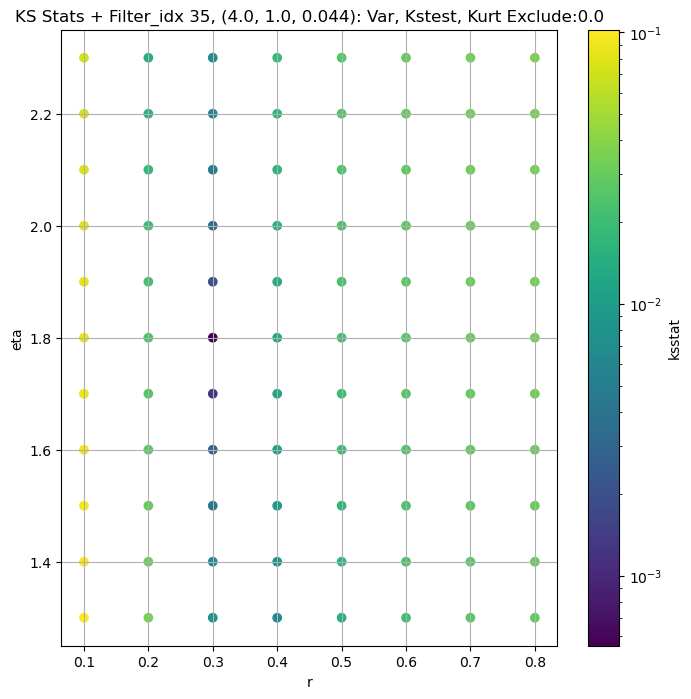

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.0011666976138324792 19.41968


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.0013464451240088882 18.479912


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.001922894588859747 17.984009


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.003332646216205739 17.235811
Number of samples: 100000, Without approximation : 16384000.0


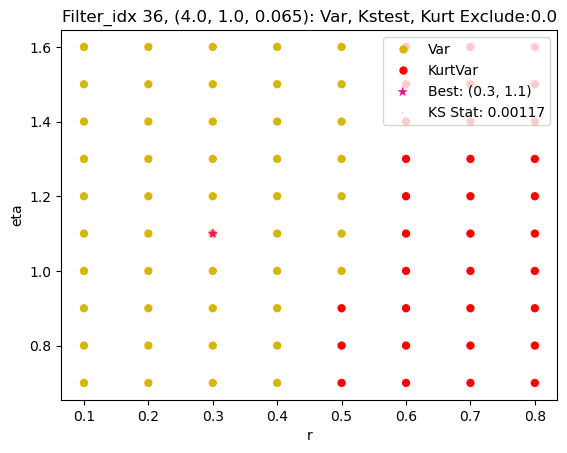

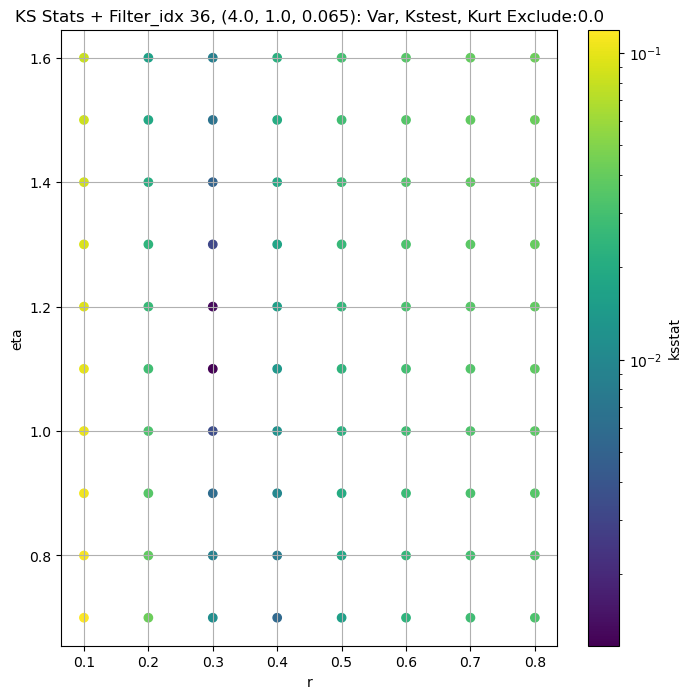

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.0007854825293215351 6.9876323


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.0014675375543090063 6.648099


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.0022495111958756864 6.4556513


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.0036649380388548702 6.1636786
Number of samples: 100000, Without approximation : 16384000.0


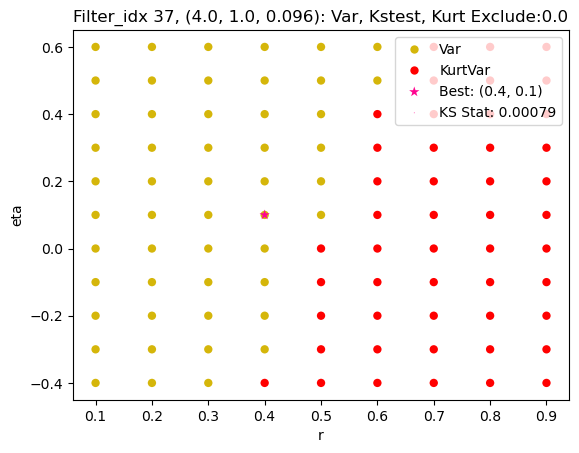

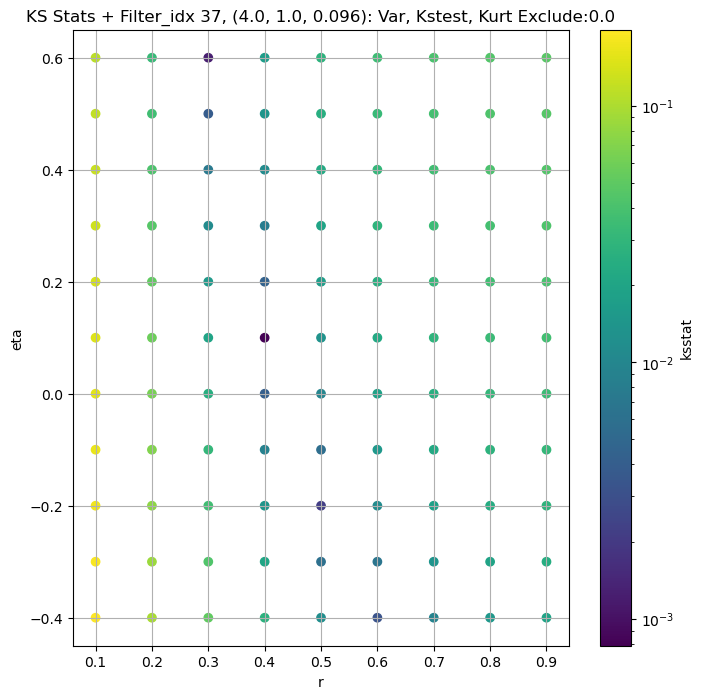

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.002234601001540215 2.7629268


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.0017894539526857947 2.610469


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.0031586651329523763 2.5268114


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.004258485516542995 2.4021068
Number of samples: 100000, Without approximation : 16384000.0


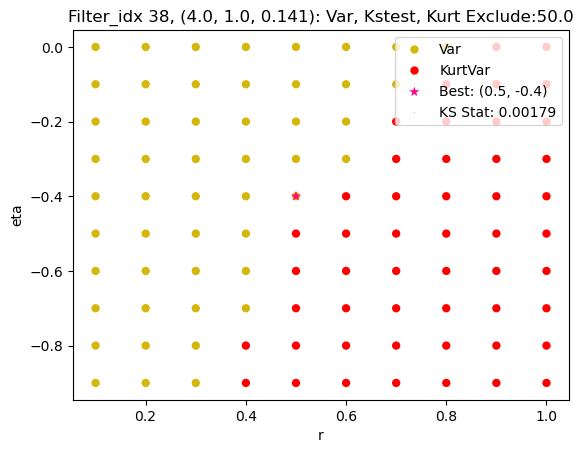

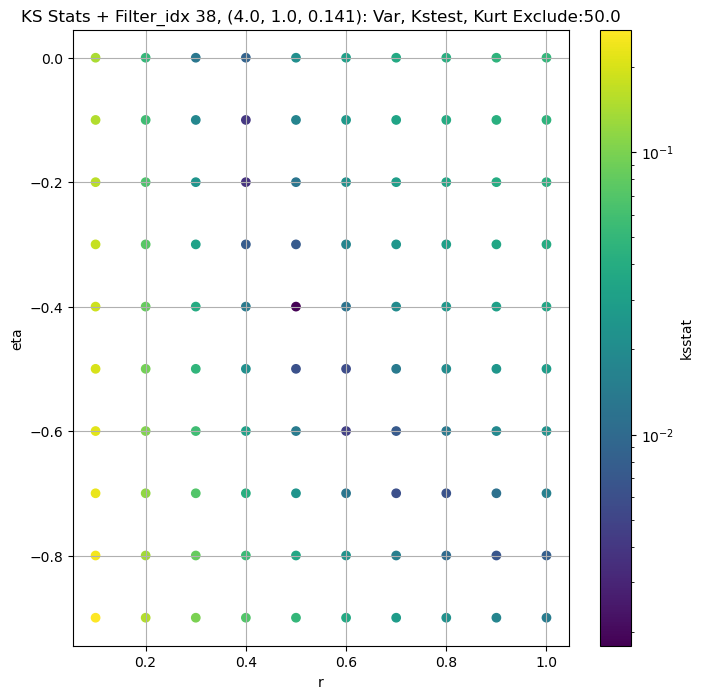

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.0020862454672310737 1.0155822


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.0035866865870045617 0.9478491


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.003843401916140743 0.9118015


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.004601254467642937 0.85897976
Number of samples: 100000, Without approximation : 16384000.0


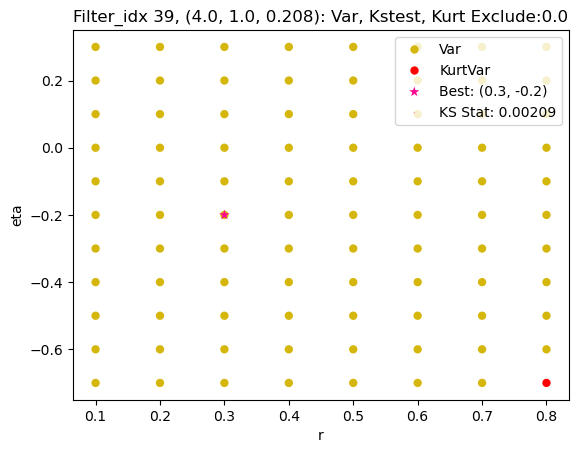

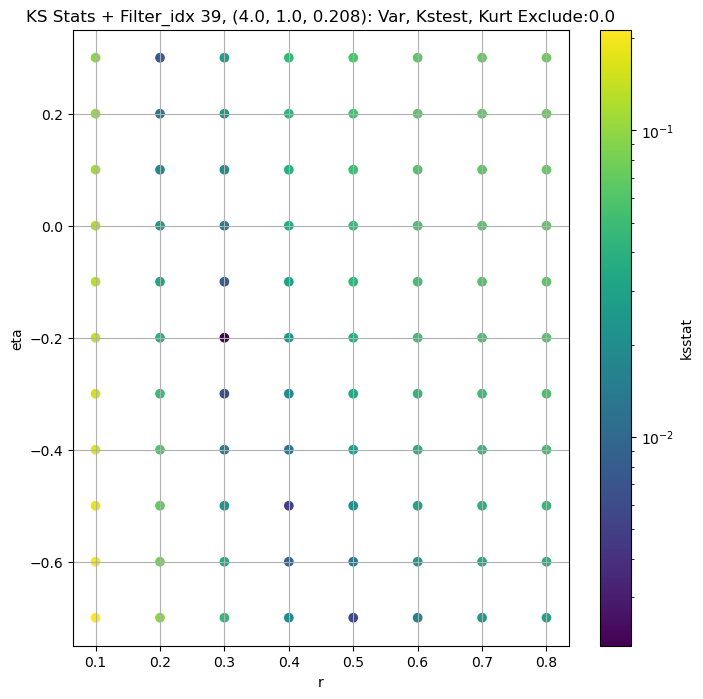

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.004223755163135737 0.31723952


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.004260629917591463 0.29175293


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.00433429316708879 0.2787669


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.006161370174162073 0.26018897
Number of samples: 100000, Without approximation : 16384000.0


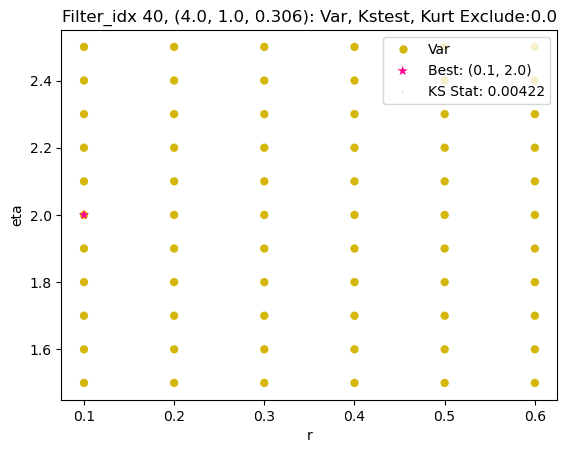

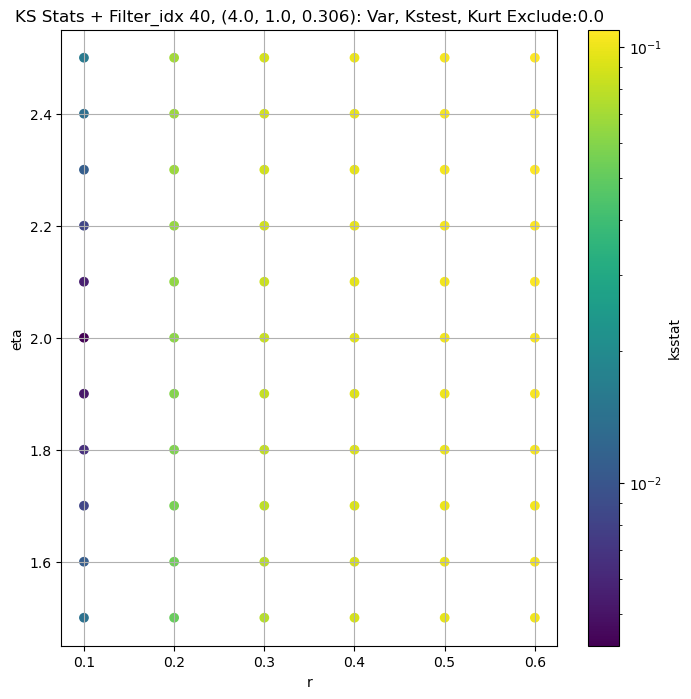

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.0062273734892952515 0.070666336


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.003956462019440998 0.062201377


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.004097945301513084 0.058769044


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.005291820825822802 0.054008402
Number of samples: 100000, Without approximation : 16384000.0


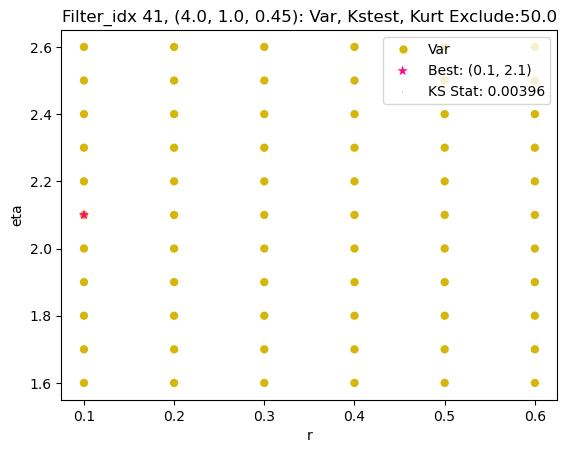

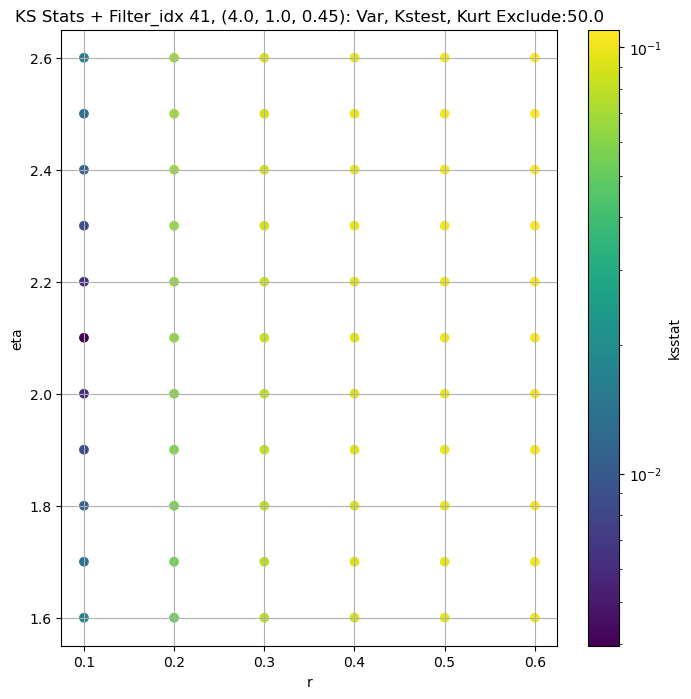

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",47.675446,38.538307,58.149254,4.035529,1.708707,11.881980,16384000.0,"(2.0, 0.5, 0.044)",0.000870,0.3,1.4,1.715196e-02,0.0,47.675446,0.000336
1,"(2.0, 0.5, 0.065)",19.243467,15.368475,24.224464,4.591545,1.823889,14.051207,16384000.0,"(2.0, 0.5, 0.065)",0.001012,0.5,0.0,1.603622e+00,0.0,19.243467,0.000336
2,"(2.0, 0.5, 0.096)",7.278729,5.873062,9.066898,5.347929,2.069188,19.490412,16384000.0,"(2.0, 0.5, 0.096)",0.001132,0.6,-0.4,2.060203e+00,0.0,7.278729,0.000336
3,"(2.0, 0.5, 0.141)",2.810154,2.207047,3.760558,6.991034,2.539103,32.836670,16384000.0,"(2.0, 0.5, 0.141)",0.002012,0.4,-0.2,9.092912e-02,0.0,2.810154,0.000336
4,"(2.0, 0.5, 0.208)",0.983050,0.753830,1.322739,9.225349,3.406891,56.309600,16384000.0,"(2.0, 0.5, 0.208)",0.002816,0.4,-0.4,4.490271e-02,0.0,0.983050,0.000336
5,"(2.0, 0.5, 0.306)",0.280907,0.209500,0.384200,13.071856,3.556167,79.350945,16384000.0,"(2.0, 0.5, 0.306)",0.003762,0.3,-0.3,1.243441e-03,0.0,0.280907,0.000336
6,"(2.0, 0.5, 0.45)",0.153547,0.113396,0.241269,16.764734,3.949549,131.470110,16384000.0,"(2.0, 0.5, 0.45)",0.004233,0.2,0.4,7.932084e-07,0.0,0.153547,0.000336
7,"(2.0, 1.0, 0.044)",63.055270,52.467660,76.867676,3.971615,1.687826,11.152740,16384000.0,"(2.0, 1.0, 0.044)",0.000444,0.2,3.2,5.893438e-06,0.0,63.055270,0.000336
8,"(2.0, 1.0, 0.065)",26.441060,21.522533,33.041473,4.424464,1.901211,13.735676,16384000.0,"(2.0, 1.0, 0.065)",0.000472,0.3,1.1,1.317125e-02,0.0,26.441060,0.000336


In [16]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [17]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.002517408456113701, var: 44.759796142578125


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.002046221207308574, var: 45.28399658203125


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.0016027470971261629, var: 45.873783111572266


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.0010888479103281674, var: 46.57941818237305


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.0007924909847081274, var: 47.675445556640625
Number of samples: 100000, Without approximation : 16384000.0


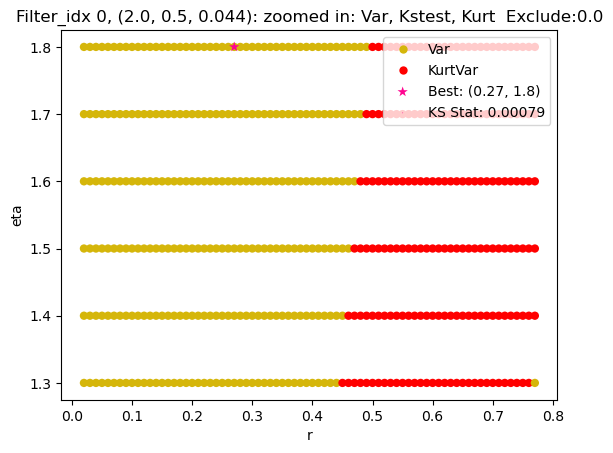

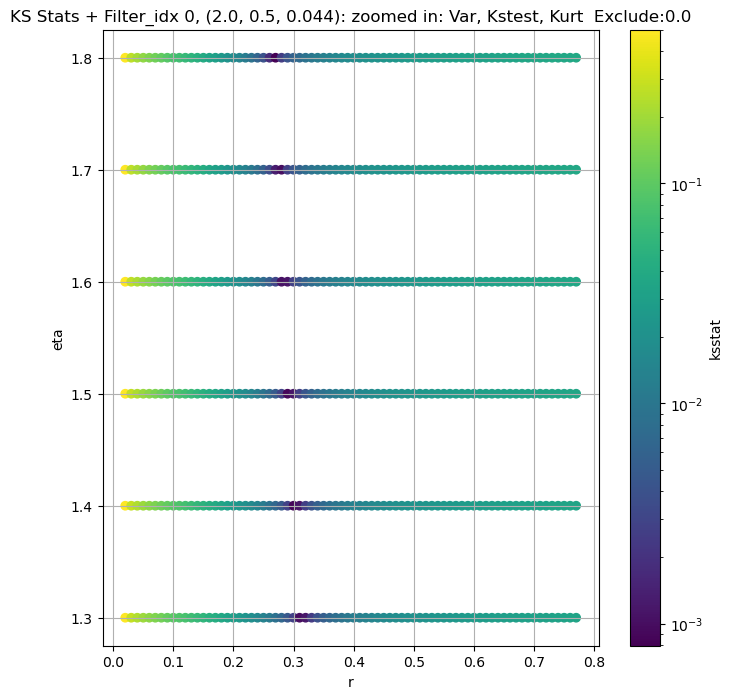

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1287 [00:00<?, ?it/s]

Finding Minimum after computing 1287 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.002226805130405452, var: 17.990619659423828


  0%|          | 0/1287 [00:00<?, ?it/s]

Finding Minimum after computing 1287 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.0018278497193805476, var: 18.21418571472168


  0%|          | 0/1287 [00:00<?, ?it/s]

Finding Minimum after computing 1287 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.0014071811310737321, var: 18.467130661010742


  0%|          | 0/1287 [00:00<?, ?it/s]

Finding Minimum after computing 1287 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.0009422310791786792, var: 18.76935386657715


  0%|          | 0/1287 [00:00<?, ?it/s]

Finding Minimum after computing 1287 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.0002847082999148931, var: 19.243467330932617
Number of samples: 100000, Without approximation : 16384000.0


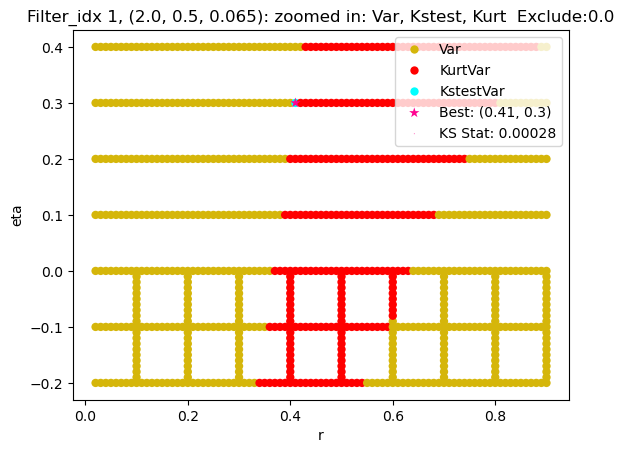

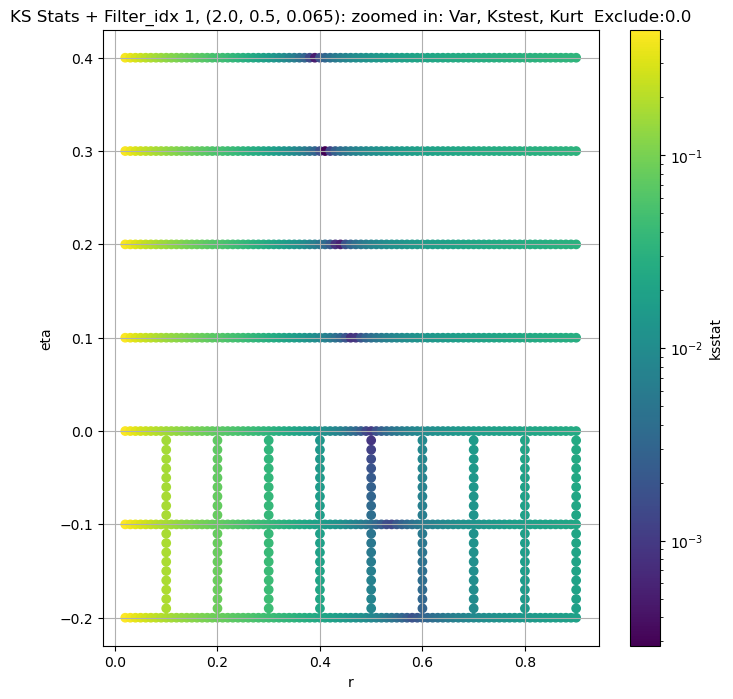

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.002108318491352401, var: 6.767331123352051


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.0017040147849169962, var: 6.856799602508545


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.0012823880044326996, var: 6.958168983459473


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.0008016693481802672, var: 7.080131530761719


  0%|          | 0/1620 [00:00<?, ?it/s]

Finding Minimum after computing 1620 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.0004589476251227742, var: 7.27872896194458
Number of samples: 100000, Without approximation : 16384000.0


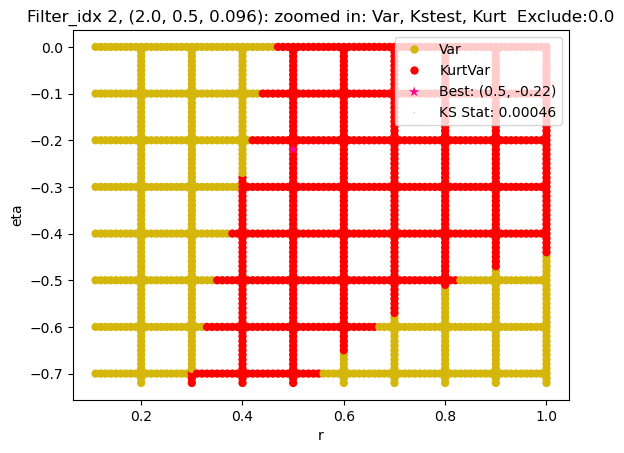

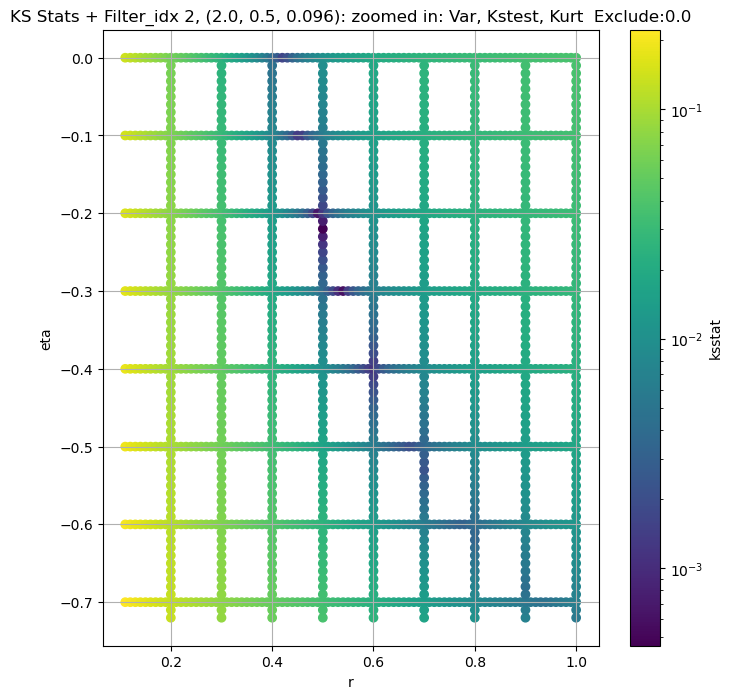

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.002617456713956759, var: 2.5850412845611572


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.0021371215357302784, var: 2.622842788696289


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.001899724284543991, var: 2.666100263595581


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.0017111907984490582, var: 2.7187016010284424


  0%|          | 0/1384 [00:00<?, ?it/s]

Finding Minimum after computing 1384 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.0013479992980446331, var: 2.8101534843444824
Number of samples: 100000, Without approximation : 16384000.0


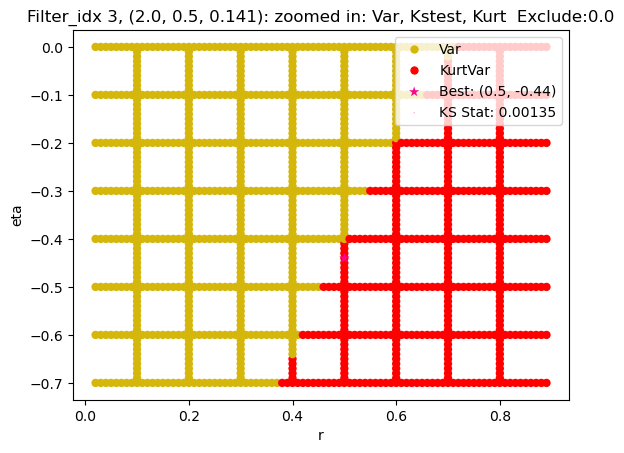

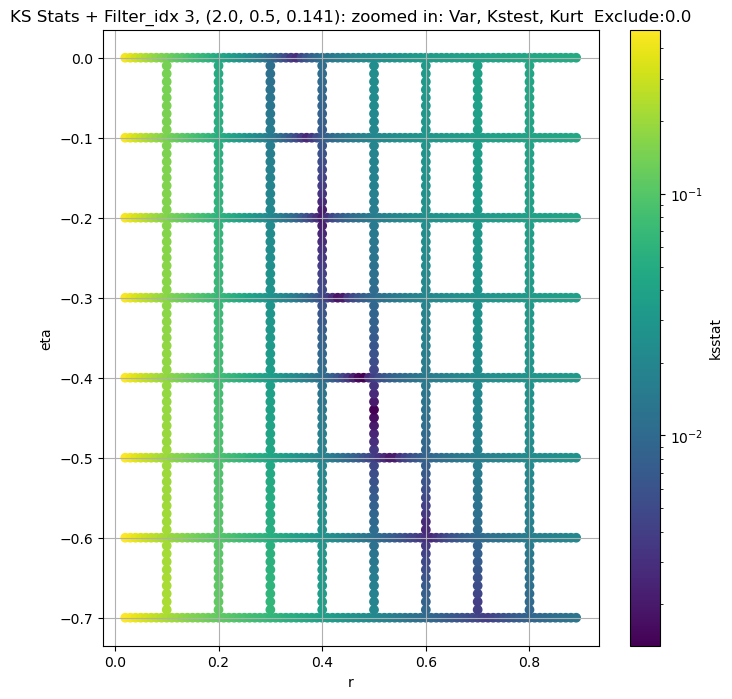

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 4, 0.0 + 100 = 100, ksstat: 0.0034343719814267093, var: 0.8921564221382141


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 4, 0.0 + 75 = 75, ksstat: 0.003321820740051294, var: 0.9067760109901428


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 4, 0.0 + 50 = 50, ksstat: 0.0027578011743081277, var: 0.9236907362937927


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 4, 0.0 + 25 = 25, ksstat: 0.0026520978463936418, var: 0.9446475505828857


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 4, 0.0 + 0 = 0, ksstat: 0.0020823784625015884, var: 0.9830495119094849
Number of samples: 100000, Without approximation : 16384000.0


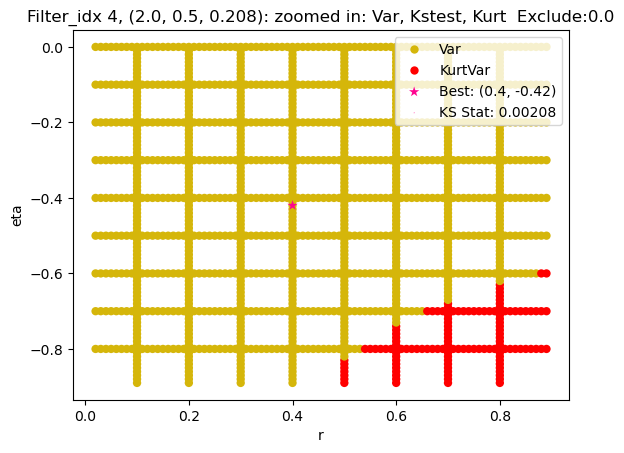

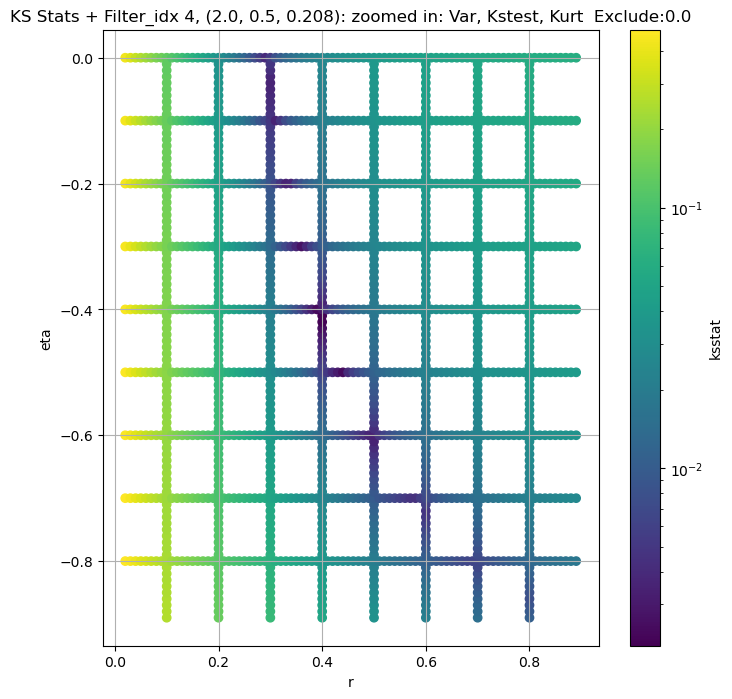

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.004103216867476778, var: 0.24969248473644257


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.004062177017272177, var: 0.25444862246513367


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.0034956945181751076, var: 0.2600201368331909


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.0032408473928806636, var: 0.2670786678791046


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.002774332453887529, var: 0.28090721368789673
Number of samples: 100000, Without approximation : 16384000.0


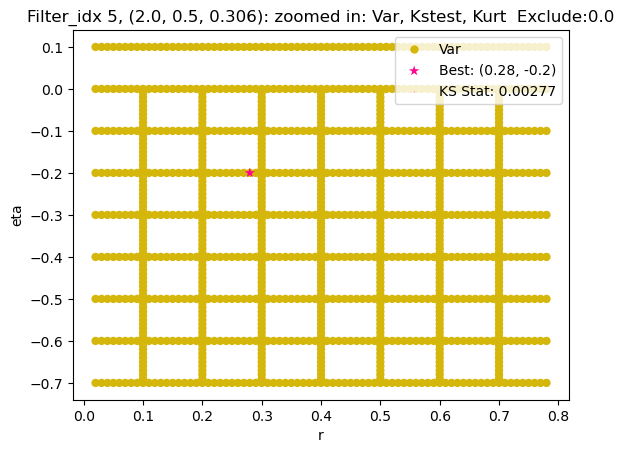

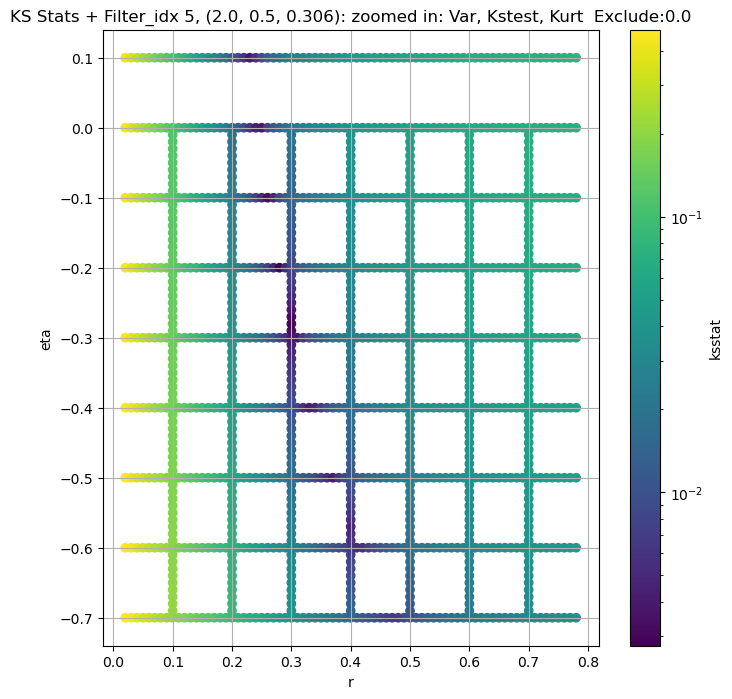

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 6, 0.0 + 100 = 100, ksstat: 0.005985209064346186, var: 0.13506577908992767


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 6, 0.0 + 75 = 75, ksstat: 0.0059519738759976, var: 0.1377190351486206


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 6, 0.0 + 50 = 50, ksstat: 0.00502855633984646, var: 0.1408606916666031


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 6, 0.0 + 25 = 25, ksstat: 0.004424463020421321, var: 0.14491359889507294


  0%|          | 0/684 [00:00<?, ?it/s]

Finding Minimum after computing 684 CDFs
filter_idx 6, 0.0 + 0 = 0, ksstat: 0.0033248642776816384, var: 0.15354716777801514
Number of samples: 100000, Without approximation : 16384000.0


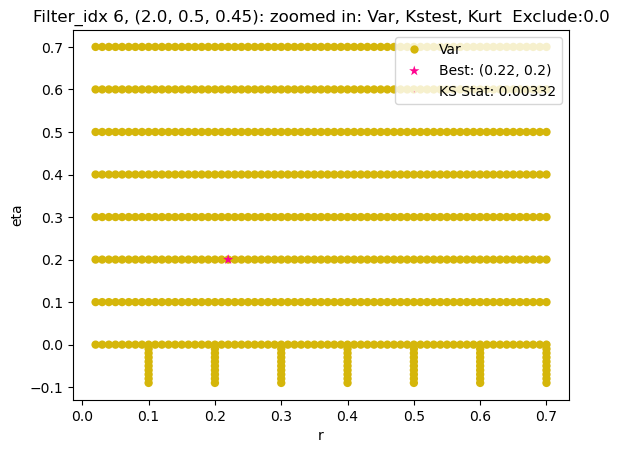

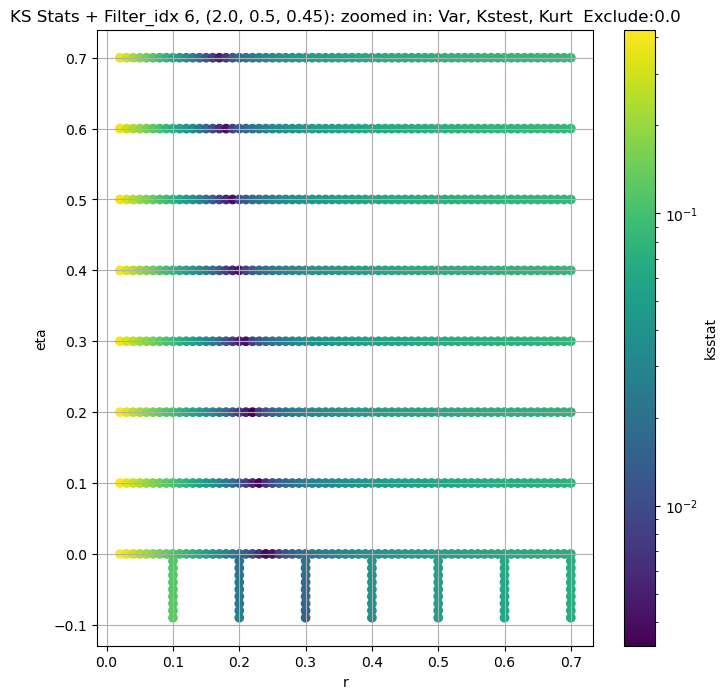

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.002713466582455859, var: 59.21072769165039


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.002229789369527415, var: 59.90485763549805


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.0017096808531191776, var: 60.68460464477539


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.001175416682745456, var: 61.60993576049805


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.00044350262953701813, var: 63.05527114868164
Number of samples: 100000, Without approximation : 16384000.0


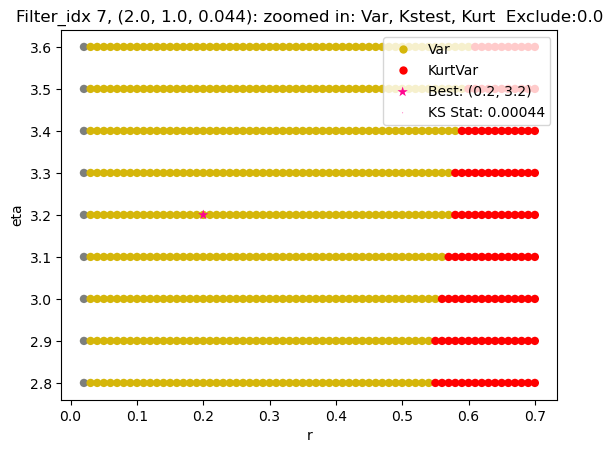

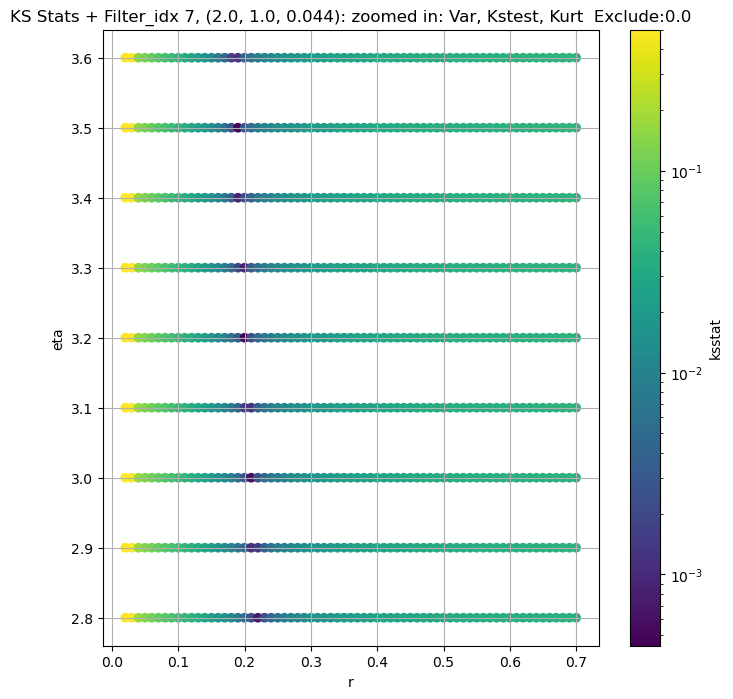

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 8, 0.0 + 100 = 100, ksstat: 0.0027118544263204335, var: 24.778076171875


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 8, 0.0 + 75 = 75, ksstat: 0.0022387879117522665, var: 25.080230712890625


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 8, 0.0 + 50 = 50, ksstat: 0.0017265465312170866, var: 25.41895866394043


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 8, 0.0 + 25 = 25, ksstat: 0.0011692539037826757, var: 25.818527221679688


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 8, 0.0 + 0 = 0, ksstat: 0.00047189852162910634, var: 26.441059112548828
Number of samples: 100000, Without approximation : 16384000.0


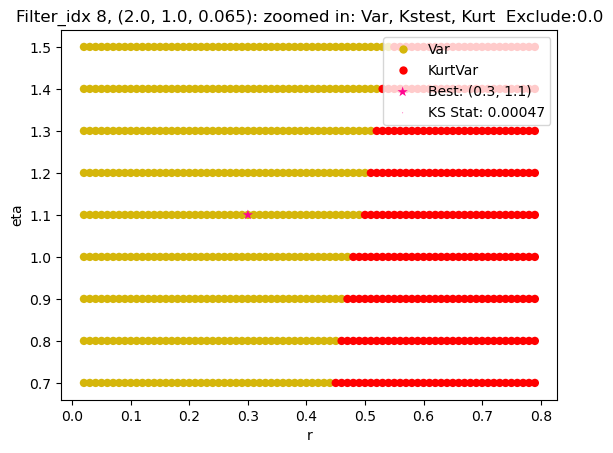

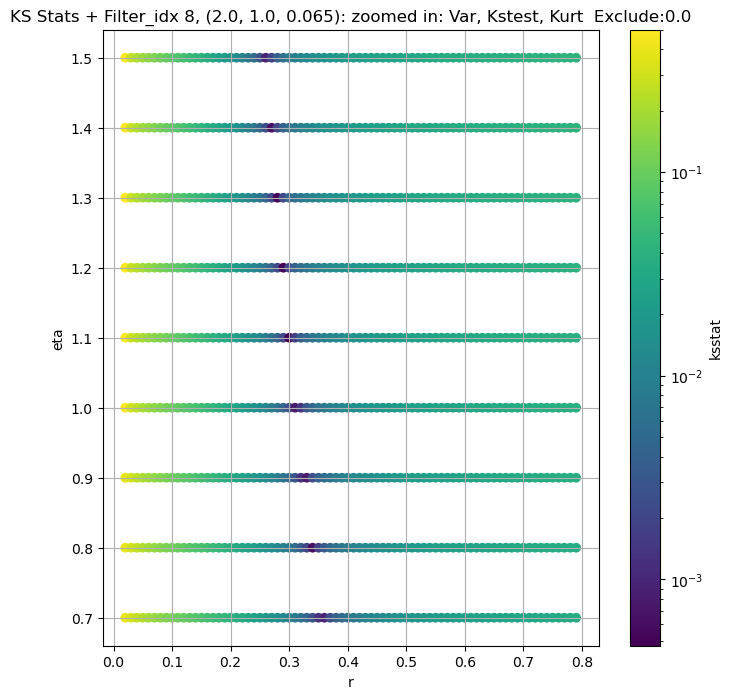

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 100 = 100, ksstat: 0.0028691197361514695, var: 9.1226224899292


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 75 = 75, ksstat: 0.002319896193112826, var: 9.247150421142578


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 50 = 50, ksstat: 0.0017088688907998043, var: 9.389365196228027


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 25 = 25, ksstat: 0.0009917256409374478, var: 9.561271667480469


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 9, 0.0 + 0 = 0, ksstat: 0.0002559687808232902, var: 9.860672950744629
Number of samples: 100000, Without approximation : 16384000.0


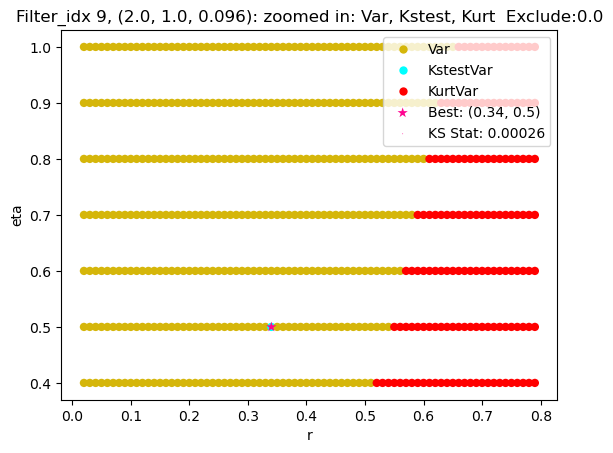

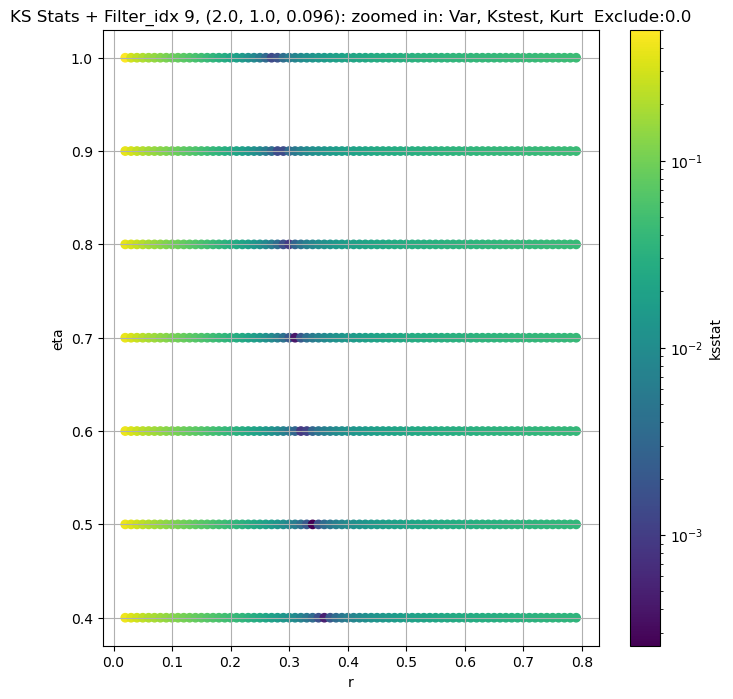

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.00232067993704399, var: 3.6397833824157715


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.0019204969151619677, var: 3.6921958923339844


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.0015030855605189242, var: 3.7520363330841064


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.0011408663824631349, var: 3.8245534896850586


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.0006245448454655633, var: 3.9511799812316895
Number of samples: 100000, Without approximation : 16384000.0


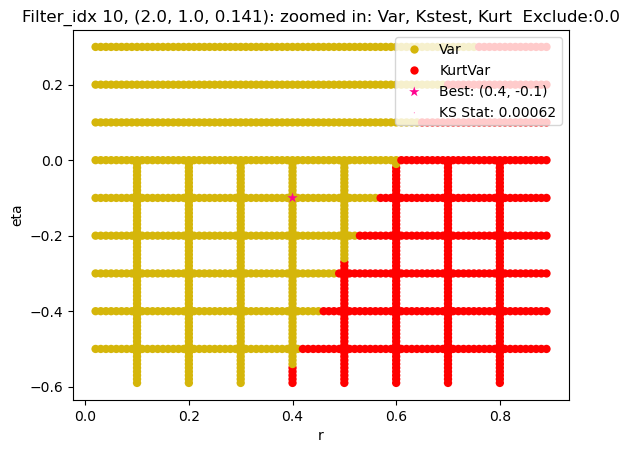

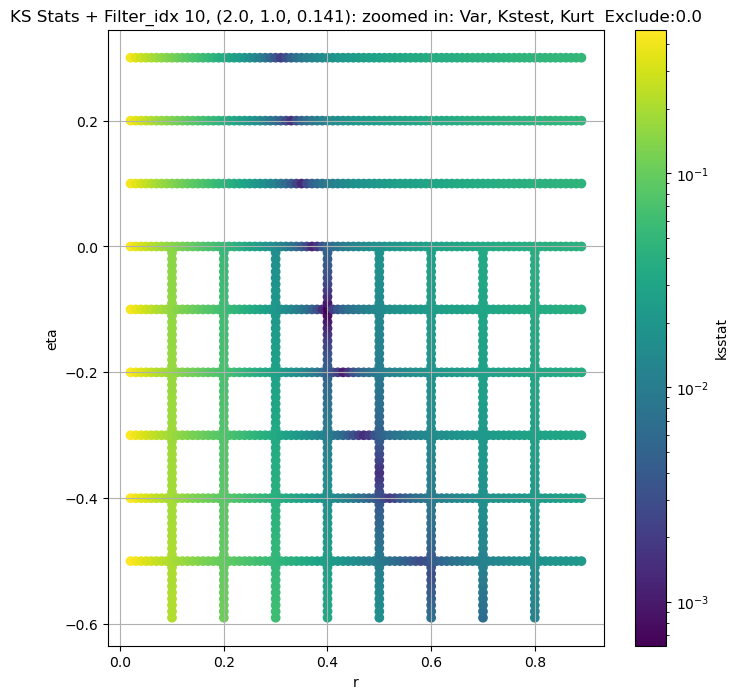

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.0031288846993435745, var: 1.3626972436904907


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.002513930499108863, var: 1.3852688074111938


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.002163527755758461, var: 1.4112271070480347


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.0017695274390289173, var: 1.4430161714553833


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.0017547897473434437, var: 1.4988174438476562
Number of samples: 100000, Without approximation : 16384000.0


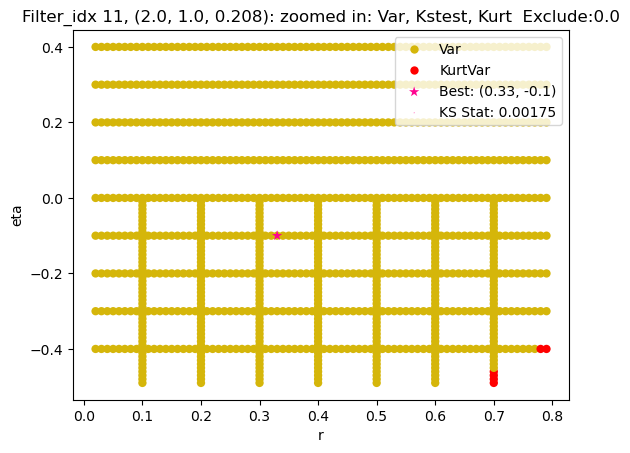

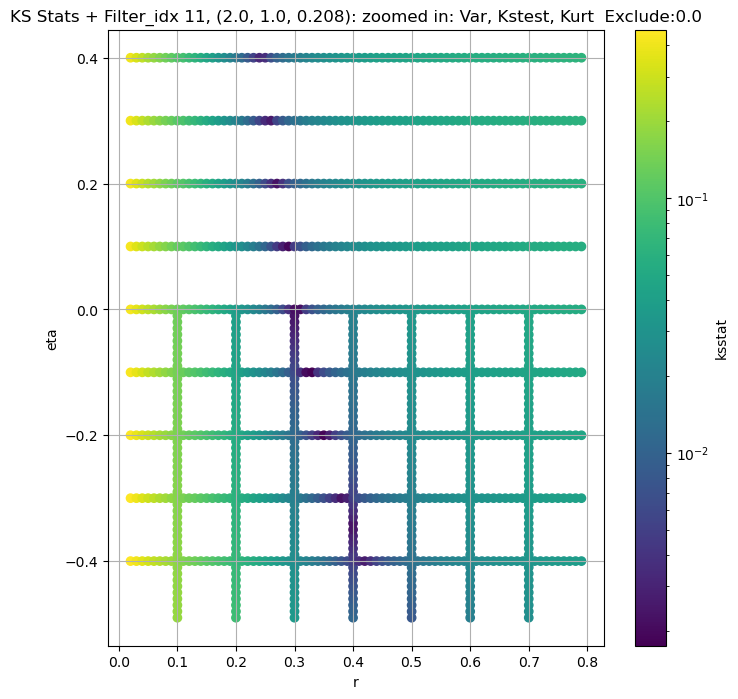

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.0035159796888810865, var: 0.41917356848716736


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.0033050661873507137, var: 0.42690160870552063


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.0026556086815625046, var: 0.43592706322669983


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.002635257703245575, var: 0.4472494423389435


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.0019832556873655566, var: 0.46910780668258667
Number of samples: 100000, Without approximation : 16384000.0


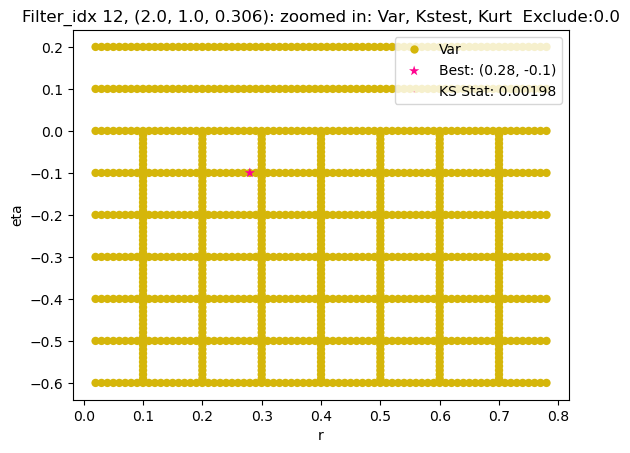

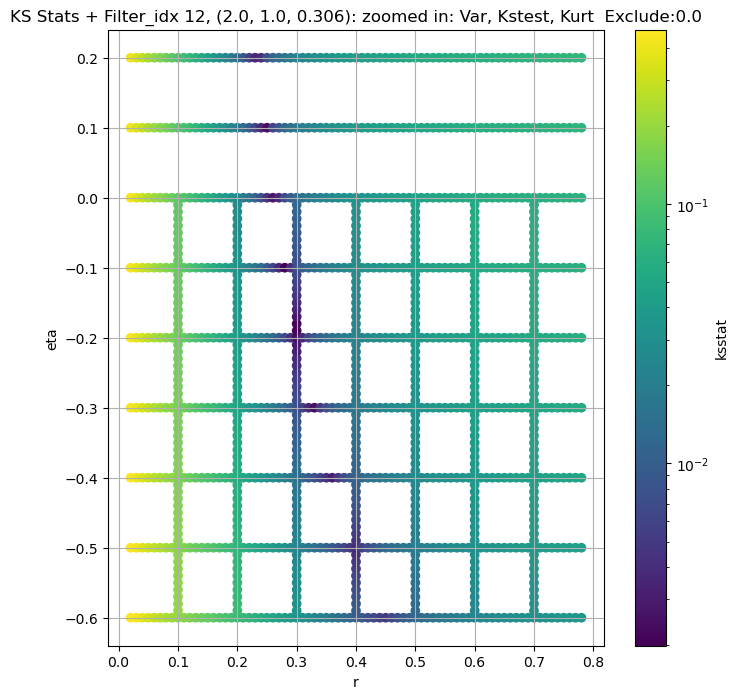

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 100 = 100, ksstat: 0.006634115288119413, var: 0.14186781644821167


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 75 = 75, ksstat: 0.006083542428202193, var: 0.14495451748371124


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 50 = 50, ksstat: 0.005306979426214942, var: 0.14862442016601562


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 25 = 25, ksstat: 0.004430855459496515, var: 0.15336565673351288


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 0.0 + 0 = 0, ksstat: 0.003287068886944411, var: 0.16340677440166473
Number of samples: 100000, Without approximation : 16384000.0


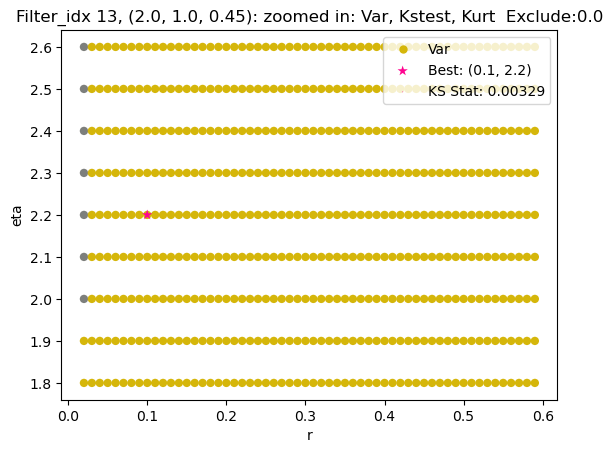

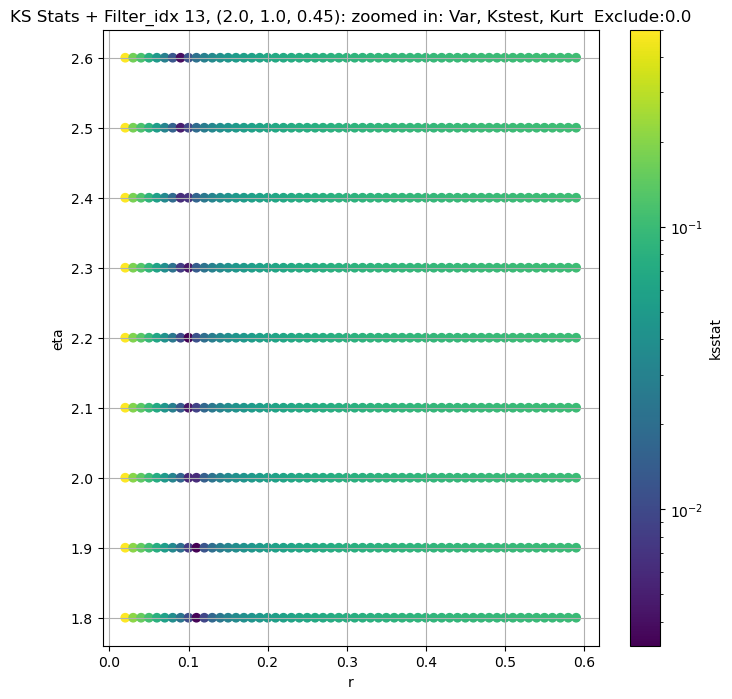

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/792 [00:00<?, ?it/s]

Finding Minimum after computing 792 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.002522262438887257, var: 43.62882614135742


  0%|          | 0/792 [00:00<?, ?it/s]

Finding Minimum after computing 792 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.002042325319765226, var: 44.14837646484375


  0%|          | 0/792 [00:00<?, ?it/s]

Finding Minimum after computing 792 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.0015575375226143384, var: 44.73093032836914


  0%|          | 0/792 [00:00<?, ?it/s]

Finding Minimum after computing 792 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.0010786387658967937, var: 45.41840744018555


  0%|          | 0/792 [00:00<?, ?it/s]

Finding Minimum after computing 792 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.0004948877667447921, var: 46.457271575927734
Number of samples: 100000, Without approximation : 16384000.0


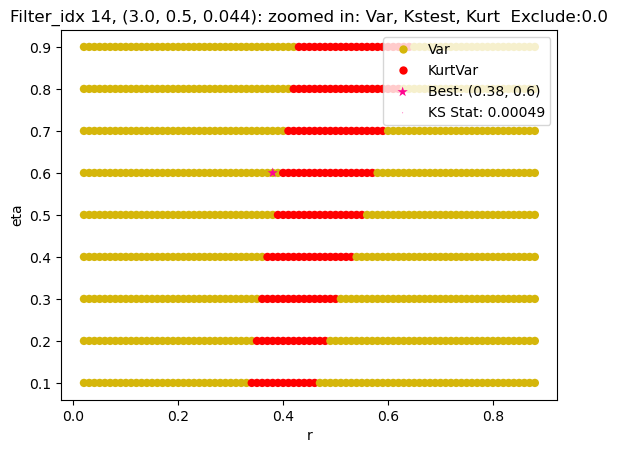

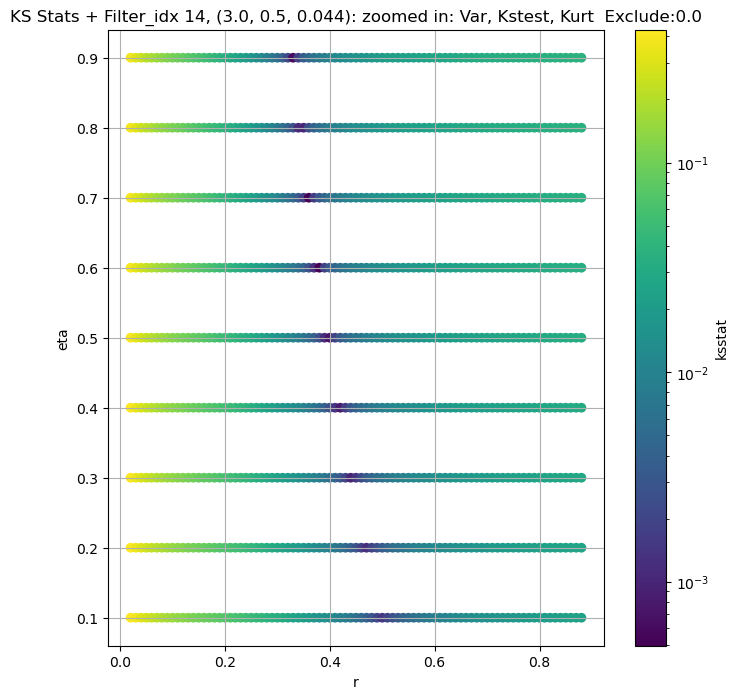

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 15, 50.0 + 100 = 150, ksstat: 0.002992906790603933, var: 16.481767654418945


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 15, 50.0 + 75 = 125, ksstat: 0.002640990128880305, var: 16.665836334228516


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 15, 50.0 + 50 = 100, ksstat: 0.002262367003442036, var: 16.86501693725586


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 15, 50.0 + 25 = 75, ksstat: 0.001863585101897547, var: 17.083593368530273


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 15, 50.0 + 0 = 50, ksstat: 0.0014756729906609811, var: 17.329641342163086


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 15, 50.0 + -25 = 25, ksstat: 0.0009853515724205439, var: 17.62356185913086


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 15, 50.0 + -50 = 0, ksstat: 0.0006325161402984947, var: 18.09298324584961
Number of samples: 100000, Without approximation : 16384000.0


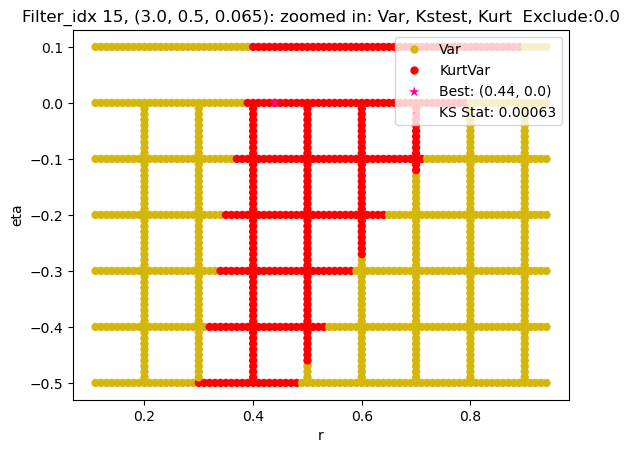

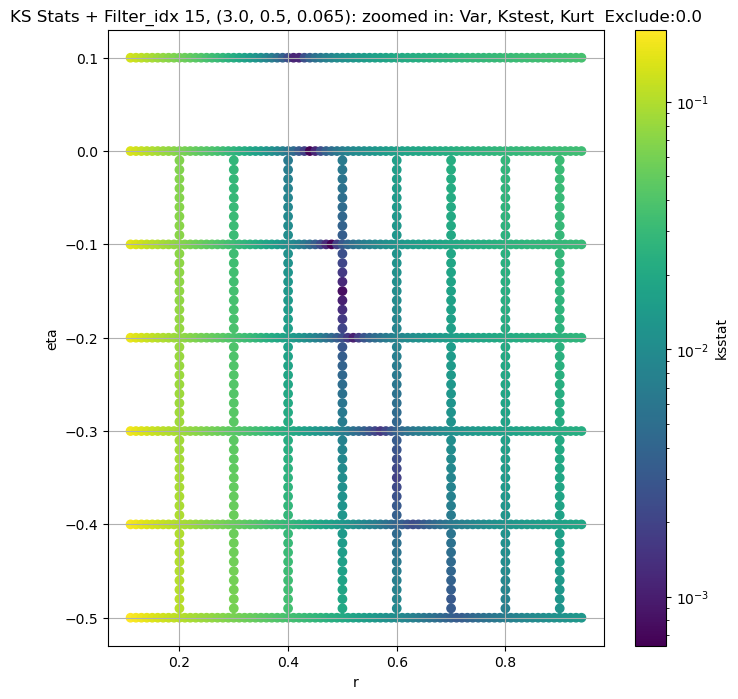

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 16, 0.0 + 100 = 100, ksstat: 0.002610925627845276, var: 6.418325901031494


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 16, 0.0 + 75 = 75, ksstat: 0.002042850812142505, var: 6.506535530090332


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 16, 0.0 + 50 = 50, ksstat: 0.0016558059733482455, var: 6.606777191162109


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 16, 0.0 + 25 = 25, ksstat: 0.001432314064614637, var: 6.7274956703186035


  0%|          | 0/1224 [00:00<?, ?it/s]

Finding Minimum after computing 1224 CDFs
filter_idx 16, 0.0 + 0 = 0, ksstat: 0.0011193348808405112, var: 6.934680461883545
Number of samples: 100000, Without approximation : 16384000.0


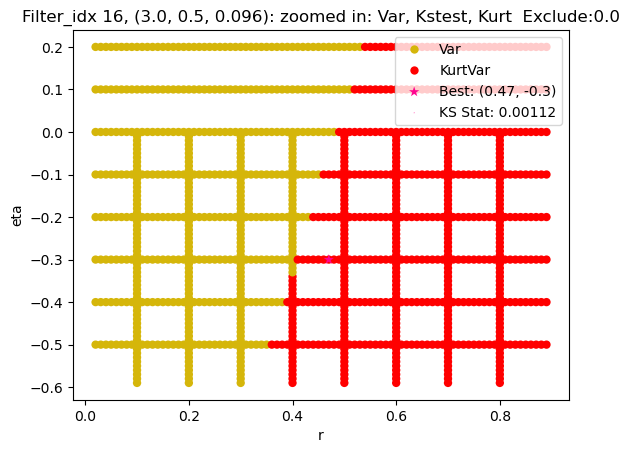

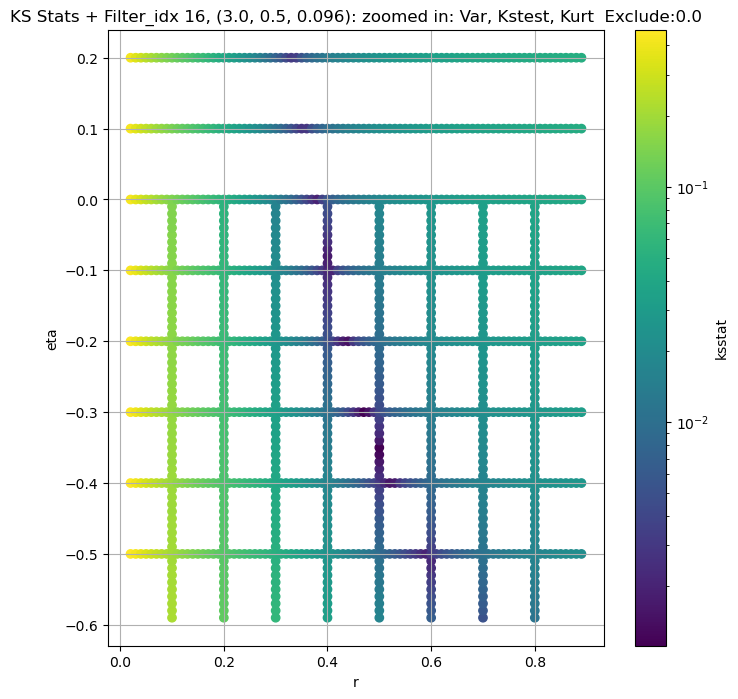

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.0032332725177650623, var: 2.429619789123535


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.002683360961768355, var: 2.466705799102783


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.0025691747922497177, var: 2.5090909004211426


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.0020249745918232698, var: 2.5604403018951416


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.001953241530342653, var: 2.6495521068573
Number of samples: 100000, Without approximation : 16384000.0


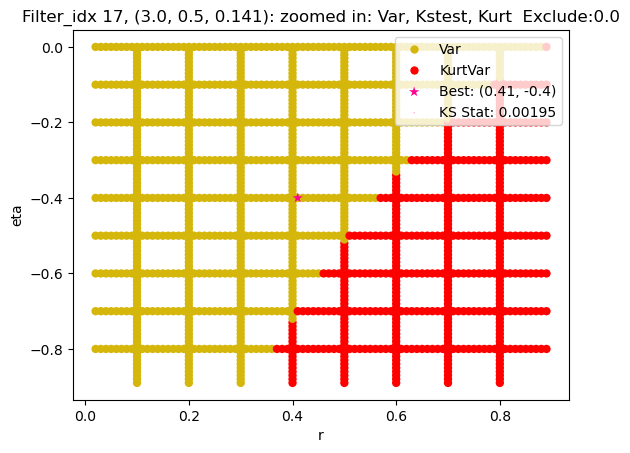

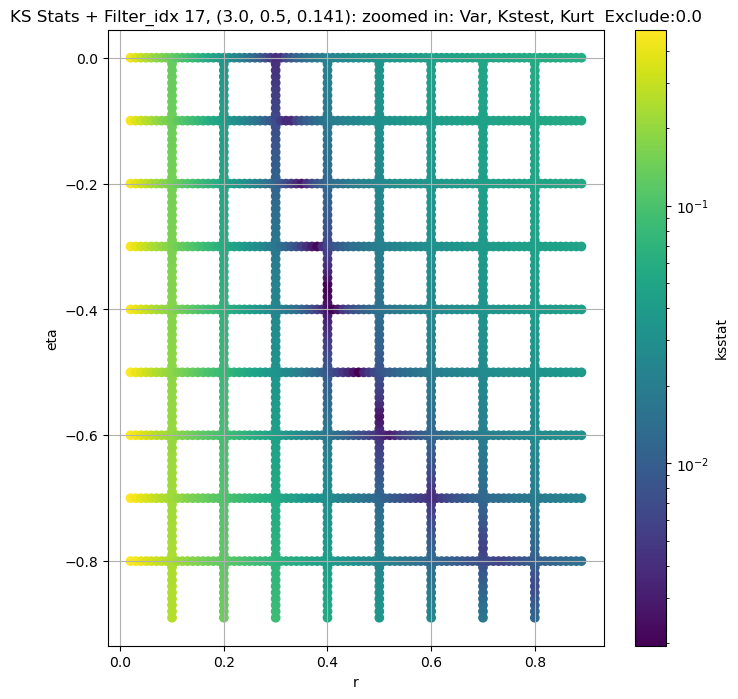

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 0.0 + 100 = 100, ksstat: 0.0043700733120379115, var: 0.8663467764854431


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 0.0 + 75 = 75, ksstat: 0.004512334661630035, var: 0.8815520405769348


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 0.0 + 50 = 50, ksstat: 0.004041317840536893, var: 0.8990437388420105


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 0.0 + 25 = 25, ksstat: 0.0035872181422613725, var: 0.9205093383789062


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 18, 0.0 + 0 = 0, ksstat: 0.003202435378621804, var: 0.9603564143180847
Number of samples: 100000, Without approximation : 16384000.0


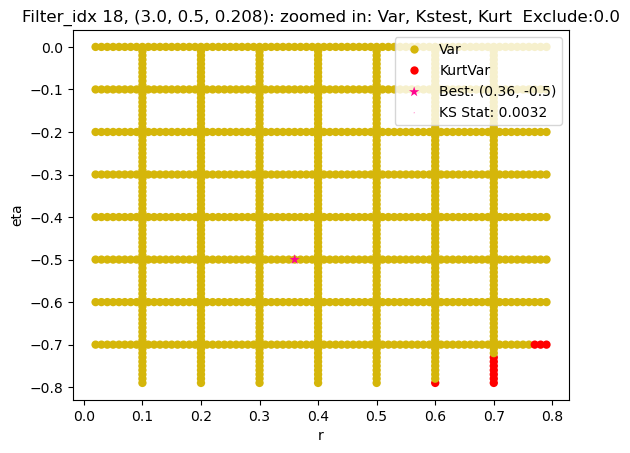

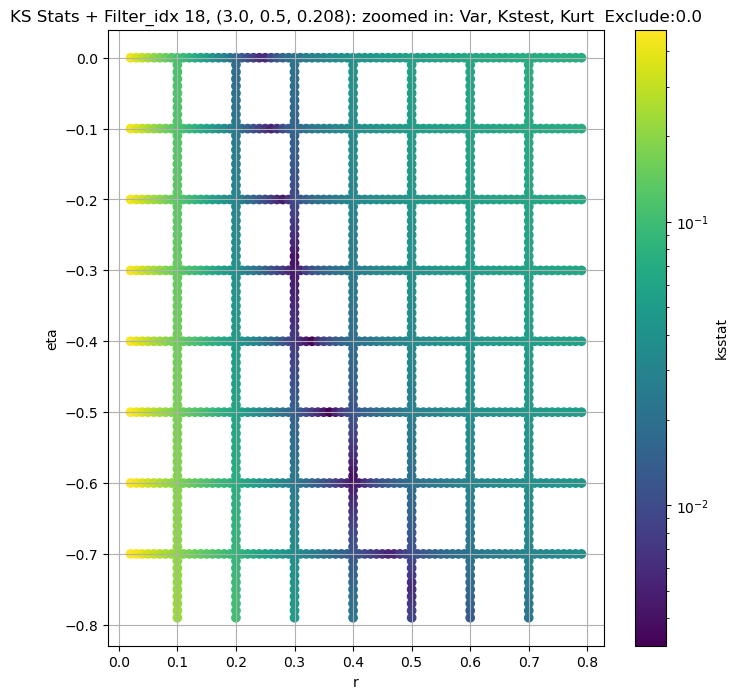

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.005737508739482089, var: 0.24771174788475037


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.005158013518943738, var: 0.2527587115764618


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.004474448351470803, var: 0.2586324214935303


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.004558614600884539, var: 0.26596832275390625


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.0036829895105787713, var: 0.2797289788722992
Number of samples: 100000, Without approximation : 16384000.0


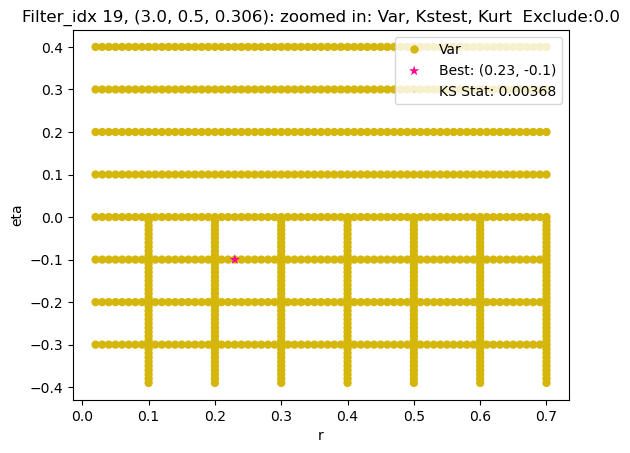

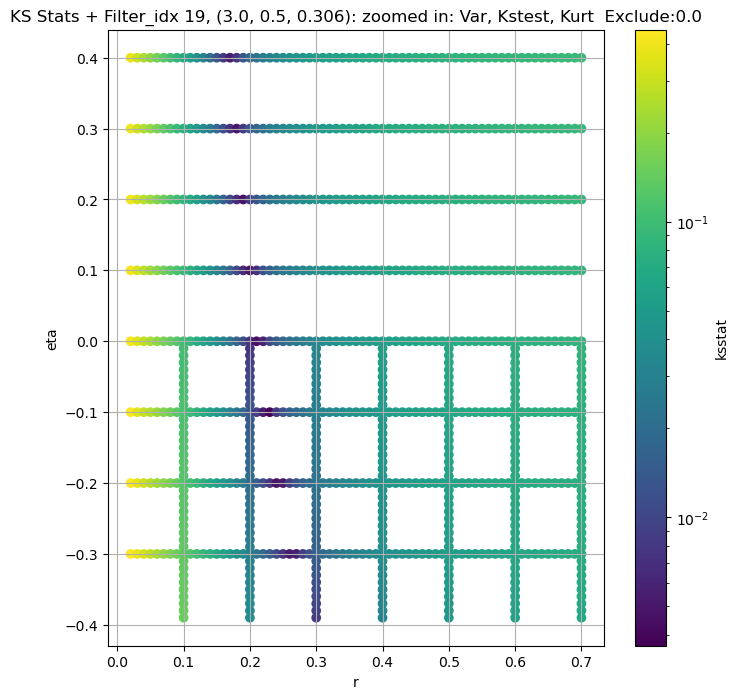

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.005792412518378476, var: 0.07114863395690918


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.005300492630390563, var: 0.07287876307964325


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.004699669188602984, var: 0.07494349032640457


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.0039444914568512734, var: 0.07760009169578552


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.003618771570161994, var: 0.08314990997314453
Number of samples: 100000, Without approximation : 16384000.0


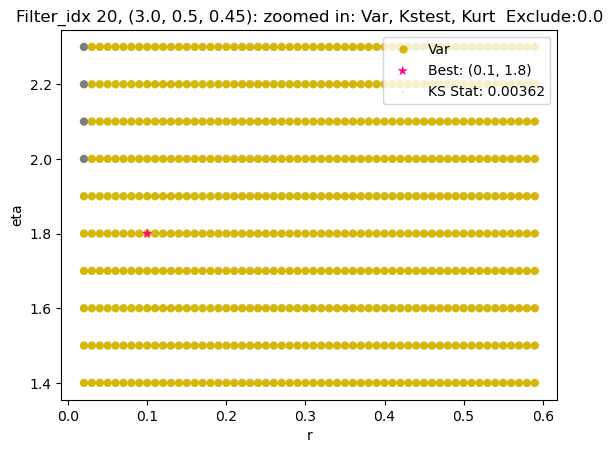

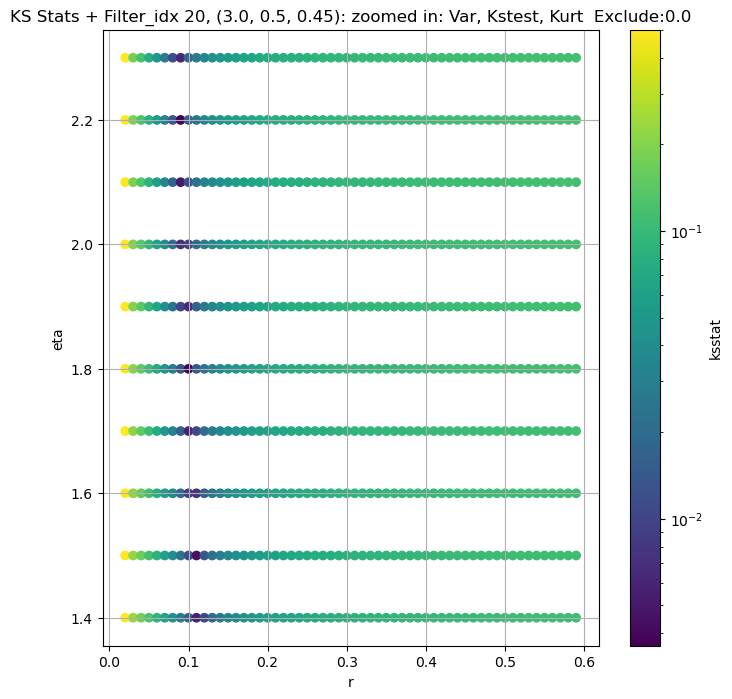

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 21, 0.0 + 100 = 100, ksstat: 0.0026768138179607964, var: 50.566654205322266


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 21, 0.0 + 75 = 75, ksstat: 0.0021689938059322733, var: 51.220176696777344


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 21, 0.0 + 50 = 50, ksstat: 0.0016128656922781426, var: 51.9610710144043


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 21, 0.0 + 25 = 25, ksstat: 0.0009727182949578125, var: 52.844512939453125


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 21, 0.0 + 0 = 0, ksstat: 0.000810570772575292, var: 54.27345657348633
Number of samples: 100000, Without approximation : 16384000.0


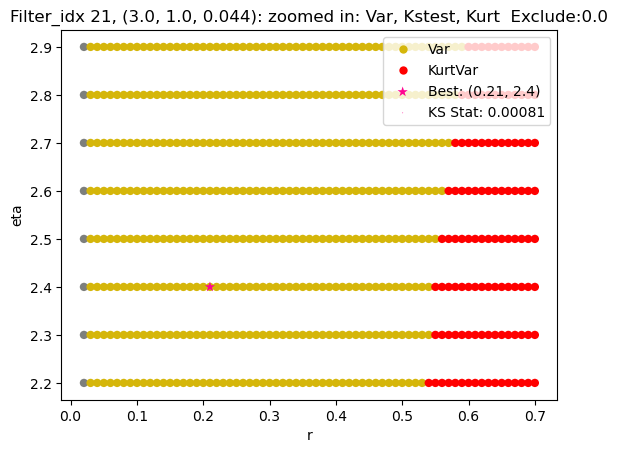

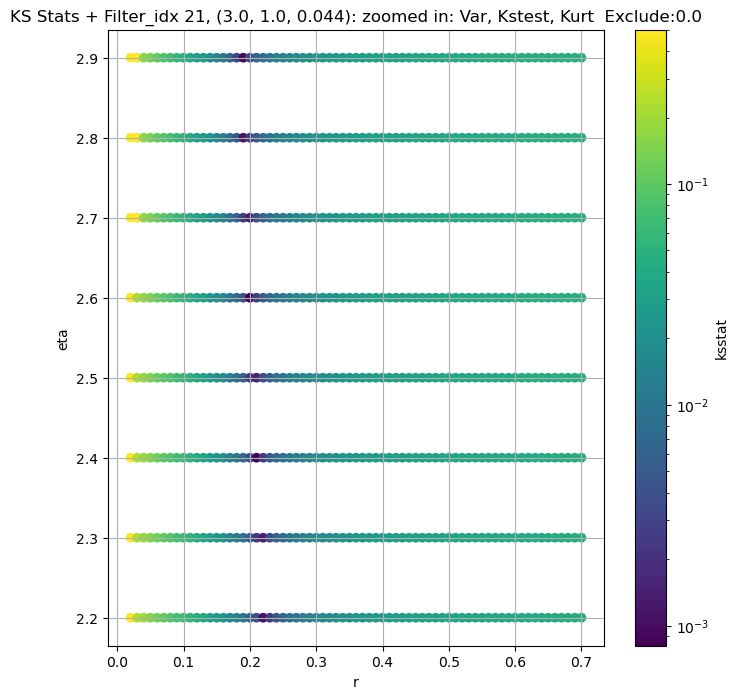

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.00301157304586349, var: 19.525772094726562


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.0024698537945770926, var: 19.784643173217773


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.0020226080350505132, var: 20.07784080505371


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.0012935956614265054, var: 20.430931091308594


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.0005200940027849654, var: 21.02007293701172
Number of samples: 100000, Without approximation : 16384000.0


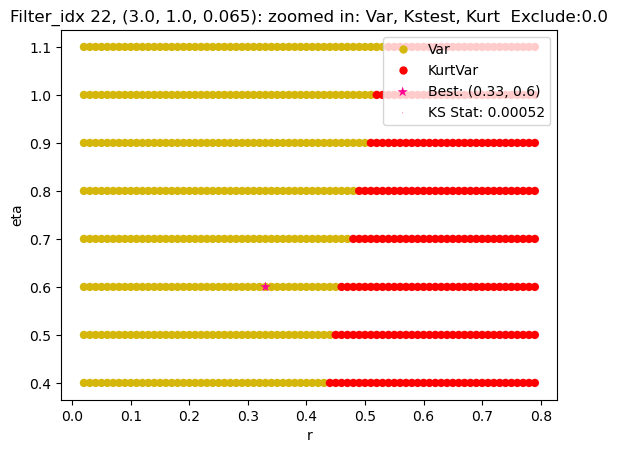

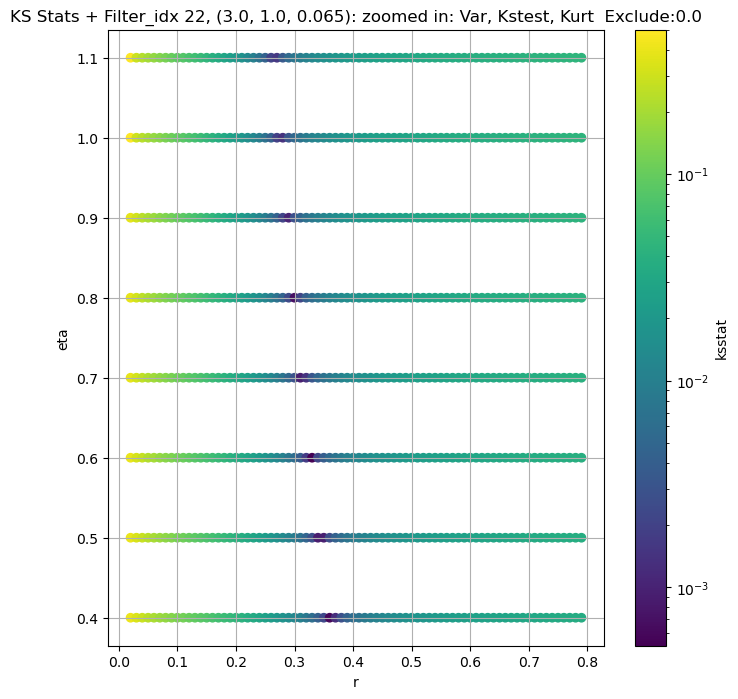

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 23, 50.0 + 100 = 150, ksstat: 0.0030532752863170476, var: 7.358154296875


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 23, 50.0 + 75 = 125, ksstat: 0.00273496625401546, var: 7.451962471008301


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 23, 50.0 + 50 = 100, ksstat: 0.002352581262620612, var: 7.554210186004639


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 23, 50.0 + 25 = 75, ksstat: 0.001912447971287503, var: 7.667728900909424


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 23, 50.0 + 0 = 50, ksstat: 0.0014620443103466607, var: 7.797941207885742


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 23, 50.0 + -25 = 25, ksstat: 0.001113180845617845, var: 7.95709753036499


  0%|          | 0/1530 [00:00<?, ?it/s]

Finding Minimum after computing 1530 CDFs
filter_idx 23, 50.0 + -50 = 0, ksstat: 0.0006617721215691486, var: 8.22708797454834
Number of samples: 100000, Without approximation : 16384000.0


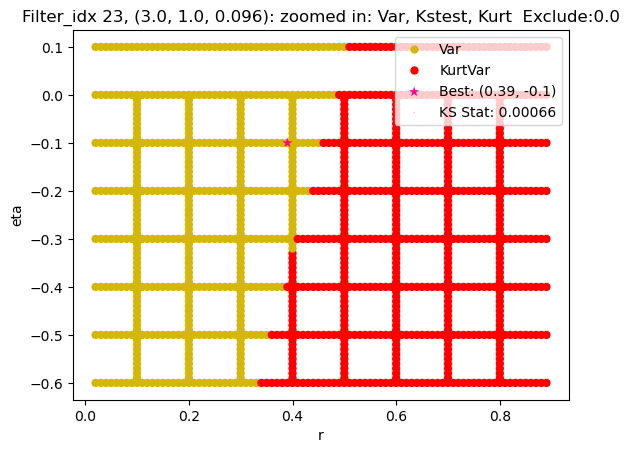

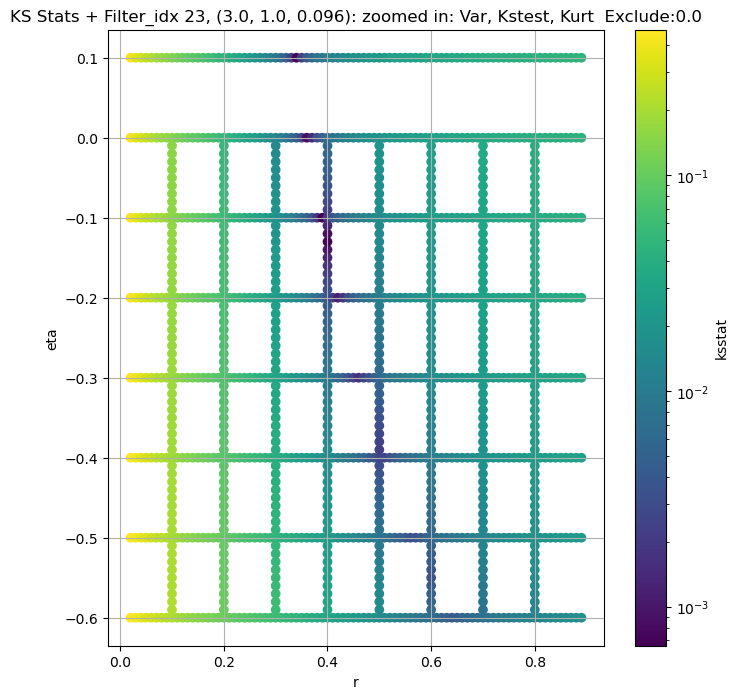

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.0033171744395276634, var: 2.797365427017212


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.003097782899357915, var: 2.8429274559020996


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.002692755919273093, var: 2.8949971199035645


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.001963186666494497, var: 2.958134889602661


  0%|          | 0/1017 [00:00<?, ?it/s]

Finding Minimum after computing 1017 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.0013783378251185363, var: 3.0656561851501465
Number of samples: 100000, Without approximation : 16384000.0


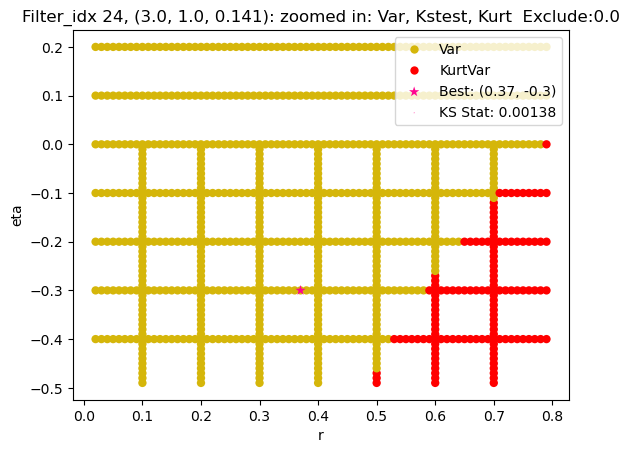

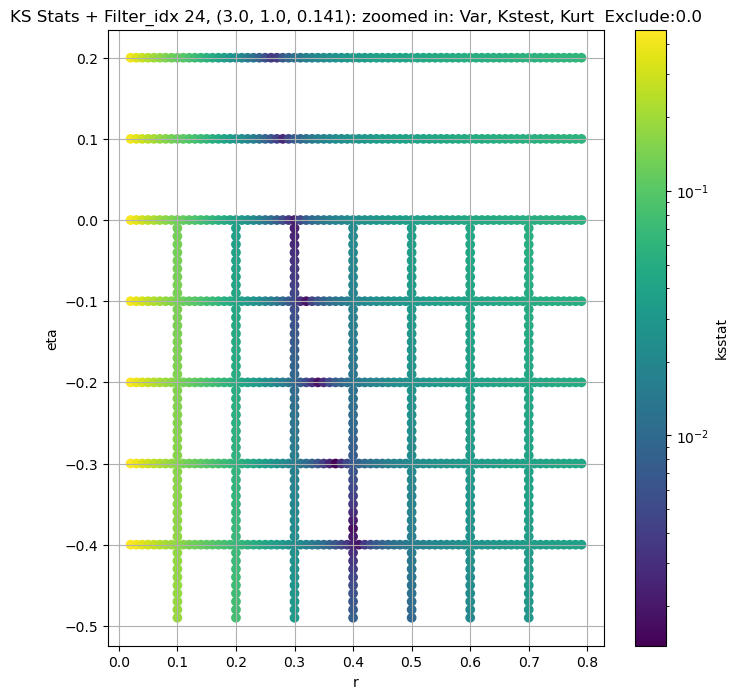

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 25, 0.0 + 100 = 100, ksstat: 0.003911933043805042, var: 1.0109244585037231


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 25, 0.0 + 75 = 75, ksstat: 0.0036563482618293328, var: 1.0298681259155273


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 25, 0.0 + 50 = 50, ksstat: 0.003389627366441217, var: 1.051760196685791


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 25, 0.0 + 25 = 25, ksstat: 0.0032174959231734412, var: 1.0788875818252563


  0%|          | 0/1206 [00:00<?, ?it/s]

Finding Minimum after computing 1206 CDFs
filter_idx 25, 0.0 + 0 = 0, ksstat: 0.002564865627676771, var: 1.1325455904006958
Number of samples: 100000, Without approximation : 16384000.0


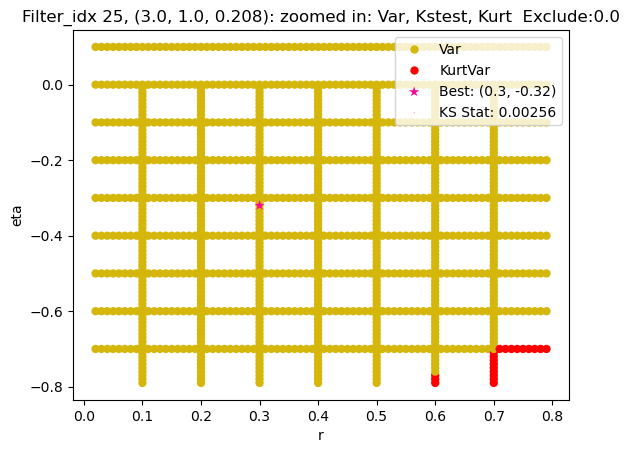

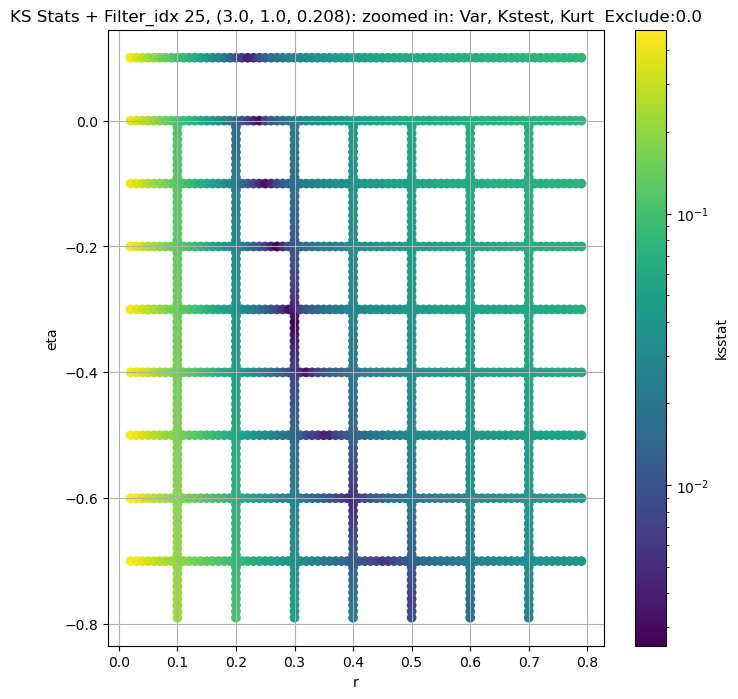

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.004936558653818923, var: 0.3260466158390045


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.004366534777181186, var: 0.33294859528541565


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.004485491729231128, var: 0.3410133123397827


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.0038667983432839614, var: 0.3511365056037903


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.0035225668854269587, var: 0.37004274129867554
Number of samples: 100000, Without approximation : 16384000.0


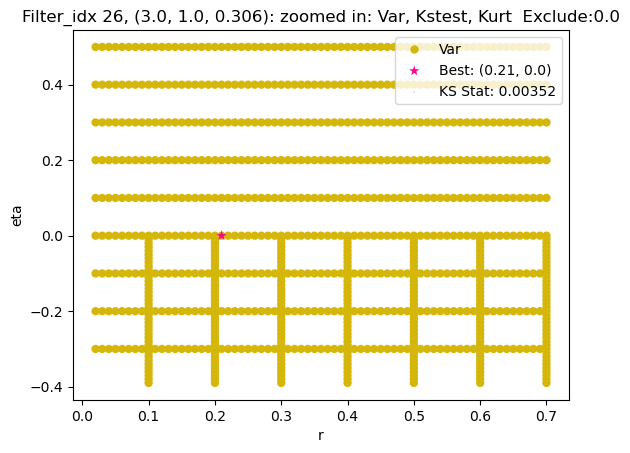

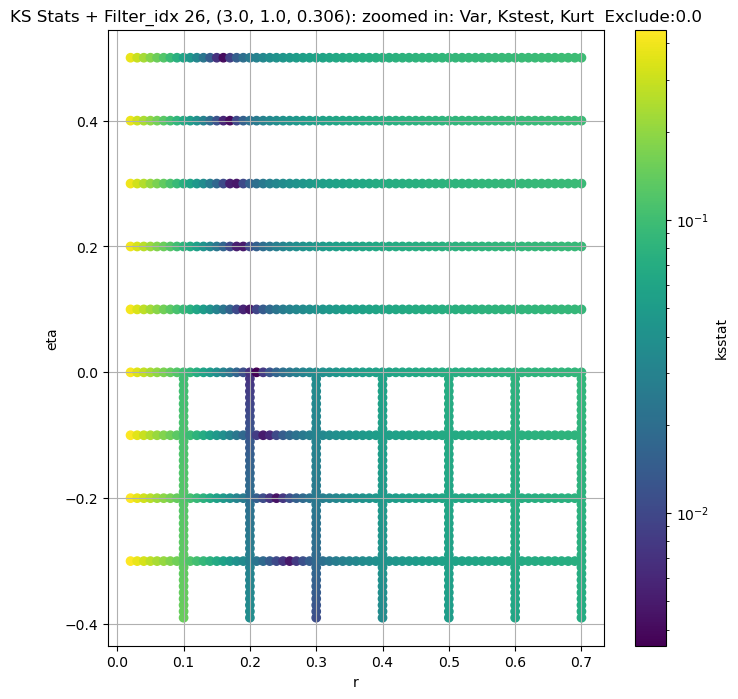

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 100 = 150, ksstat: 0.006629001998605499, var: 0.07452916353940964


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 75 = 125, ksstat: 0.0062794668496585215, var: 0.07610997557640076


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 50 = 100, ksstat: 0.0054462277723329455, var: 0.07787171751260757


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 25 = 75, ksstat: 0.005038582940084968, var: 0.07988430559635162


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + 0 = 50, ksstat: 0.004412135810581322, var: 0.08228808641433716


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + -25 = 25, ksstat: 0.004160306958499171, var: 0.08543378859758377


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 27, 50.0 + -50 = 0, ksstat: 0.005399127280751037, var: 0.09274154156446457
Number of samples: 100000, Without approximation : 16384000.0


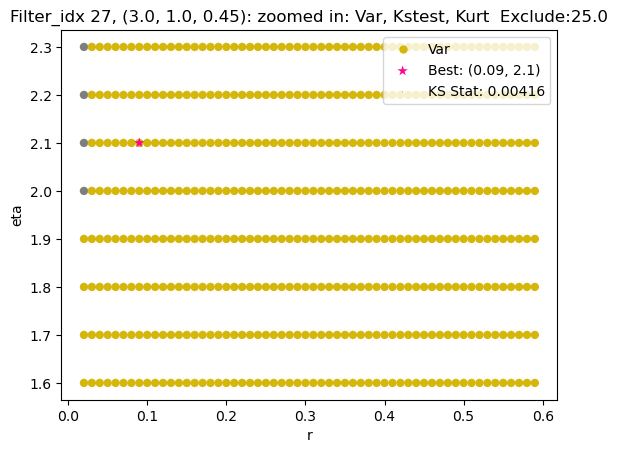

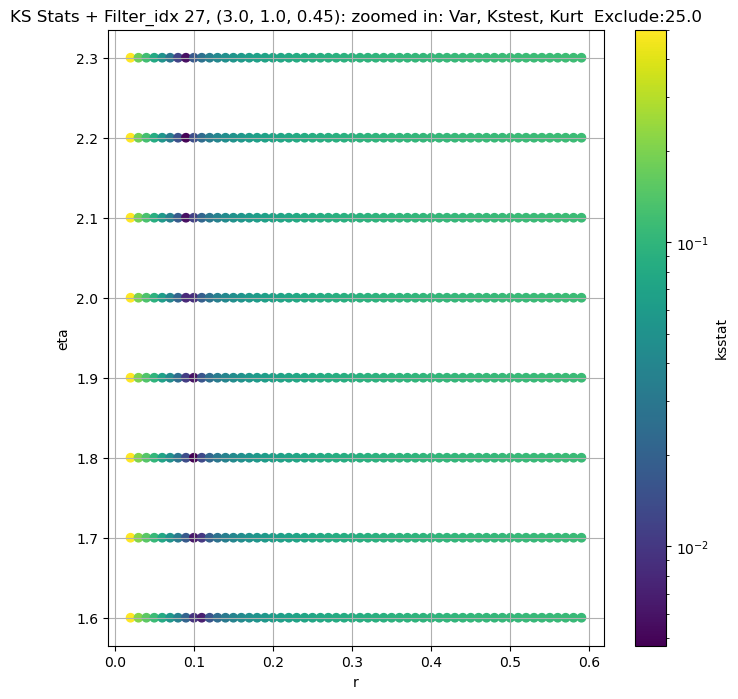

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.0027676140129726523, var: 42.31117630004883


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.0022759064669383156, var: 42.8146858215332


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.0017466978208947152, var: 43.381622314453125


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.0011362160846729585, var: 44.060935974121094


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0006198272770029378, var: 45.146366119384766
Number of samples: 100000, Without approximation : 16384000.0


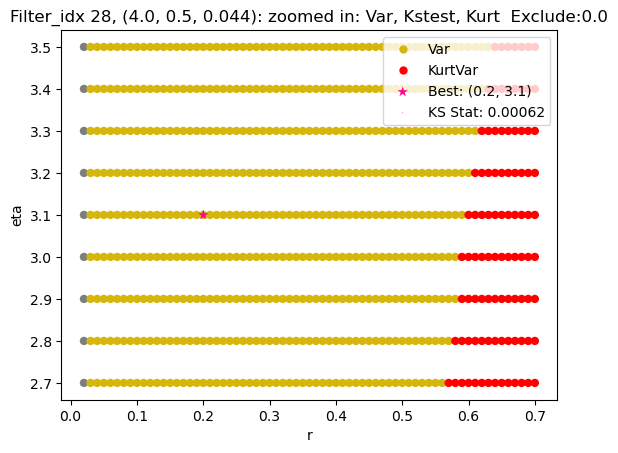

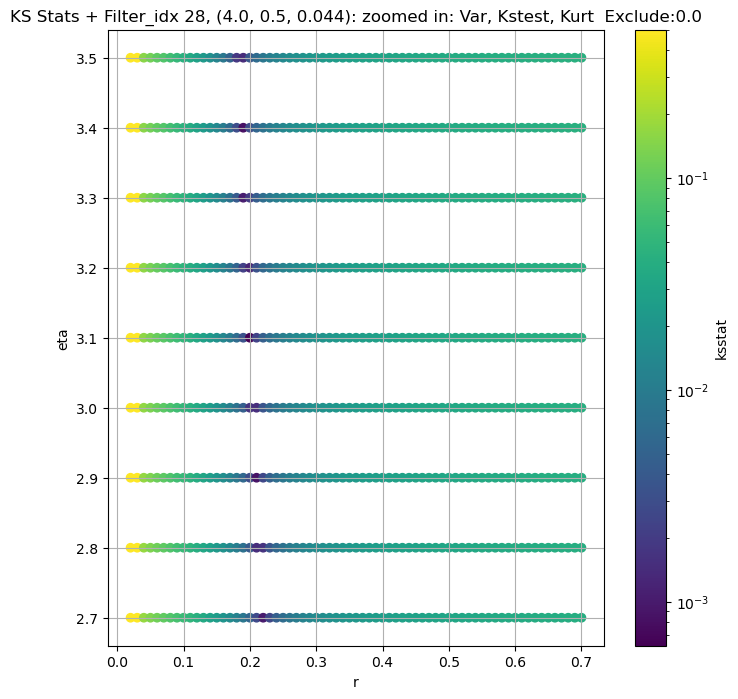

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 100 = 100, ksstat: 0.0027963135519363247, var: 16.556001663208008


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 75 = 75, ksstat: 0.0022630510734550427, var: 16.76142692565918


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 50 = 50, ksstat: 0.0016673393534571493, var: 16.993423461914062


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 25 = 25, ksstat: 0.0010502796893134825, var: 17.268186569213867


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 29, 0.0 + 0 = 0, ksstat: 0.0005290147924651989, var: 17.704641342163086
Number of samples: 100000, Without approximation : 16384000.0


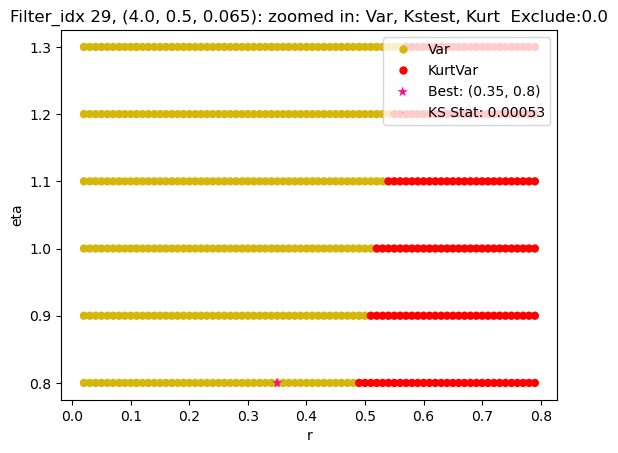

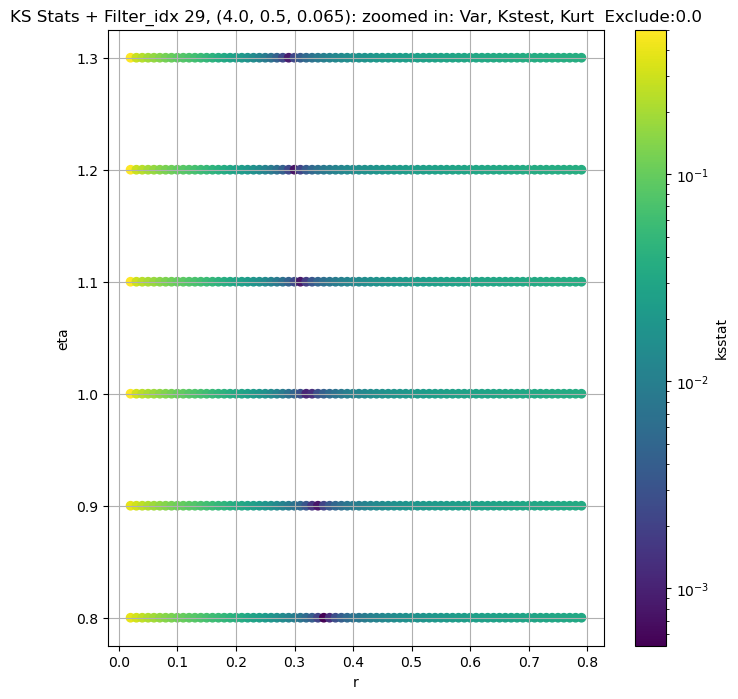

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 30, 50.0 + 100 = 150, ksstat: 0.002808930369925959, var: 5.920783519744873


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 30, 50.0 + 75 = 125, ksstat: 0.00243708346800664, var: 5.988081455230713


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 30, 50.0 + 50 = 100, ksstat: 0.0020396156983450986, var: 6.061339378356934


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 30, 50.0 + 25 = 75, ksstat: 0.0016432610117392416, var: 6.142499923706055


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 30, 50.0 + 0 = 50, ksstat: 0.0012188191056910908, var: 6.234902381896973


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 30, 50.0 + -25 = 25, ksstat: 0.0007232759709742131, var: 6.346893310546875


  0%|          | 0/1539 [00:00<?, ?it/s]

Finding Minimum after computing 1539 CDFs
filter_idx 30, 50.0 + -50 = 0, ksstat: 0.0005257799529259088, var: 6.537875175476074
Number of samples: 100000, Without approximation : 16384000.0


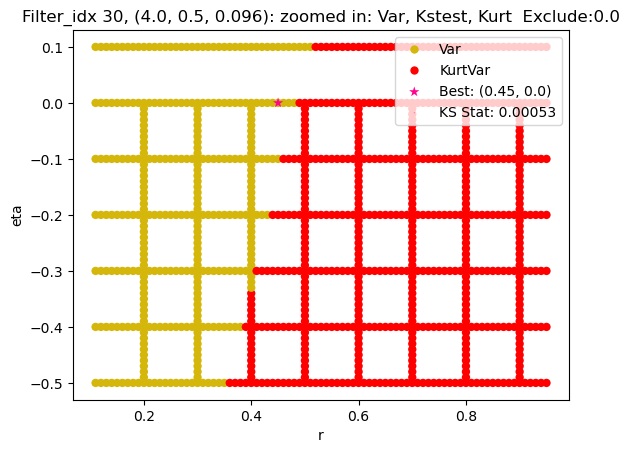

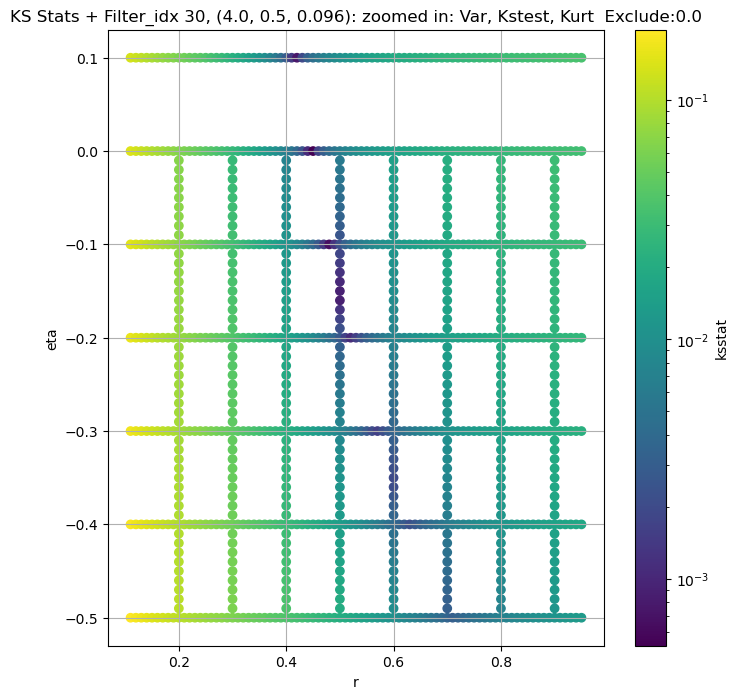

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.0031331390957261007, var: 2.2858197689056396


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.002885407308831911, var: 2.315009355545044


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.0024621256683370896, var: 2.3467531204223633


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.0020321584273829685, var: 2.3818700313568115


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.0017683537533900173, var: 2.421947956085205


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.0013487100182693057, var: 2.4703242778778076


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.0009454138082749808, var: 2.5577077865600586
Number of samples: 100000, Without approximation : 16384000.0


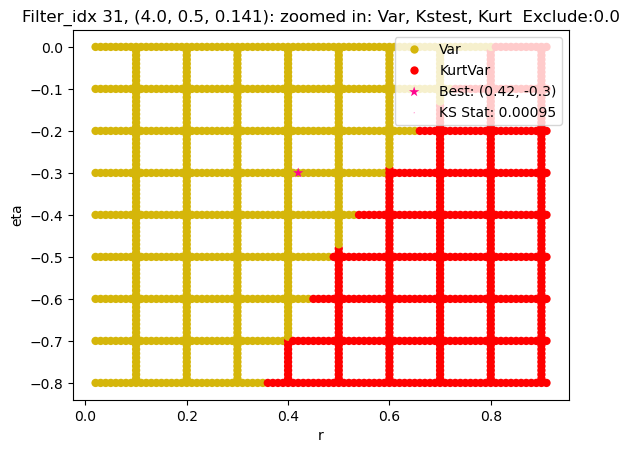

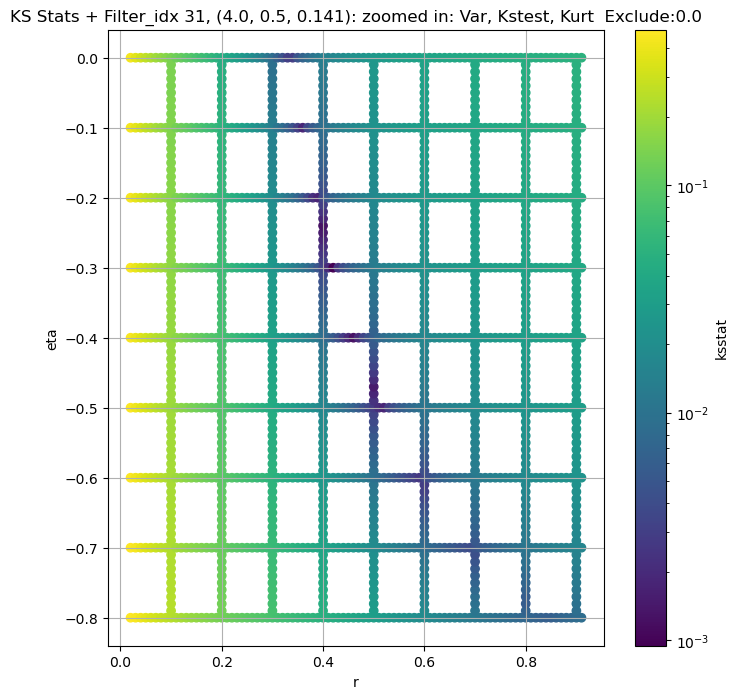

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 32, 0.0 + 100 = 100, ksstat: 0.0035849797748778167, var: 0.8266632556915283


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 32, 0.0 + 75 = 75, ksstat: 0.002932931373723871, var: 0.8410242199897766


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 32, 0.0 + 50 = 50, ksstat: 0.002891306022202833, var: 0.8576107621192932


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 32, 0.0 + 25 = 25, ksstat: 0.0026290139933190515, var: 0.8780251741409302


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 32, 0.0 + 0 = 0, ksstat: 0.0020089270718760543, var: 0.916842520236969
Number of samples: 100000, Without approximation : 16384000.0


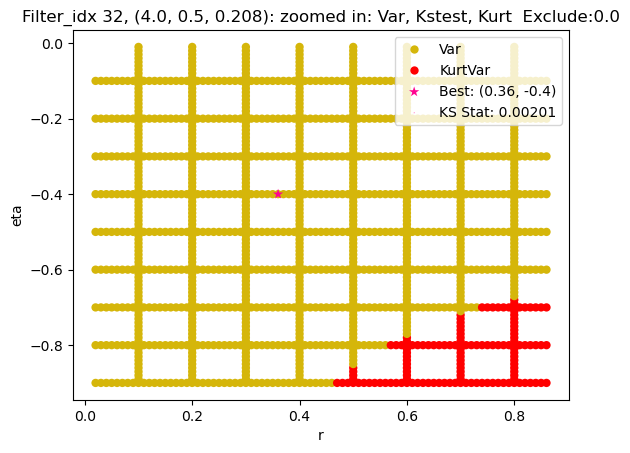

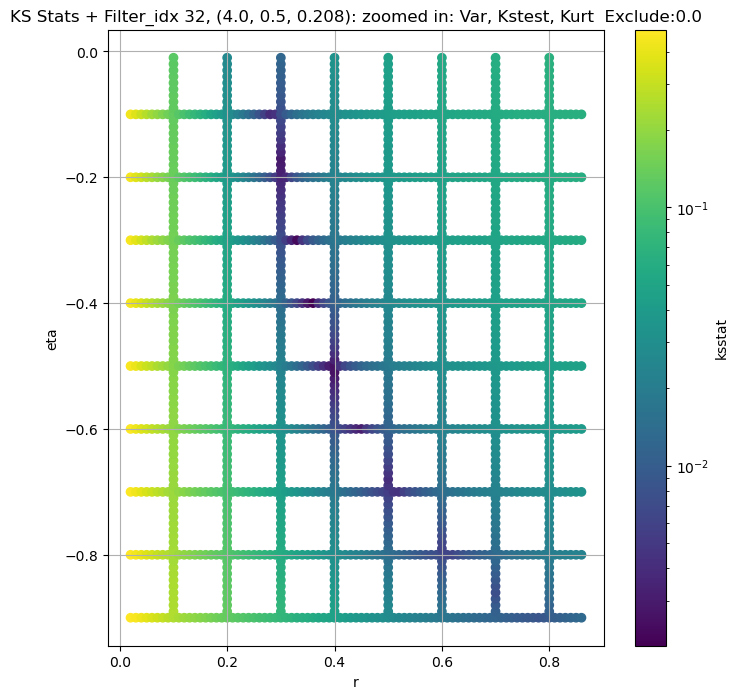

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.004983631478765238, var: 0.24045602977275848


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.004343980854793372, var: 0.24538913369178772


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.003777304841536655, var: 0.2511330544948578


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.003390252669618926, var: 0.25831225514411926


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.0034021109726463106, var: 0.2717694640159607
Number of samples: 100000, Without approximation : 16384000.0


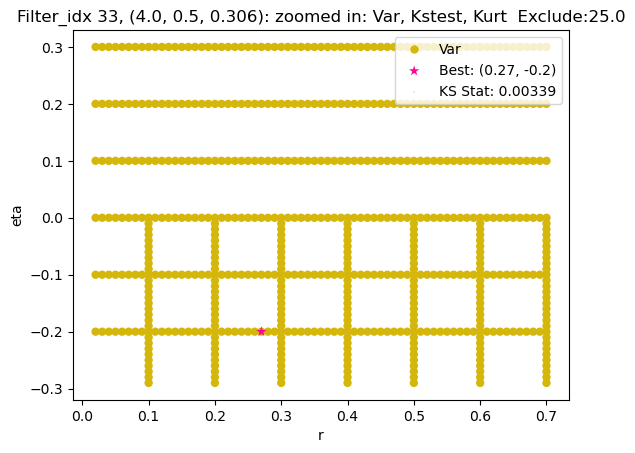

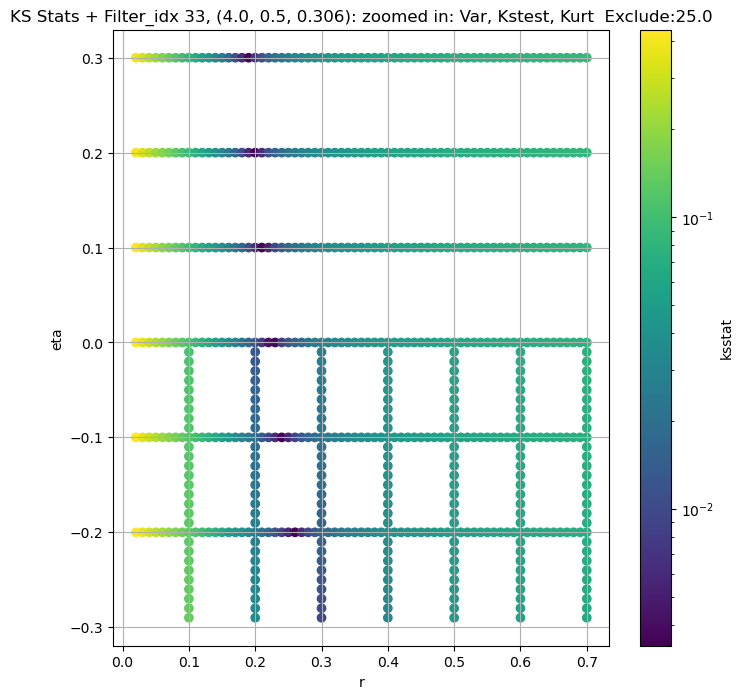

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 100 = 150, ksstat: 0.005914976170262043, var: 0.05230505019426346


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 75 = 125, ksstat: 0.005422404009240878, var: 0.05334168300032616


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 50 = 100, ksstat: 0.004913787524367441, var: 0.054498087614774704


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 25 = 75, ksstat: 0.004338934551302048, var: 0.055820077657699585


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + 0 = 50, ksstat: 0.003654713553666325, var: 0.05739804357290268


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + -25 = 25, ksstat: 0.0036656726348474056, var: 0.059435442090034485


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 50.0 + -50 = 0, ksstat: 0.004788106150151128, var: 0.06385216116905212
Number of samples: 100000, Without approximation : 16384000.0


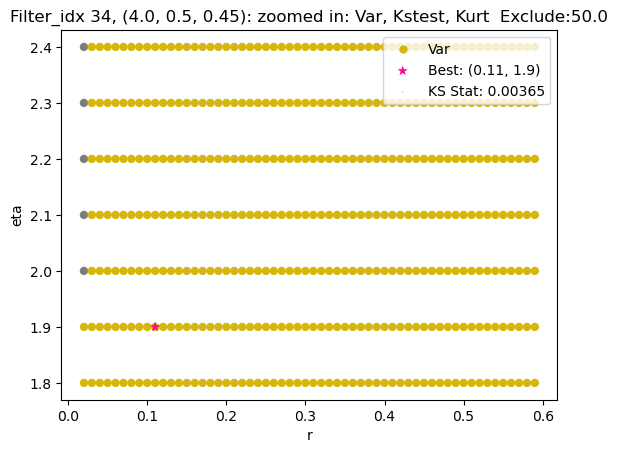

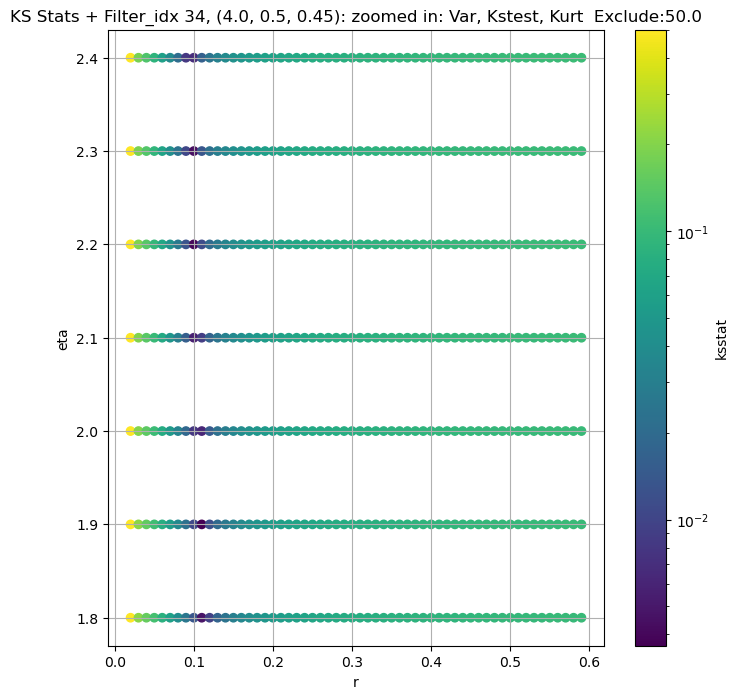

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 35, 0.0 + 100 = 100, ksstat: 0.0029358715995958656, var: 43.608917236328125


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 35, 0.0 + 75 = 75, ksstat: 0.0024684537460065645, var: 44.09105682373047


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 35, 0.0 + 50 = 50, ksstat: 0.0019058129356516115, var: 44.6312255859375


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 35, 0.0 + 25 = 25, ksstat: 0.0012697122588697374, var: 45.267662048339844


  0%|          | 0/780 [00:00<?, ?it/s]

Finding Minimum after computing 780 CDFs
filter_idx 35, 0.0 + 0 = 0, ksstat: 0.00040269778246495094, var: 46.211063385009766
Number of samples: 100000, Without approximation : 16384000.0


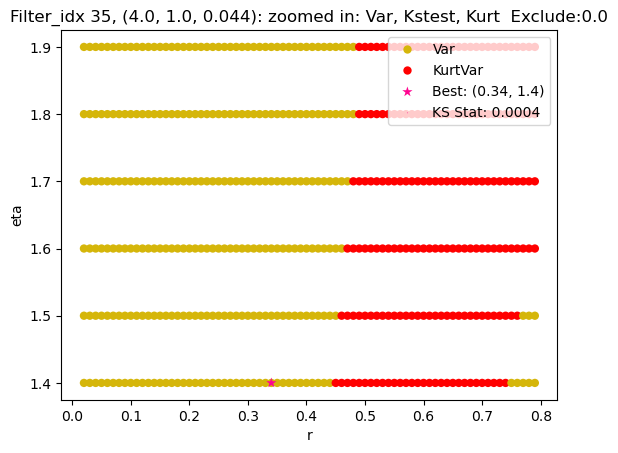

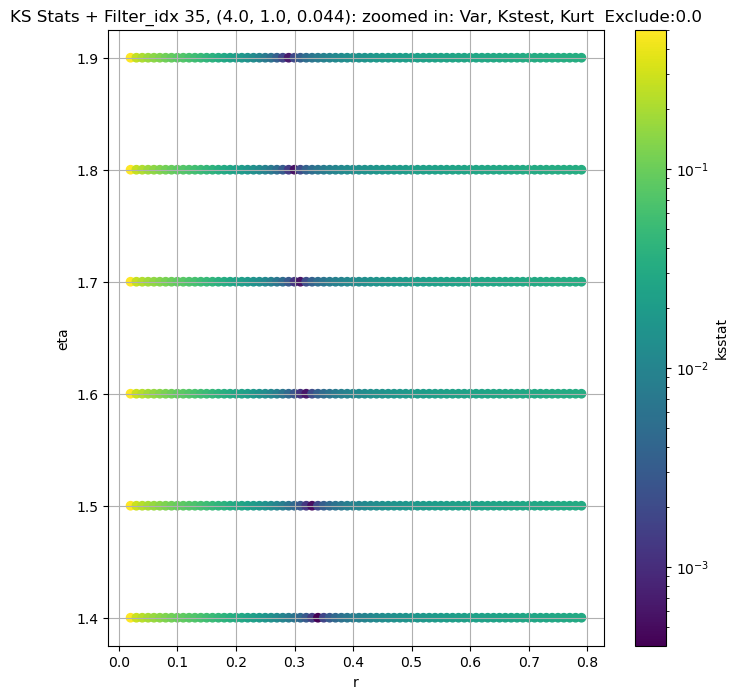

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.0024984932109662975, var: 17.9840087890625


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.001933129244061041, var: 18.215421676635742


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.001405459961268847, var: 18.47991180419922


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.0006443308133729682, var: 18.804468154907227


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.0005905104437199382, var: 19.419679641723633
Number of samples: 100000, Without approximation : 16384000.0


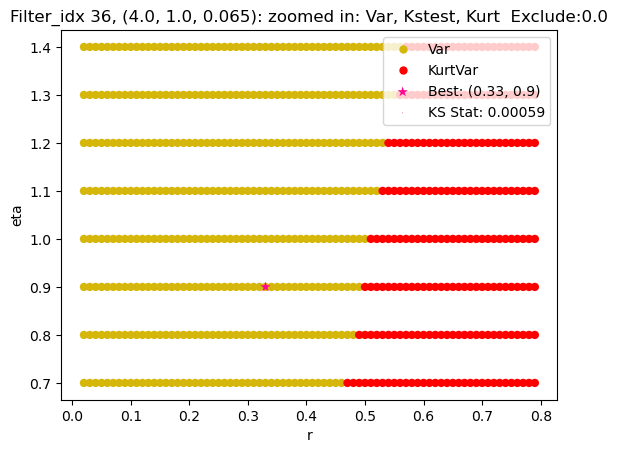

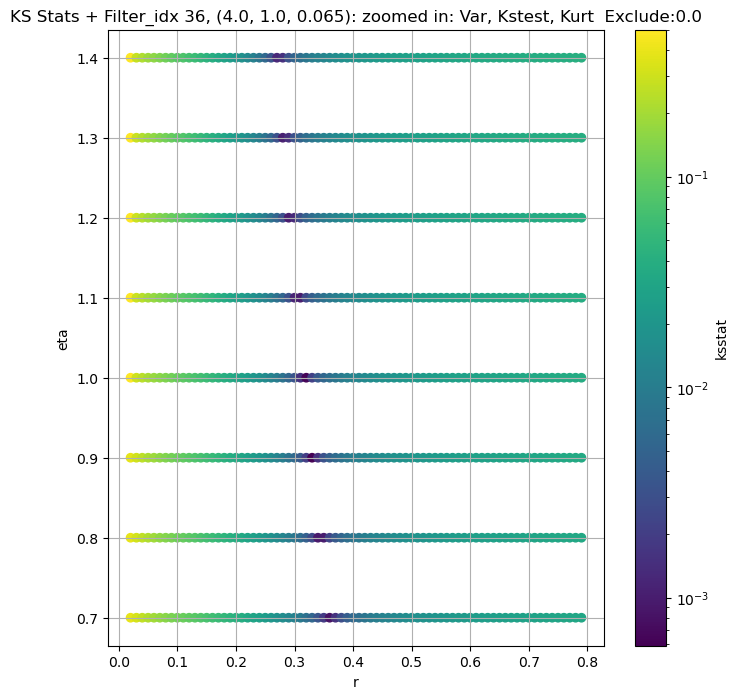

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.0022959163117390047, var: 6.45565128326416


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.0017886062588425844, var: 6.5457963943481445


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.0013575403887921, var: 6.648098945617676


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.0009858112305013433, var: 6.77176570892334


  0%|          | 0/1080 [00:00<?, ?it/s]

Finding Minimum after computing 1080 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.0005875643869660552, var: 6.9876322746276855
Number of samples: 100000, Without approximation : 16384000.0


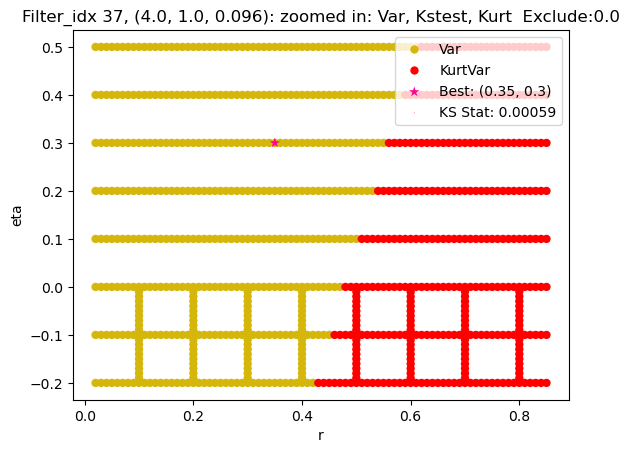

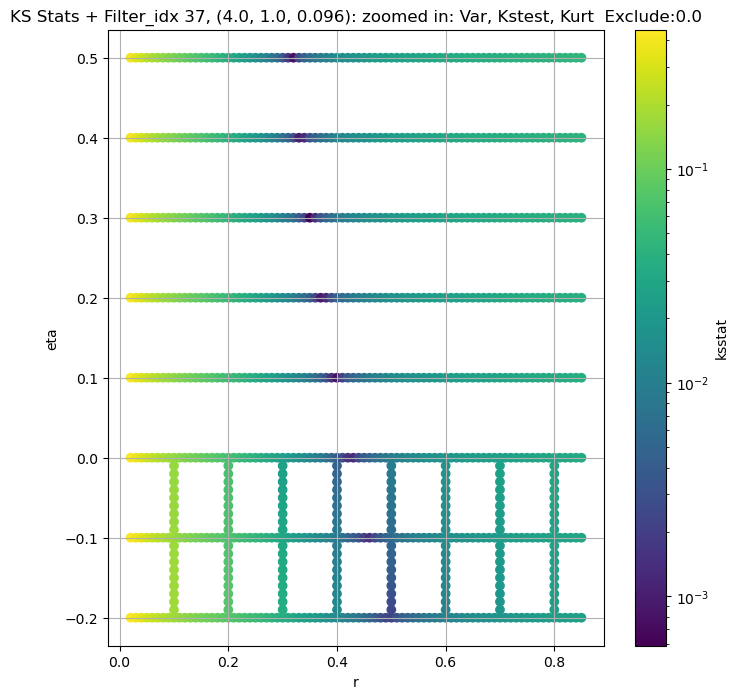

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 38, 50.0 + 100 = 150, ksstat: 0.003115541024718914, var: 2.459733009338379


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 38, 50.0 + 75 = 125, ksstat: 0.0027991792625129026, var: 2.491807460784912


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 38, 50.0 + 50 = 100, ksstat: 0.002372488873100379, var: 2.526811361312866


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 38, 50.0 + 25 = 75, ksstat: 0.0019927899538387042, var: 2.5657827854156494


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 38, 50.0 + 0 = 50, ksstat: 0.0017894539526857947, var: 2.610469102859497


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 38, 50.0 + -25 = 25, ksstat: 0.0014774133760687702, var: 2.664890766143799


  0%|          | 0/1611 [00:00<?, ?it/s]

Finding Minimum after computing 1611 CDFs
filter_idx 38, 50.0 + -50 = 0, ksstat: 0.0008046074899161759, var: 2.7629268169403076
Number of samples: 100000, Without approximation : 16384000.0


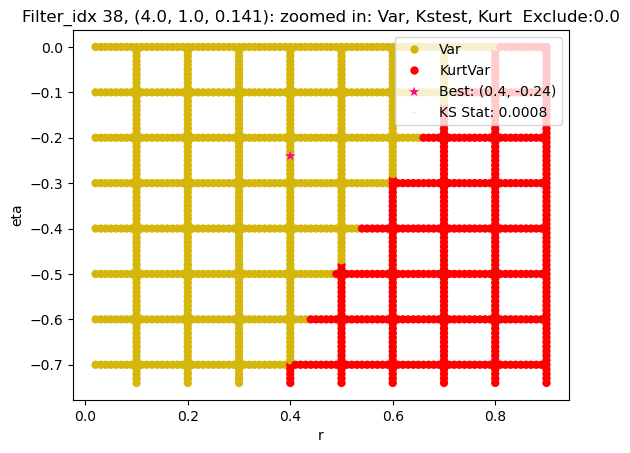

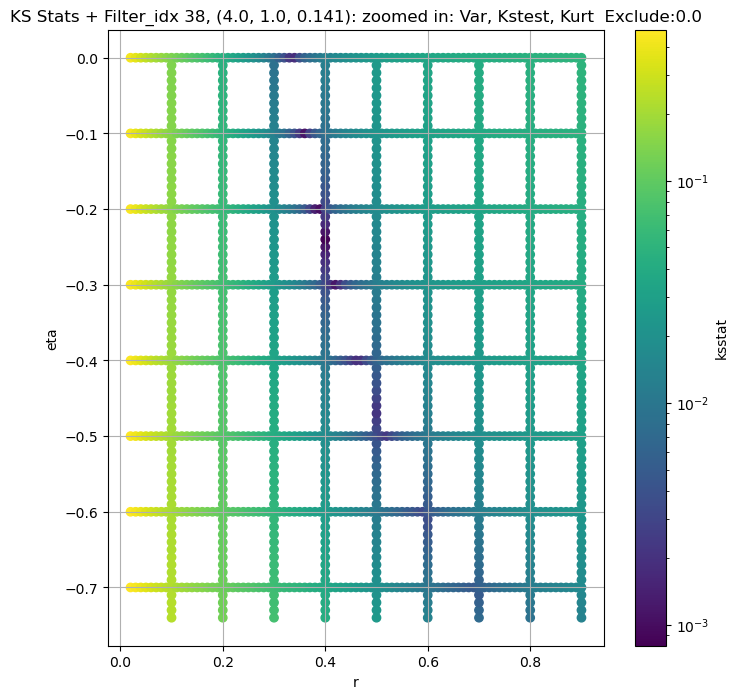

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 39, 0.0 + 100 = 100, ksstat: 0.003283446347331298, var: 0.9118015170097351


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 39, 0.0 + 75 = 75, ksstat: 0.0030481143398115584, var: 0.9285220503807068


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 39, 0.0 + 50 = 50, ksstat: 0.002429788942203276, var: 0.9478490948677063


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 39, 0.0 + 25 = 25, ksstat: 0.0026379878860224304, var: 0.9717207551002502


  0%|          | 0/1221 [00:00<?, ?it/s]

Finding Minimum after computing 1221 CDFs
filter_idx 39, 0.0 + 0 = 0, ksstat: 0.001668364024045188, var: 1.0155822038650513
Number of samples: 100000, Without approximation : 16384000.0


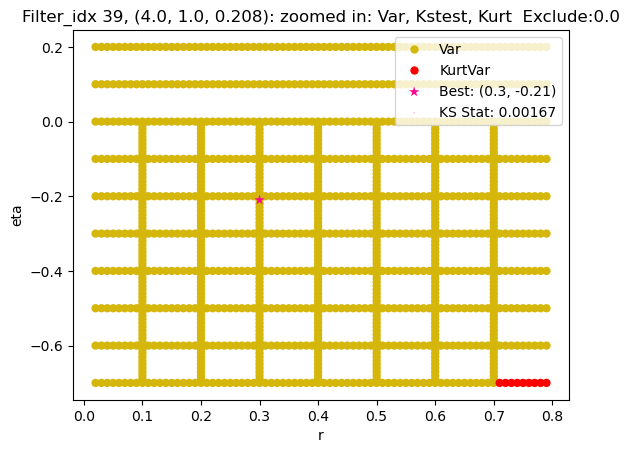

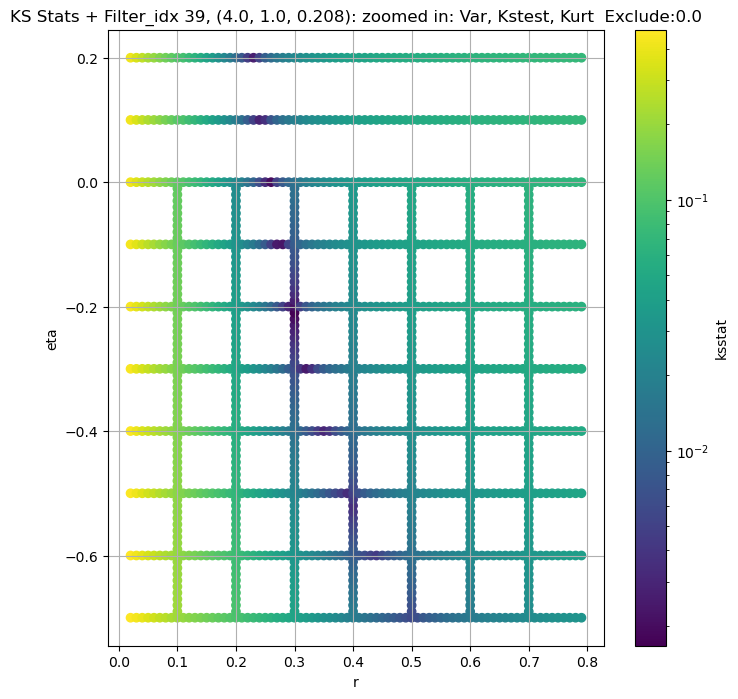

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.006895275129765399, var: 0.2787669003009796


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.006494064494122154, var: 0.284756600856781


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.006018303599066077, var: 0.2917529344558716


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.005451323657249096, var: 0.30050498247146606


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.0038002575291278262, var: 0.31723952293395996
Number of samples: 100000, Without approximation : 16384000.0


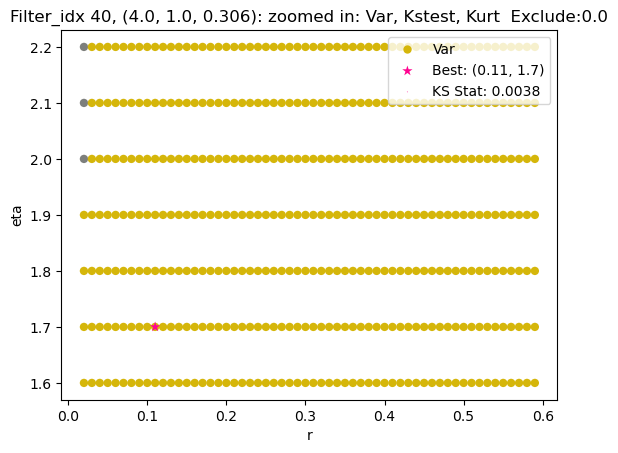

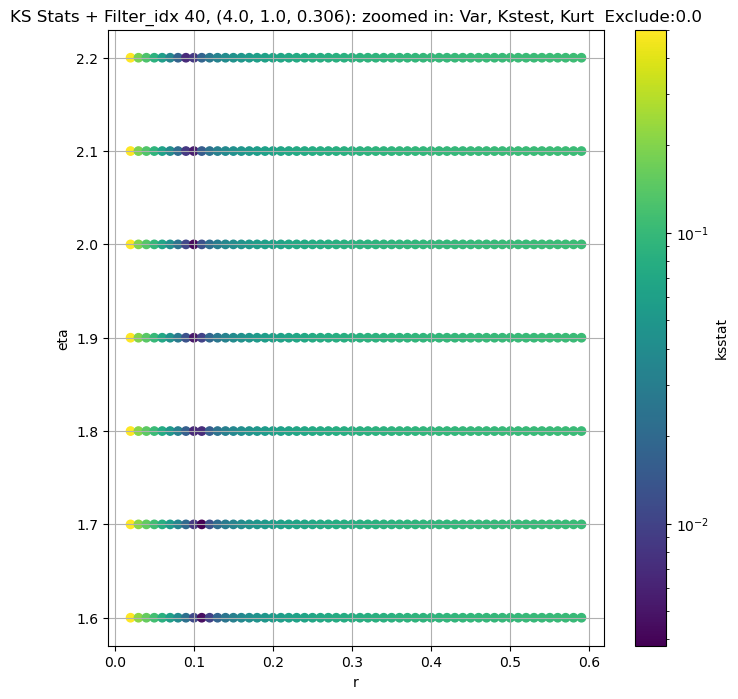

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 100 = 150, ksstat: 0.005055413071882547, var: 0.0561605729162693


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 75 = 125, ksstat: 0.004432543059886333, var: 0.057393766939640045


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 50 = 100, ksstat: 0.004040067626079745, var: 0.058769043534994125


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 25 = 75, ksstat: 0.0037189279320141155, var: 0.06033807620406151


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 0 = 50, ksstat: 0.003956462019440998, var: 0.062201377004384995


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -25 = 25, ksstat: 0.004434228466921264, var: 0.0646415576338768


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -50 = 0, ksstat: 0.006108165011844746, var: 0.07066633552312851
Number of samples: 100000, Without approximation : 16384000.0


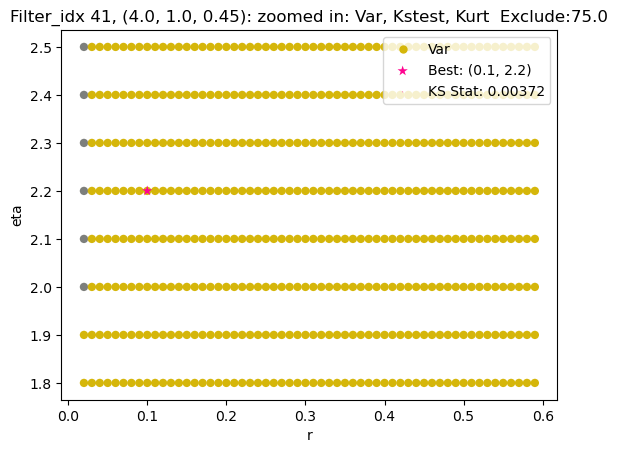

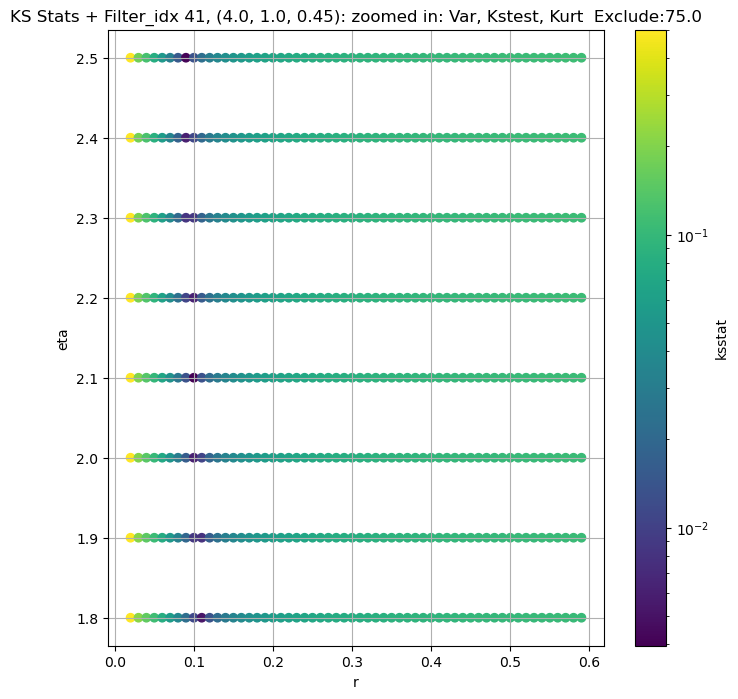

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",47.675446,38.538307,58.149254,4.035529,1.708707,11.881980,16384000.0,"(2.0, 0.5, 0.044)",0.000870,...,1.715196e-02,0.0,47.675446,0.000336,0.000792,0.27,1.80,3.074108e-03,0.0,3072000
1,"(2.0, 0.5, 0.065)",19.243467,15.368475,24.224464,4.591545,1.823889,14.051207,16384000.0,"(2.0, 0.5, 0.065)",0.001012,...,1.603622e+00,0.0,19.243467,0.000336,0.000285,0.41,0.30,3.672244e-01,0.0,23328000
2,"(2.0, 0.5, 0.096)",7.278729,5.873062,9.066898,5.347929,2.069188,19.490412,16384000.0,"(2.0, 0.5, 0.096)",0.001132,...,2.060203e+00,0.0,7.278729,0.000336,0.000459,0.50,-0.22,7.986667e-01,0.0,9216000
3,"(2.0, 0.5, 0.141)",2.810154,2.207047,3.760558,6.991034,2.539103,32.836670,16384000.0,"(2.0, 0.5, 0.141)",0.002012,...,9.092912e-02,0.0,2.810153,0.000336,0.001348,0.50,-0.44,4.248539e-01,0.0,1024000
4,"(2.0, 0.5, 0.208)",0.983050,0.753830,1.322739,9.225349,3.406891,56.309600,16384000.0,"(2.0, 0.5, 0.208)",0.002816,...,4.490271e-02,0.0,0.983050,0.000336,0.002082,0.40,-0.42,4.661115e-02,0.0,432000
5,"(2.0, 0.5, 0.306)",0.280907,0.209500,0.384200,13.071856,3.556167,79.350945,16384000.0,"(2.0, 0.5, 0.306)",0.003762,...,1.243441e-03,0.0,0.280907,0.000336,0.002774,0.28,-0.20,5.130239e-04,0.0,243000
6,"(2.0, 0.5, 0.45)",0.153547,0.113396,0.241269,16.764734,3.949549,131.470110,16384000.0,"(2.0, 0.5, 0.45)",0.004233,...,7.932084e-07,0.0,0.153547,0.000336,0.003325,0.22,0.20,5.757604e-06,0.0,162000
7,"(2.0, 1.0, 0.044)",63.055270,52.467660,76.867676,3.971615,1.687826,11.152740,16384000.0,"(2.0, 1.0, 0.044)",0.000444,...,5.893438e-06,0.0,63.055270,0.000336,0.000444,0.20,3.20,5.893438e-06,0.0,9216000
8,"(2.0, 1.0, 0.065)",26.441060,21.522533,33.041473,4.424464,1.901211,13.735676,16384000.0,"(2.0, 1.0, 0.065)",0.000472,...,1.317125e-02,0.0,26.441060,0.000336,0.000472,0.30,1.10,1.317125e-02,0.0,8192000


In [18]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

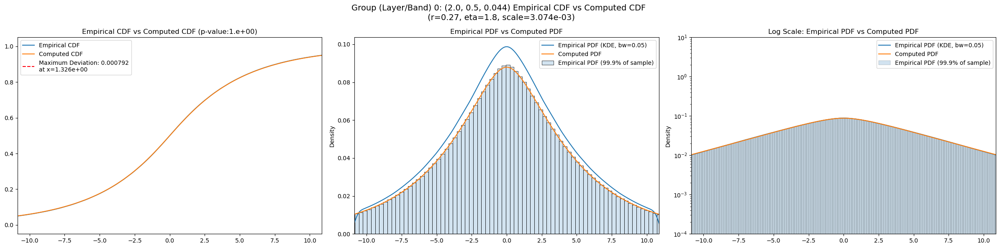

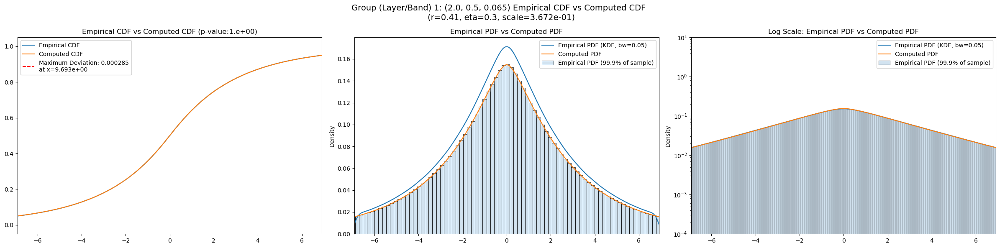

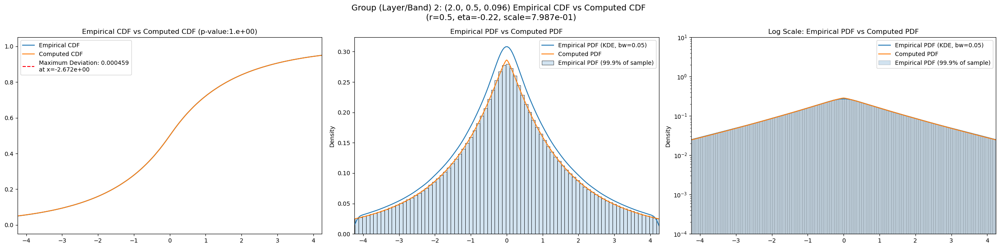

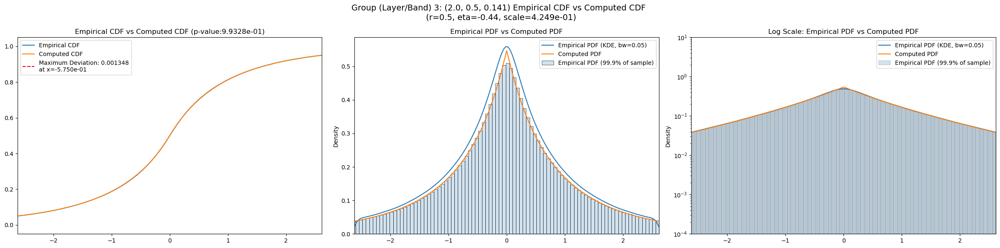

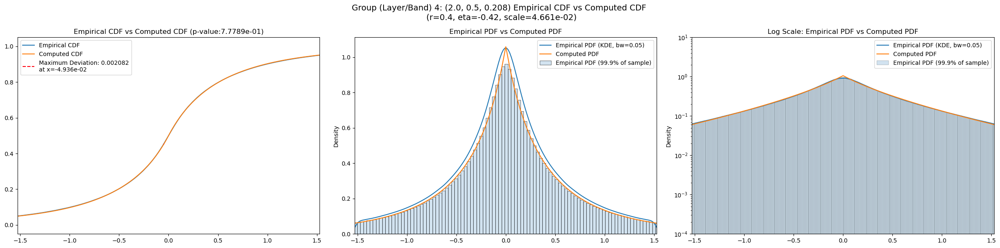

...

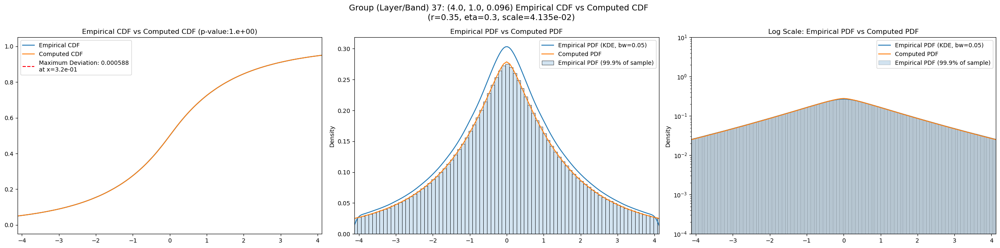

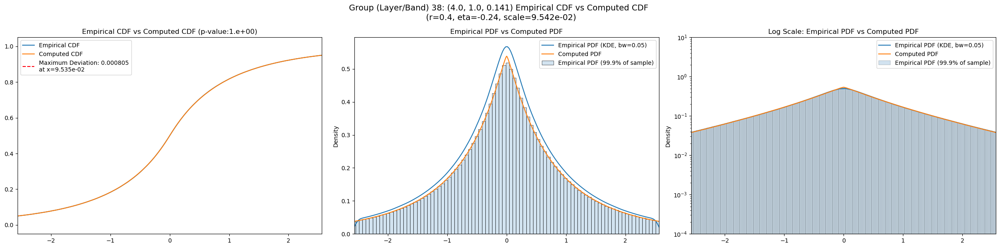

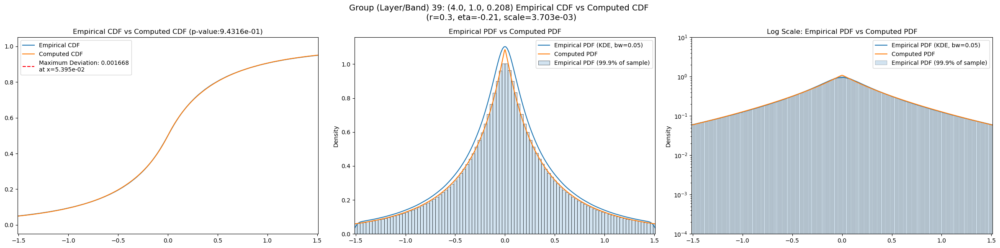

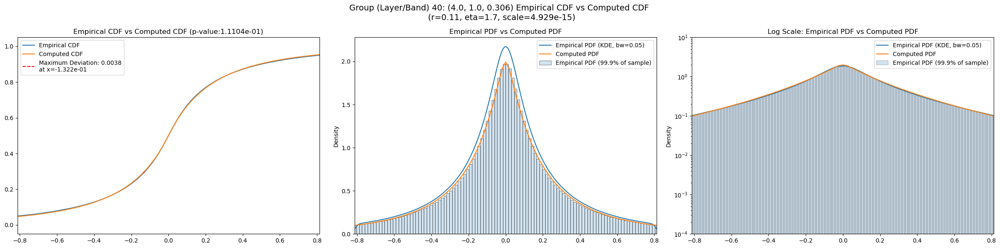

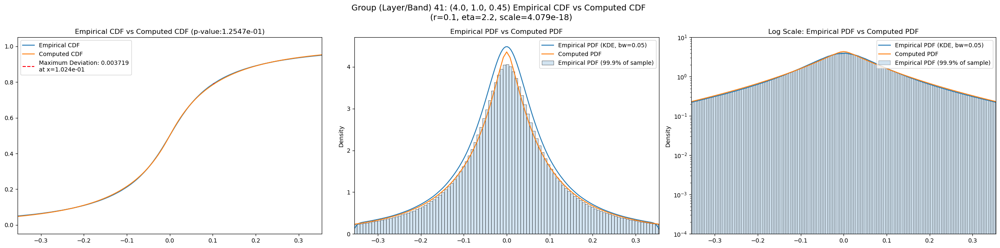

In [19]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [20]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [21]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",47.675446,38.538307,58.149254,4.035529,1.708707,11.881980,16384000.0,"(2.0, 0.5, 0.044)",0.000870,...,5.585720,0.024698,0.0,4.888600,0.005822,0.000000e+00,3.957560,0.009538,0.0,2.307595e-09
1,"(2.0, 0.5, 0.065)",19.243467,15.368475,24.224464,4.591545,1.823889,14.051207,16384000.0,"(2.0, 0.5, 0.065)",0.001012,...,3.415750,0.028977,0.0,2.981610,0.002731,1.481480e-106,2.442580,0.008112,0.0,1.403629e-01
2,"(2.0, 0.5, 0.096)",7.278729,5.873062,9.066898,5.347929,2.069188,19.490412,16384000.0,"(2.0, 0.5, 0.096)",0.001132,...,2.018140,0.033170,0.0,1.768450,0.005343,0.000000e+00,1.452290,0.009343,0.0,2.010889e-03
3,"(2.0, 0.5, 0.141)",2.810154,2.207047,3.760558,6.991034,2.539103,32.836670,16384000.0,"(2.0, 0.5, 0.141)",0.002012,...,1.179990,0.038716,0.0,1.033140,0.010716,0.000000e+00,0.841822,0.013760,0.0,2.763945e-26
4,"(2.0, 0.5, 0.208)",0.983050,0.753830,1.322739,9.225349,3.406891,56.309600,16384000.0,"(2.0, 0.5, 0.208)",0.002816,...,0.653816,0.043734,0.0,0.572657,0.015804,0.000000e+00,0.463323,0.017831,0.0,3.896794e-62
5,"(2.0, 0.5, 0.306)",0.280907,0.209500,0.384200,13.071856,3.556167,79.350945,16384000.0,"(2.0, 0.5, 0.306)",0.003762,...,0.324606,0.047495,0.0,0.284928,0.019832,0.000000e+00,0.228979,0.020308,0.0,5.829696e-110
6,"(2.0, 0.5, 0.45)",0.153547,0.113396,0.241269,16.764734,3.949549,131.470110,16384000.0,"(2.0, 0.5, 0.45)",0.004233,...,0.239518,0.047222,0.0,0.210290,0.019599,0.000000e+00,0.169188,0.019681,0.0,9.566138e-158
7,"(2.0, 1.0, 0.044)",63.055270,52.467660,76.867676,3.971615,1.687826,11.152740,16384000.0,"(2.0, 1.0, 0.044)",0.000444,...,6.498170,0.023297,0.0,5.700730,0.007485,0.000000e+00,4.592530,0.010188,0.0,3.175035e-03
8,"(2.0, 1.0, 0.065)",26.441060,21.522533,33.041473,4.424464,1.901211,13.735676,16384000.0,"(2.0, 1.0, 0.065)",0.000472,...,4.058040,0.027215,0.0,3.549650,0.004225,1.875250e-254,2.884110,0.008343,0.0,1.354646e-03


## Results

In [22]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [23]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.000870,0.000336,0.000792,0.024698,0.005822,0.009538
1,0.001012,0.000336,0.000285,0.028977,0.002731,0.008112
2,0.001132,0.000336,0.000459,0.033170,0.005343,0.009343
3,0.002012,0.000336,0.001348,0.038716,0.010716,0.013760
4,0.002816,0.000336,0.002082,0.043734,0.015804,0.017831
5,0.003762,0.000336,0.002774,0.047495,0.019832,0.020308
6,0.004233,0.000336,0.003325,0.047222,0.019599,0.019681
7,0.000444,0.000336,0.000444,0.023297,0.007485,0.010188
8,0.000472,0.000336,0.000472,0.027215,0.004225,0.008343


In [24]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,47.675446,0.000792,0.27,1.80,3.074108e-03,0.0
1,19.243467,0.000285,0.41,0.30,3.672244e-01,0.0
2,7.278729,0.000459,0.50,-0.22,7.986667e-01,0.0
3,2.810153,0.001348,0.50,-0.44,4.248539e-01,0.0
4,0.983050,0.002082,0.40,-0.42,4.661115e-02,0.0
5,0.280907,0.002774,0.28,-0.20,5.130239e-04,0.0
6,0.153547,0.003325,0.22,0.20,5.757604e-06,0.0
7,63.055270,0.000444,0.20,3.20,5.893438e-06,0.0
8,26.441060,0.000472,0.30,1.10,1.317125e-02,0.0
